# Low dimensional logistic regression label transfer of variance decomposed Single Cell Data

## Author Notes

* The following tutorial describes a method for integrating data by label transfering based on ridge regulariased logistic regression in low-dimensional space. This approach enables us to fit a model on the annotated training/landscape/reference dataset to predict labels of a new dataset and embed these labels onto neighbourhoods in the prediction data. 

* Logistic regression can (1) be used to classify samples, (2) use different types of data (continuous and descrete measurements)and (3) also be used to assess what variables are useful for classifying samples.

#### Current progress: 
- integrating a latent variable model for neighbourhood construction using factor decomposition. 
- Integration of BIC metric
- Integration of Robustness testing
#### Testing required: 
- Robustness of runs need to be tested by permutation of dependent variables and similairty of outcome tested using MI, RAND or BIC

# Author information

### Created on: 291020; Updated: 050621;
### Author: Issac Goh
### Proof readers/Testers: Simone Webb , Mariana Quiroga Londoño, Anthony Rose

In [146]:
import sys
import subprocess

#import pkg_resources
#required = {'harmonypy','sklearn','scanpy','pandas', 'numpy', 'bbknn', 'scipy', 'matplotlib', 'seaborn' ,'scipy'}
#installed = {pkg.key for pkg in pkg_resources.working_set}
#missing = required - installed
#if missing:
#    print("Installing missing packages:" )
#    print(missing)
#    python = sys.executable
#    subprocess.check_call([python, '-m', 'pip', 'install', *missing], stdout=subprocess.DEVNULL)

%matplotlib inline
from collections import Counter
from collections import defaultdict
import scanpy as sc
import pandas as pd
import pickle as pkl
import numpy as np
from bbknn import bbknn
import scipy
import matplotlib.pyplot as plt
import re
import glob
import os
import sys
from geosketch import gs
from numpy import cov
import scipy.cluster.hierarchy as spc
import seaborn as sns; sns.set(color_codes=True)
from sklearn.linear_model import LogisticRegression
import sklearn
import harmonypy as hm
from pathlib import Path

sc.settings.verbosity = 3  # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.settings.set_figure_params(dpi=80, color_map='viridis',figsize=[10,10])

# Only block to edit in LR script

In [2]:
# Introduce variables
# Note that this script expects raw data to be in "non-batch-corrected" adata.raw.X. 

# Required: Introduce the path you'd like to save figures or data to 
save_path = "/nfs/team205/ig7/work_backups/backup_210306/projects/YS/YS_310122_notebooks/fig3_Macrophages/Process_IPSC_mac_data"

# Required: Name of first object
data1 = "_ys"
# Provide path to obj1 // landscape/training data
Object1 = "/nfs/team205/ig7/work_backups/backup_210306/projects/YS/YS_data/A4_V7_YS_integrated_data_singlets_with_raw_counts_for_MS_plotting_20211111_with_obsp.h5ad"
# Provide categorical to join between datasets
cat1 = "cell.labels"

# Required: Name of second object
data2 = "_IPSC"
# Provide path to obj2 // prediction/projection data
Object2 = "/nfs/team205/ig7/work_backups/backup_210306/projects/YS/YS_310122_notebooks/fig3_Macrophages/Process_IPSC_mac_data/OBJ_IPSC_040322.h5ad"
# Provide categorical to join between datasets
cat2 = 'CellTypeLR'

# Required: LR Model Options
penalty='elasticnet' # can be ["l1","l2","elasticnet"]
#penalty='l2'
sparcity=0.2
max_iter = 200 #Increase if experiencing max iter issues
l1_ratio = 0.5 #If using elasticnet, tis controls the ratio between l1 and l2

# Optional: Batch correction options (this is for correction of eventual combined dataset for data1 and data2)
# If you do not have a batch variable for either data1 or data2, please add a "filler" column in the relevent adata.obs
# for the purposes of batch_correction and batch args below.
# e.g., adata.obs["whatever"] = "something"; batch="whatever"
batch_correction = "Harmony" # Will accept Harmony, BBKNN or False as options
# batch = ['tissue_fetal_id','tissue'] # Will accept any batch categorical. Comma space a batch categorical for each dataset. Position 1 is for data1, position 2 is for data2
batch = ['tissue','tissue'] # Will accept any batch categorical. Comma space a batch categorical for each dataset. Position 1 is for data1, position 2 is for data2
theta = 3

# Optional: miscellaneous Options.   
subsample_train = True # Samples the training data to the smallest fraction (highly dependent on resolution of input celltype categorical). This corrects for proportional differences between celltype labels of interest in the training data. E.g., training data has 50,000 B cells, 20,000 T cells and 100 HSCs. This function will subsample all training to 100 cells per cell type. 
subsample_prop = 0.2 # Give this option a proprtion to subsample to(e.g 0.2), if NA given, will subsample to smallest population
subsample_predict = False
subsample_prop_predict = 0.2
remove_non_high_var = False

train_x = 'X' # Define the resource to train and predict on, PCA, X or UMAP (#if you wish to use gene expression, train_x = 'X')
remove_effect_of_custom_gene_list = 'NA' # "./cell_cycle_genes.csv" #remove a custom list of genes from just the variable genes to compute PCA from. Your .csv should have HGNC gene names in the first column to be read in as a vector, any column name is fine.
use_raw = True # Do you want to use adata.raw.X (recommended)

# V2 start here

In [242]:
concat = sc.read('./legacy/YS_ISPC_combined_raw_v1_070222.h5ad')

In [243]:
adata = concat[:]

In [9]:
# adata.obs['tissue_fetal_id'] = adata.obs['tissue_fetal_id'].astype(str)
# adata.obs.loc[adata.obs['tissue'].isin(['IPSC']),'tissue_fetal_id'] = 'IPSC'
# adata.obs["lr_batch"] = adata.obs['tissue_fetal_id'][:]
# keep = [
# 'AdvancedMesoderm_IPSC',
# 'EmergentMesoderm_IPSC',
#  'HemogenicEndothelium_IPSC',
#  'MP_IPSC',
#  'NeutrophilMyeloidProgenitor_IPSC',
#  'Monocytes_IPSC',
#  'Mono-DCprec_IPSC',
#  'Macrophages_IPSC',
#  'HE_ys',
#  'HSPC_1_ys',
#  'Macrophage_ys',
#  'HSPC_2_ys',
#  'MOP_ys',
#  'CMP_ys',
#  'Monocyte_ys',
#  'Microglia_ys',
#  'Promonocyte_ys',
#  'Pre_Macrophage_ys',
#  'Monocyte_Macrophage_ys',
# 'Mesothelium_ys',]
# adata = adata[adata.obs['corr_concat'].isin(keep)]

In [22]:
## temporary
adata_tmp = adata.obs[adata.obs['tissue'].isin(['YS'])]
counts = (pd.DataFrame(adata_tmp[cat1].value_counts()))
mean = np.mean(counts[cat1])
std = np.std(counts[cat1])
pvals = scipy.stats.norm.sf(counts[cat1], loc=mean, scale=std)
counts['pvals'] = pvals
cat_down = list(counts[cat1][counts['pvals']<0.05].index)
cat_down

# plt.hist(adata.obs[cat1])
# plt.xticks(rotation=90)

prop = subsample_prop_predict
data = adata.obs[:]
data[cat1] = data[cat1].astype(str)
data = data[data[cat1].isin(cat_down)]
df = data.groupby(cat1).sample(n=int(mean))

cat_rm = adata.obs[adata.obs[cat1].isin(cat_down)]
cat_rm = cat_rm[~cat_rm.index.isin(df.index)]
adata = adata[~adata.obs.index.isin(cat_rm.index)]
(pd.DataFrame(adata.obs[cat1].value_counts()))
adata.obs.loc[~adata.obs.index.isin(cat_rm.index),cat1].value_counts()

# grouped =adata.obs[adata.obs['tissue'].isin(['YS'])][adata.obs['cell.labels'].isin(['Macrophage'])].groupby('corr_concat')
# df = grouped.apply(lambda x: x.sample(frac=0.3))
# df = df.droplevel('corr_concat')
# adata = adata[~adata.obs.index.isin(df.index)]
# (pd.DataFrame(adata.obs[cat1].value_counts()))

Smooth_Muscle             4704
Endoderm                  4523
Erythroid                 3455
Macrophage                3455
MK                        2154
HSPC_1                    1884
Mesothelium               1764
Microglia                 1678
Sinusoidal_EC             1370
Fibroblast                1356
Immature_EC               1168
VWF_EC                    1079
AEC                       1049
HSPC_2                     713
Lymphoid_progenitor        632
Prolif_Sinusoidal_EC       613
MEMP                       468
Early_Erythroid            413
Monocyte                   389
Mast_cell                  278
Pre DC2                    233
LMPP                       154
Eo_Baso_Mast_precursor     150
HE                         147
Promonocyte                144
CMP                        132
NK                         131
MOP                        126
ILC_precursor              124
Eo_Basophil                 86
Prolif_AEC                  76
pDC precursor               76
Mono Mac

In [23]:
np.max(adata.X)

8.843811

In [24]:
np.min(adata.X)

0.0

In [25]:
# Remove some marcophages from YS data to make it lighter
# ## temporary
# adata_tmp = adata.obs[adata.obs['tissue'].isin(['YS'])]
# counts = (pd.DataFrame(adata_tmp[cat1].value_counts()))
# mean = np.mean(counts[cat1])
# std = np.std(counts[cat1])
# pvals = scipy.stats.norm.sf(counts[cat1], loc=mean, scale=std)
# counts['pvals'] = pvals
# cat_down = list(counts[cat1][counts['pvals']<0.05].index)
# cat_down

# # plt.hist(adata.obs[cat1])
# # plt.xticks(rotation=90)

# prop = subsample_prop_predict
# data = adata.obs[:]
# data[cat1] = data[cat1].astype(str)
# data = data[data[cat1].isin(cat_down)]
# df = data.groupby(cat1).sample(n=int(mean))

# cat_rm = adata.obs[adata.obs[cat1].isin(cat_down)]
# cat_rm = cat_rm[~cat_rm.index.isin(df.index)]
# # adata = adata[~adata.obs.index.isin(cat_rm.index)]
# (pd.DataFrame(adata.obs[cat1].value_counts()))

# # plt.hist(adata.obs[cat1])
# # plt.xticks(rotation=90)

In [6]:
# grouped =adata.obs[adata.obs['tissue'].isin(['YS'])][adata.obs['cell.labels'].isin(['Macrophage'])].groupby('corr_concat')
# df = grouped.apply(lambda x: x.sample(frac=0.3))
# df = df.droplevel('corr_concat')
# adata = adata[~adata.obs.index.isin(df.index)]

<ipython-input-6-3b4036ec3c0d>:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  grouped =adata.obs[adata.obs['tissue'].isin(['YS'])][adata.obs['cell.labels'].isin(['Macrophage'])].groupby('corr_concat')


In [7]:
# sc.pp.normalize_per_cell(adata, counts_per_cell_after=1e4)
# sc.pp.log1p(adata)
# sc.pp.highly_variable_genes(adata, min_mean=0.1, max_mean=4)
#sc.pp.scale(adata, zero_center=False, max_value=None, copy=False) #zero_center=True (densifies output)

# # Optionally remove genes of known confounding effect from variable list
# if not (Path(remove_effect_of_custom_gene_list).is_file()):
#     print("Custom gene list option is not selected or path is not readbale, proceeding with no variable removal")
# else: 
#     print("Custom gene removal list detected, proceeding to remove intersect from variable genes")
#     regress_list = pd.read_csv(remove_effect_of_custom_gene_list)
#     regress_list = regress_list.iloc[:, 0]
#     adata.var["highly_variable"][adata.var.index.isin(regress_list)] = "False"


# # Now compute PCA
# sc.pp.pca(adata, n_comps=100, use_highly_variable=True, svd_solver='arpack')
# sc.pl.pca_variance_ratio(adata, log=True,n_pcs=100)

# # Batch correction options
# # The script will test later which Harmony values we should use
# if (batch_correction == "False"):
#     sc.pp.neighbors(adata, n_neighbors=30, n_pcs=100)    
# if(batch_correction == "Harmony"):
#     print("Commencing harmony")
#     batch_var = "lr_batch"
#     # Create hm subset
#     adata_hm = adata[:]
#     # Set harmony variables
#     data_mat = np.array(adata_hm.obsm["X_pca"])
#     meta_data = adata_hm.obs
#     vars_use = [batch_var]
#     # Run Harmony
#     ho = hm.run_harmony(data_mat, meta_data, vars_use,theta=theta)
#     res = (pd.DataFrame(ho.Z_corr)).T
#     res.columns = ['X{}'.format(i + 1) for i in range(res.shape[1])]
#     # Insert coordinates back into object
#     adata_hm.obsm["X_pca_back"]= adata_hm.obsm["X_pca"][:]
#     adata_hm.obsm["X_pca"] = np.array(res)
#     # Run neighbours
#     sc.pp.neighbors(adata_hm, n_neighbors=30, n_pcs=75)
#     adata = adata_hm[:]
#     del adata_hm
# elif(batch_correction == "BBKNN"):
#     print("Commencing BBKNN")
#     sc.external.pp.bbknn(adata, batch_key=batch_var, approx=True, metric='angular', copy=False, n_pcs=50, trim=None, n_trees=10, use_faiss=True, set_op_mix_ratio=1.0, local_connectivity=15) 
# print("adata1 and adata2 are now combined and preprocessed in 'adata' obj - success!")
# sc.tl.umap(adata)
# sc.tl.draw_graph(adata, layout='fa', init_pos=None, root=None, random_state=0, n_jobs=None, adjacency=None, key_added_ext=None, neighbors_key=None, obsp=None, copy=False)

In [9]:
list(adata.obs['corr_concat'].unique())

NameError: name 'adata' is not defined

In [9]:
# sc.pl.umap(adata,color = 'tissue')
# sc.pl.draw_graph(adata,color = 'tissue')

In [26]:
common_cat = 'corr_concat'

In [11]:
# sc.pl.umap(adata,color = common_cat)
# sc.pl.draw_graph(adata,color = common_cat)

# Subsample traininig

In [12]:
# grouped = adata.obs[adata.obs['tissue'].isin(['YS'])].groupby('corr_concat')
# df = grouped.apply(lambda x: x.sample(frac=0.2))
# df = df.droplevel('corr_concat')
# adata = adata[adata.obs.index.isin(list(df.index) + list(adata.obs.index[adata.obs['tissue'].isin(['IPSC'])]))]

In [13]:
# adata.write('./YS_ISPC_combined_v2_mac_lin_070222.h5ad')

In [14]:
# adata = sc.read('./YS_ISPC_combined_v2_mac_lin_070222.h5ad')

In [15]:
# adata = sc.read('./YS_ISPC_combined_v1_070222.h5ad')

# Try appending time to the predictions

In [61]:
# adata.obs['corr_concat'] = adata.obs['corr_concat'].astype(str)
# adata.obs.loc[adata.obs['tissue'].isin(['IPSC']),'corr_concat'] = adata.obs.loc[adata.obs['tissue'].isin(['IPSC']),'corr_concat'].astype(str) +  adata.obs.loc[adata.obs['tissue'].isin(['IPSC']),'SampleName'].astype(str)

## Multinomial Logistic regression function to train data set and transfer labels
- multiclass case -> training algorithm uses the one-vs-rest (OvR) scheme if the ‘multi_class’ option is set to ‘ovr’, and uses the cross-entropy loss if the ‘multi_class’ option is set to ‘multinomial’.
- https://machinelearningmastery.com/cross-entropy-for-machine-learning/
- Entropy provides a measure of the average amount of information needed to represent an event drawn from a probability distribution for a random variable.
- cross-entropy can be thought to calculate the total entropy between the probability distributions.
- elastic_net_penalty = (alpha * l1_penalty) + ((1 – alpha) * l2_penalty)
- For example, an alpha of 0.5 would provide a 50 percent contribution of each penalty to the loss function. An alpha value of 0 gives all weight to the L2 penalty and a value of 1 gives all weight to the L1 penalty.
- A default value of lambda = 1.0 is used to use the fully weighted penalty; a value of 0 excludes the penalty. Very small values of lambda, such as 1e-3 or smaller, are common.
- elastic_net_loss = loss + (lambda * elastic_net_penalty)


In [27]:
# This function require compute power, will take a while 

def LR_compare(adata, train_x, train_label, subset_predict, subset_train, penalty=penalty, sparcity=sparcity, 
               col_name='predicted'):

    # adata - training+prediction adata object (combined). Pre-processed already
    # sparsity - larger sparsity, more bins, more conservative predictions, less accurate. Low sparist for clean output
                # A value of 0.2 is reasonable for L2 ridge regression
    # penalty - acts as buffer for assigning bins too harshly
    # train_x - arg refers to where you would like to derive your training reference from, i.e., GEX (X) or/elif.
                # PCA/UMAP in obsm. The two 'if' statements below handle train_x differently based on this
                # Based on train_x, the loops below compute 'train_label' (cell type values in training/landscape data) 
                # and 'predict_x'(prediction data equivalent of train_x)
    # train_label - cell type values in training/landscape data
    # subset_predict - mandatory subset of predict_x which contains metadata for expression
    # subset_train - mandatory subset of train_x which contains metadata for expression
    
    # Redefine LR parameters 'penalty' and 'sparsity' if you would like to deviate from defaults set above
    
    # Assign 'lr' as sklearn logistic regression func, with penalty and sparsity defined above
    lr = LogisticRegression(penalty = penalty, C = sparcity, max_iter =  max_iter)
    
    if (penalty == "l1"):
        lr = LogisticRegression(penalty = penalty, C = sparcity, max_iter =  max_iter, dual = True, solver = 'liblinear',multi_class = 'ovr' ) # one-vs-rest
    if (penalty == "elasticnet"):
        lr = LogisticRegression(penalty = penalty, C = sparcity, max_iter =  max_iter, dual=False,solver = 'saga',l1_ratio=l1_ratio,multi_class = 'multinomial')

    if train_x == 'X':
        # Define training parameters
        train_label = adata.obs[common_cat].values
        train_label = train_label[subset_train]
        #train_x = adata.X,
        # Define prediction parameters
        #predict_x = train_x
        #train_x = train_x[subset_train, :] # issue line! subset_train = np.array(adata.obs[common_cat].isin(group1))
                                           # group1 = (adata.obs[common_cat][adata.obs[common_cat].str.contains(Data1_group)]).unique()
                                           # Data1_group = data1 = healthy skin data , adata containing subsetting data to get metadata for expression prediction
                                           # adata.X = adata.X[np.array(adata.obs[common_cat].isin(group1)), :]
                                           # train_x = train_x[adata.obs[common_cat].isin(group1)]
        #predict_x = train_x
        #predict_x = predict_x[subset_predict]
        train_x = adata.X[adata.obs.index.isin(list(adata.obs[subset_train].index))]
        predict_x = adata.X[adata.obs.index.isin(list(adata.obs[subset_predict].index))]

    elif train_x in adata.obsm.keys():
        # Define training parameters
        train_label = adata.obs[common_cat].values
        train_label = train_label[subset_train]
        train_x = adata.obsm[train_x]
        predict_x = train_x
        train_x = train_x[subset_train, :]
        # Define prediction parameters
        predict_x = predict_x[subset_predict]
        predict_x = pd.DataFrame(predict_x)
        predict_x.index = adata.obs[subset_predict].index

    # Train predictive model using user defined partition labels (train_x ,train_label, predict_x)
    model = lr.fit(train_x, train_label)
    lr.fit(train_x, train_label)
    predict = lr.predict_proba(predict_x)

    # Create prediction table and map to adata.obs (in adata.obs["predict"] in the combined object), for the cells that
    # are in predict dataset
    predict = lr.predict(predict_x)
    predict = pd.DataFrame(predict)
    predict.index = adata.obs[subset_predict].index
    adata.obs[col_name] = adata.obs.index
    adata.obs[col_name] = adata.obs[col_name].map(predict[0])
    return model
    return lr

# Function to plot heatmap by percentage
def plot_df_heatmap(df, cmap='viridis', title=None, figsize=(7, 7), rotation=90, save=None, **kwargs):
    fig, ax = plt.subplots(figsize=figsize)
    im = ax.imshow(df, cmap=cmap, aspect='auto', **kwargs)
    if 0 < rotation < 90:
        horizontalalignment = 'right'
    else:
        horizontalalignment = 'center'
    plt.xticks(
        range(len(df.columns)),
        df.columns,
        rotation=rotation,
        horizontalalignment=horizontalalignment,
    )
    plt.yticks(range(len(df.index)), df.index)
    if title:
        fig.suptitle(title)
    #fig.colorbar(im)
    if save:
        plt.savefig(fname=save, bbox_inches='tight', pad_inches=0.1)


# Plot probability table by html
def cross_table(adata, x, y, normalise=None, highlight=False, subset=None):                                                                                                                                                                                              
    """Make a cross table comparing two categorical annotations
    """
    x_attr = adata.obs[x]
    y_attr = adata.obs[y]
    if subset is not None:
        x_attr = x_attr[subset]
        y_attr = y_attr[subset]
    crs_tbl = pd.crosstab(x_attr, y_attr)
    if normalise == 'x':
        x_sizes = x_attr.groupby(x_attr).size().values
        crs_tbl = (crs_tbl.T / x_sizes).round(2).T
    elif normalise == 'y':
        y_sizes = x_attr.groupby(y_attr).size().values
        crs_tbl = (crs_tbl / y_sizes).round(2)
    if highlight:
        return crs_tbl.style.background_gradient(cmap='viridis', axis=0)
    return crs_tbl

# Define the separator category in the column of interest, this works by partial matches and enables a-symmetric 
# comparisons
Data1_group = data1
Data2_group = data2
# Define the common .obs column between concatinated data
common_cat = "corr_concat"

# This block defines subset_predict and subset_train and also runs LR_compare function
group1 = (adata.obs[common_cat][adata.obs[common_cat].str.contains(Data1_group)]).unique()
group1 = list(group1)
group2 = (adata.obs[common_cat][adata.obs[common_cat].str.contains(Data2_group)]).unique()
group2 = list(group2)
subset_predict = np.array(adata.obs[common_cat].isin(group2))
subset_train = np.array(adata.obs[common_cat].isin(group1))
train_label = (adata.obs[common_cat][adata.obs[common_cat].isin(group1)]).values

In [28]:
def LR_compare(adata, train_x, train_label, subset_predict, subset_train, penalty=penalty, sparcity=sparcity, 
               col_name='predicted'):

    # adata - training+prediction adata object (combined). Pre-processed already
    # sparsity - larger sparsity, more bins, more conservative predictions, less accurate. Low sparist for clean output
                # A value of 0.2 is reasonable for L2 ridge regression
    # penalty - acts as buffer for assigning bins too harshly
    # train_x - arg refers to where you would like to derive your training reference from, i.e., GEX (X) or/elif.
                # PCA/UMAP in obsm. The two 'if' statements below handle train_x differently based on this
                # Based on train_x, the loops below compute 'train_label' (cell type values in training/landscape data) 
                # and 'predict_x'(prediction data equivalent of train_x)
    # train_label - cell type values in training/landscape data
    # subset_predict - mandatory subset of predict_x which contains metadata for expression
    # subset_train - mandatory subset of train_x which contains metadata for expression
    
    # Redefine LR parameters 'penalty' and 'sparsity' if you would like to deviate from defaults set above
    
    # Assign 'lr' as sklearn logistic regression func, with penalty and sparsity defined above
    lr = LogisticRegression(penalty = penalty, C = sparcity, max_iter =  max_iter)
    
    if (penalty == "l1"):
        lr = LogisticRegression(penalty = penalty, C = sparcity, max_iter =  max_iter, dual = True, solver = 'liblinear',multi_class = 'ovr' ) # one-vs-rest
    if (penalty == "elasticnet"):
        lr = LogisticRegression(penalty = penalty, C = sparcity, max_iter =  max_iter, dual=False,solver = 'saga',l1_ratio=l1_ratio,multi_class = 'multinomial')

    if train_x == 'X':
        # Define training parameters
        train_label = adata.obs[common_cat].values
        predict_label = train_label[subset_predict]
        train_label = train_label[subset_train]
        #train_x = adata.X,
        # Define prediction parameters
        #predict_x = train_x
        #train_x = train_x[subset_train, :] # issue line! subset_train = np.array(adata.obs[common_cat].isin(group1))
                                           # group1 = (adata.obs[common_cat][adata.obs[common_cat].str.contains(Data1_group)]).unique()
                                           # Data1_group = data1 = healthy skin data , adata containing subsetting data to get metadata for expression prediction
                                           # adata.X = adata.X[np.array(adata.obs[common_cat].isin(group1)), :]
                                           # train_x = train_x[adata.obs[common_cat].isin(group1)]
        #predict_x = train_x
        #predict_x = predict_x[subset_predict]
        train_x = adata.X[adata.obs.index.isin(list(adata.obs[subset_train].index))]
        predict_x = adata.X[adata.obs.index.isin(list(adata.obs[subset_predict].index))]

    elif train_x in adata.obsm.keys():
        # Define training parameters
        train_label = adata.obs[common_cat].values
        predict_label = train_label[subset_predict]
        train_label = train_label[subset_train]
        train_x = adata.obsm[train_x]
        predict_x = train_x
        train_x = train_x[subset_train, :]
        # Define prediction parameters
        predict_x = predict_x[subset_predict]
        predict_x = pd.DataFrame(predict_x)
        predict_x.index = adata.obs[subset_predict].index

    # Train predictive model using user defined partition labels (train_x ,train_label, predict_x)
    model = lr.fit(train_x, train_label)
    lr.fit(train_x, train_label)
    predict = lr.predict_proba(predict_x)

    # Create prediction table and map to adata.obs (in adata.obs["predict"] in the combined object), for the cells that
    # are in predict dataset
    predict = lr.predict(predict_x)
    predict = pd.DataFrame(predict)
    predict.index = adata.obs[subset_predict].index
    adata.obs[col_name] = adata.obs.index
    adata.obs[col_name] = adata.obs[col_name].map(predict[0])
    return lr

# Tune penalties used in the model

### Warning! This takes a very long time with big data! Suggest using a small subset of data to validate
- Use the GridsearchCV class qwith a grid of values defined
- Ignore the sign; the library makes the MAE negative for optimization purposes.

- We can see that the model assigned an alpha weight of 0.01 to the penalty and focuses exclusively on the L2 penalty.

- Rank models by Mean absolute error: The mean_absolute_error function computes mean absolute error, a risk metric corresponding to the expected value of the absolute error loss or L1-norm loss.

In [251]:
# Define the separator category in the column of interest, this works by partial matches and enables a-symmetric 
# comparisons
Data1_group = data1
Data2_group = data2
# Define the common .obs column between concatinated data
common_cat = "corr_concat"

# This block defines subset_predict and subset_train and also runs LR_compare function
group1 = (adata.obs[common_cat][adata.obs[common_cat].str.contains(Data1_group)]).unique()
group1 = list(group1)
group2 = (adata.obs[common_cat][adata.obs[common_cat].str.contains(Data2_group)]).unique()
group2 = list(group2)
subset_predict = np.array(adata.obs[common_cat].isin(group2))
subset_train = np.array(adata.obs[common_cat].isin(group1))
train_label = (adata.obs[common_cat][adata.obs[common_cat].isin(group1)]).values

In [32]:
# # Subset and create samller dataset for hyperparam tuning
# #train_x = 'X_pca'
# tune_train_x = train_x[:]
# prop = 0.2
# data = adata.obs
# grouped = data.groupby(common_cat)
# df = grouped.apply(lambda x: x.sample(frac=prop))
# df = df.droplevel(common_cat)
# keep = df.index
# adata_tuning = adata[adata.obs.index.isin(keep)]

# df = df.loc[df[common_cat].isin(group1)]
# tune_subset_train = np.array(adata_tuning.obs[common_cat].isin(group1))

# tune_train_label = df.loc[df[common_cat].isin(group1),[common_cat]].values
# tune_train_x = adata_tuning.obsm[tune_train_x]
# tune_train_x = tune_train_x[tune_subset_train, :]

# # Create a training class index
# #train_indexes = dict(zip(set(group1),set([str(x) for x in list(range(0,len(group1)))])))
# #df['train_classes'] = df[common_cat].astype(str).map(train_indexes)
# #tune_train_label = df.loc[df[common_cat].isin(group1),['train_classes']].values

In [ ]:
penalty = "elasticnet"
common_cat = 'corr_concat'
col_name='predicted'
train_x = 'X'
# adata - training+prediction adata object (combined). Pre-processed already
# sparsity - larger sparsity, more bins, more conservative predictions, less accurate. Low sparist for clean output
            # A value of 0.2 is reasonable for L2 ridge regression
# penalty - acts as buffer for assigning bins too harshly
# train_x - arg refers to where you would like to derive your training reference from, i.e., GEX (X) or/elif.
            # PCA/UMAP in obsm. The two 'if' statements below handle train_x differently based on this
            # Based on train_x, the loops below compute 'train_label' (cell type values in training/landscape data) 
            # and 'predict_x'(prediction data equivalent of train_x)
# train_label - cell type values in training/landscape data
# subset_predict - mandatory subset of predict_x which contains metadata for expression
# subset_train - mandatory subset of train_x which contains metadata for expression

# Redefine LR parameters 'penalty' and 'sparsity' if you would like to deviate from defaults set above

# Assign 'lr' as sklearn logistic regression func, with penalty and sparsity defined above
lr = LogisticRegression(penalty = penalty, C = sparcity, max_iter =  max_iter)

if (penalty == "l1"):
    lr = LogisticRegression(penalty = penalty, C = sparcity, max_iter =  max_iter, dual = True, solver = 'liblinear',multi_class = 'ovr' ) # one-vs-rest
if (penalty == "elasticnet"):
    lr = LogisticRegression(penalty = penalty, C = sparcity, max_iter =  max_iter, dual=False,solver = 'saga',l1_ratio=l1_ratio,multi_class = 'multinomial')

if train_x == 'X':
    # Define training parameters
    train_label = adata.obs[common_cat].values
    predict_label = train_label[subset_predict]
    train_label = train_label[subset_train]
    train_x = adata.X[adata.obs.index.isin(list(adata.obs[subset_train].index))]
    predict_x = adata.X[adata.obs.index.isin(list(adata.obs[subset_predict].index))]

elif train_x in adata.obsm.keys():
    # Define training parameters
    train_label = adata.obs[common_cat].values
    predict_label = train_label[subset_predict]
    train_label = train_label[subset_train]
    train_x = adata.obsm[train_x]
    predict_x = train_x
    train_x = train_x[subset_train, :]
    # Define prediction parameters
    predict_x = predict_x[subset_predict]
    predict_x = pd.DataFrame(predict_x)
    predict_x.index = adata.obs[subset_predict].index

# Train predictive model using user defined partition labels (train_x ,train_label, predict_x)
lr.fit(train_x, train_label)
predict_proba = lr.predict_proba(predict_x)

# Create prediction table and map to adata.obs (in adata.obs["predict"] in the combined object), for the cells that
# are in predict dataset
predict = lr.predict(predict_x)
predict = pd.DataFrame(predict)
predict.index = adata.obs[subset_predict].index
adata.obs[col_name] = adata.obs.index
adata.obs[col_name] = adata.obs[col_name].map(predict[0])

In [253]:
predict = lr.predict(predict_x)
predict_proba = lr.predict_proba(predict_x)
predict

array(['HSPC_2_ys', 'HSPC_2_ys', 'HSPC_2_ys', ..., 'Macrophage_ys',
       'Mast_cell_ys', 'Macrophage_ys'], dtype=object)

In [254]:
dir(lr)
lr.intercept_
lr.coef_
lr.classes_

array(['AEC_ys', 'CMP_ys', 'Cycling DC2_ys', 'Early_Erythroid_ys',
       'Endoderm_ys', 'Eo_Baso_Mast_precursor_ys', 'Eo_Basophil_ys',
       'Erythroid_ys', 'Fibroblast_ys', 'HE_ys', 'HSPC_1_ys', 'HSPC_2_ys',
       'ILC_precursor_ys', 'Immature_EC_ys', 'LMPP_ys',
       'Lymphoid_progenitor_ys', 'MEMP_ys', 'MK_ys', 'MOP_ys',
       'Mac DC2_ys', 'Macrophage_ys', 'Mast_cell_ys', 'Mesothelium_ys',
       'Microglia_ys', 'Mono Mac DC2_ys', 'Mono Mac pre DC2_ys',
       'Monocyte_Macrophage_ys', 'Monocyte_ys', 'NK_ys',
       'Neutrophil_precursor_ys', 'Pre DC2_ys', 'Pre_Macrophage_ys',
       'Prolif_AEC_ys', 'Prolif_Sinusoidal_EC_ys', 'Promonocyte_ys',
       'Sinusoidal_EC_ys', 'Smooth_Muscle_ys', 'VWF_EC_ys',
       'pDC precursor_ys'], dtype=object)

In [255]:
lr.intercept_

array([-7.4937637e-04, -4.4892768e-05, -2.9527937e-04, -1.3985039e-03,
        2.6512811e-05, -1.3589661e-04, -3.1986809e-04,  2.5567131e-03,
        2.0617202e-04,  4.3442601e-04,  1.4228279e-03,  6.8591951e-05,
        9.1566653e-05,  1.2102382e-03, -5.3977714e-05,  1.8163089e-04,
        8.9492845e-05,  6.1470474e-04, -3.8322277e-04, -3.7722176e-04,
        1.0502901e-03,  1.0329700e-04, -2.9635356e-05, -7.8208500e-04,
       -2.6069651e-04,  1.0739775e-05, -1.2026146e-04, -1.9558547e-04,
        3.2771306e-04,  4.5846580e-04,  3.2641273e-04, -5.0736434e-04,
       -5.3963729e-04, -6.8213465e-04, -3.4123933e-04, -8.9509448e-04,
       -1.1553373e-04, -6.6131493e-04, -1.0403007e-04], dtype=float32)

In [38]:
# save the model to disk
import pickle
filename = './v4_1_ys_projected_IPSC_DC_dat_X_norm.sav'
pickle.dump(lr, open(filename, 'wb'))
# some time later...
 
# load the model from disk
# model = pickle.load(open(filename, 'rb'))
# print(result)

# Repeated k-Fold Cross-Validation for Model Evaluation
-https://machinelearningmastery.com/repeated-k-fold-cross-validation-with-python/

# Weighted F1 and precision recall
-https://towardsdatascience.com/multi-class-metrics-made-simple-part-i-precision-and-recall-9250280bddc2

In [ ]:
## Report accuracy score
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import RepeatedStratifiedKFold
from sklearn import metrics
import seaorn as sn
import pandas as pd
from sklearn.metrics import confusion_matrix
import matplotlib.pyplot as plt

model = lr

cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=5, random_state=1)
# evaluate the model and collect the scores
n_scores = cross_val_score(lr, train_x, train_label, scoring='accuracy', cv=cv, n_jobs=-1)
# report the model performance
print('Mean Accuracy: %.3f (%.3f)' % (np.mean(n_scores), np.std(n_scores)))

# Report Precision score
metric = pd.DataFrame((metrics.classification_report(train_label, model.predict(train_x), digits=3,output_dict=True))).T

cm = confusion_matrix(train_label, model.predict(train_x))
#cm = confusion_matrix(train_label, model.predict_proba(train_x))

df_cm = pd.DataFrame(cm, index = lr.classes_,
                  columns = lr.classes_)
df_cm = (df_cm / df_cm.sum(axis=0))*100
plt.figure(figsize = (20,15))
sn.set(font_scale=1) # for label size
pal = sns.diverging_palette(240, 10, n=10)
plt.suptitle(('Mean Accuracy 5 fold: %.3f std: %.3f' % (np.mean(n_scores),  np.std(n_scores))), y=1.05, fontsize=18)

#Plot precision recall and recall
table = plt.table(cellText=metric.values,colWidths = [1]*len(metric.columns),
rowLabels=metric.index,
colLabels=metric.columns,
cellLoc = 'center', rowLoc = 'center',
loc='bottom', bbox=[0.25, -0.6, 0.5, 0.3])
table.scale(1, 2)
table.set_fontsize(16)

sn.heatmap(df_cm, annot=True, annot_kws={"size": 16},cmap=pal) # font size
print(metrics.classification_report(train_label, model.predict(train_x), digits=3))

# Model predictions

In [256]:
model = lr

In [257]:
model.predict(predict_x)

array(['HSPC_2_ys', 'HSPC_2_ys', 'HSPC_2_ys', ..., 'Macrophage_ys',
       'Mast_cell_ys', 'Macrophage_ys'], dtype=object)

In [258]:
model = lr
pred_out = pd.DataFrame(model.predict(predict_x),columns = ['predicted'],index = adata.obs.index[adata.obs[common_cat].isin(group2)])
pred_out['orig_labels'] = predict_label
proba = pd.DataFrame(model.predict_proba(predict_x),columns = lr.classes_,index = adata.obs.index[adata.obs[common_cat].isin(group2)])
pred_out = pred_out.join(proba)
pred_out.to_csv('v4_pred_out.csv')
pred_out

,predicted,orig_labels,AEC_ys,CMP_ys,Cycling DC2_ys,Early_Erythroid_ys,Endoderm_ys,Eo_Baso_Mast_precursor_ys,Eo_Basophil_ys,Erythroid_ys,...,Neutrophil_precursor_ys,Pre DC2_ys,Pre_Macrophage_ys,Prolif_AEC_ys,Prolif_Sinusoidal_EC_ys,Promonocyte_ys,Sinusoidal_EC_ys,Smooth_Muscle_ys,VWF_EC_ys,pDC precursor_ys
AAACCTGAGAGTCGGT-1,HSPC_2_ys,iPSCs_IPSC,2.982346e-04,0.038416,0.001719,0.122383,6.427473e-03,0.002328,1.891673e-03,8.906226e-03,...,0.001260,0.010374,0.004749,0.006376,1.433485e-02,0.000335,2.281776e-05,3.908606e-03,5.741113e-05,8.281305e-04
AAACCTGAGGTGCACA-1,HSPC_2_ys,iPSCs_IPSC,8.511372e-05,0.016047,0.000461,0.058214,4.622670e-03,0.000508,8.333013e-04,1.988256e-03,...,0.000463,0.008985,0.001650,0.005402,8.840416e-03,0.000284,7.096234e-07,3.924896e-04,6.204155e-05,1.719799e-04
AAACCTGCAAAGGAAG-1,HSPC_2_ys,PrimitiveStreak_IPSC,1.181075e-05,0.003768,0.000065,0.003027,4.229175e-04,0.000152,9.090603e-05,6.183007e-04,...,0.000362,0.000557,0.000465,0.000279,8.821913e-04,0.000251,5.523553e-06,1.757128e-05,8.981735e-06,1.848998e-04
AAACCTGGTGTTCGAT-1,HSPC_2_ys,iPSCs_IPSC,4.805948e-04,0.030366,0.001693,0.137253,1.066666e-02,0.007678,1.185627e-03,6.191855e-03,...,0.001203,0.047373,0.003989,0.005134,1.776756e-02,0.000871,8.743918e-06,9.907902e-04,2.061752e-04,1.595827e-03
AAACGGGAGTGTACTC-1,HSPC_2_ys,iPSCs_IPSC,1.111897e-04,0.015811,0.000220,0.056986,3.413528e-03,0.000934,6.180940e-04,7.216999e-04,...,0.000282,0.004026,0.001153,0.001405,2.064295e-03,0.000377,4.790278e-07,1.446777e-04,4.853461e-05,3.271809e-04
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGGTTAGATCCGAG-19,MOP_ys,Granulocytes_IPSC,9.806038e-08,0.008258,0.000010,0.000002,1.397440e-07,0.000003,8.002948e-07,7.861175e-09,...,0.009849,0.000009,0.000003,0.000007,4.575755e-07,0.000435,4.508960e-08,3.099013e-08,1.537903e-07,1.012114e-07
TTTGGTTCAGACAAAT-19,Mast_cell_ys,MastCells_IPSC,6.605019e-04,0.000474,0.001227,0.000065,5.878355e-06,0.012434,6.646262e-03,1.516601e-07,...,0.001530,0.001014,0.000140,0.000031,3.602564e-07,0.017110,6.506682e-04,1.542157e-03,1.277295e-03,1.691214e-04
TTTGGTTTCAGAGACG-19,Macrophage_ys,cDC2_IPSC,3.185203e-04,0.009088,0.000508,0.000332,1.529716e-04,0.000785,2.927236e-04,4.194214e-05,...,0.002396,0.000109,0.011124,0.000057,1.243516e-05,0.282309,4.509062e-02,4.714126e-04,1.753600e-03,4.411390e-04
TTTGTCACAGATCCAT-19,Mast_cell_ys,MastCells_IPSC,4.014985e-05,0.000075,0.000097,0.000003,1.704457e-06,0.001107,3.597244e-03,1.273434e-07,...,0.010222,0.000032,0.000011,0.000004,1.425310e-08,0.001960,1.584597e-03,2.786641e-06,1.276619e-05,1.433290e-05


In [ ]:
proba = pd.DataFrame(model.predict_proba(predict_x),columns = lr.classes_,index = adata.obs.index[adata.obs[common_cat].isin(group2)])
#np.log(proba)
#proba.to_csv('v4_pred_out.csv')
proba

In [ ]:
pred_out = pd.DataFrame(model.predict(predict_x),columns = ['predicted'],index = adata.obs.index[adata.obs[common_cat].isin(group2)])
pred_out['orig_labels'] = predict_label
proba = pd.DataFrame(model.predict_proba(predict_x),columns = lr.classes_,index = adata.obs.index[adata.obs[common_cat].isin(group2)])
pred_out = pred_out.join(proba)
pred_out['LR_assignment'] = pred_out['predicted'].astype(str).str.replace('_ys','') + '_IPSC' 
pred_out.to_csv('v4_pred_out.csv')
pred_out

In [ ]:
model_mean_probs = pred_out.loc[:, pred_out.columns != 'predicted'].groupby('orig_labels').mean()
model_mean_probs = model_mean_probs*100
model_mean_probs = model_mean_probs.dropna(axis=0, how='any', thresh=None, subset=None, inplace=False)
crs_tbl = model_mean_probs.copy()

# New sorting method
index_order = list(crs_tbl.max(axis=1).sort_values(ascending=False).index)
col_order = list(crs_tbl.max(axis=0).sort_values(ascending=False).index)
crs_tbl = crs_tbl.loc[index_order]
crs_tbl = crs_tbl[col_order]

# Plot_df_heatmap(crs_tbl, cmap='coolwarm', rotation=90, vmin=20, vmax=70)
pal = sns.diverging_palette(240, 10, n=10)
plt.figure(figsize=(20,15))
sns.set(font_scale=0.5)
g = sns.heatmap(crs_tbl, cmap=pal,  annot=True,vmin=0, vmax=100, linewidths=1, center=50, square=True, cbar_kws={"shrink": 0.5})

plt.ylabel("Original labels")
plt.xlabel("Training labels")
plt.savefig('./v2_mac_lin_only_lr_model_means_subclusters.pdf',dpi=300)

In [268]:
pred_out

,predicted,orig_labels,AEC_ys,CMP_ys,Cycling DC2_ys,Early_Erythroid_ys,Endoderm_ys,Eo_Baso_Mast_precursor_ys,Eo_Basophil_ys,Erythroid_ys,...,Pre DC2_ys,Pre_Macrophage_ys,Prolif_AEC_ys,Prolif_Sinusoidal_EC_ys,Promonocyte_ys,Sinusoidal_EC_ys,Smooth_Muscle_ys,VWF_EC_ys,pDC precursor_ys,LR_assignment
AAACCTGAGGTGCACA-1,HSPC_2_ys,iPSCs_IPSC,8.511372e-05,0.016047,0.000461,0.058214,4.622670e-03,0.000508,8.333013e-04,1.988256e-03,...,0.008985,0.001650,0.005402,8.840416e-03,0.000284,7.096234e-07,3.924896e-04,6.204155e-05,1.719799e-04,HSPC_2_IPSC
AAACCTGCAAAGGAAG-1,HSPC_2_ys,PrimitiveStreak_IPSC,1.181075e-05,0.003768,0.000065,0.003027,4.229175e-04,0.000152,9.090603e-05,6.183007e-04,...,0.000557,0.000465,0.000279,8.821913e-04,0.000251,5.523553e-06,1.757128e-05,8.981735e-06,1.848998e-04,HSPC_2_IPSC
AAACGGGAGTGTACTC-1,HSPC_2_ys,iPSCs_IPSC,1.111897e-04,0.015811,0.000220,0.056986,3.413528e-03,0.000934,6.180940e-04,7.216999e-04,...,0.004026,0.001153,0.001405,2.064295e-03,0.000377,4.790278e-07,1.446777e-04,4.853461e-05,3.271809e-04,HSPC_2_IPSC
AAAGATGTCAATACCG-1,HSPC_2_ys,PrimitiveStreak_IPSC,4.745850e-05,0.031731,0.000707,0.101022,2.464391e-03,0.001084,5.218210e-04,1.495032e-03,...,0.008278,0.001914,0.011486,2.476145e-02,0.000710,3.201654e-06,6.921693e-05,7.213005e-05,2.710680e-04,HSPC_2_IPSC
AAAGATGTCGTCACGG-1,HSPC_2_ys,PrimitiveStreak_IPSC,5.536107e-06,0.005946,0.000443,0.018515,1.487814e-03,0.000347,5.937860e-04,9.822711e-03,...,0.006922,0.000705,0.002450,2.018341e-02,0.000187,8.593407e-08,6.925362e-06,1.059878e-05,7.775919e-05,HSPC_2_IPSC
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTACTGGTTATGCGT-19,Macrophage_ys,Macrophages_IPSC,2.209961e-05,0.000555,0.014584,0.000061,2.460308e-06,0.000193,8.421679e-05,1.263119e-06,...,0.000093,0.003478,0.000540,4.708061e-04,0.087041,1.609375e-04,4.800910e-06,3.771886e-05,1.264833e-05,Macrophage_IPSC
TTTGGTTAGATCCGAG-19,MOP_ys,Granulocytes_IPSC,9.806038e-08,0.008258,0.000010,0.000002,1.397440e-07,0.000003,8.002948e-07,7.861175e-09,...,0.000009,0.000003,0.000007,4.575755e-07,0.000435,4.508960e-08,3.099013e-08,1.537903e-07,1.012114e-07,MOP_IPSC
TTTGGTTCAGACAAAT-19,Mast_cell_ys,MastCells_IPSC,6.605019e-04,0.000474,0.001227,0.000065,5.878355e-06,0.012434,6.646262e-03,1.516601e-07,...,0.001014,0.000140,0.000031,3.602564e-07,0.017110,6.506682e-04,1.542157e-03,1.277295e-03,1.691214e-04,Mast_cell_IPSC
TTTGTCACAGATCCAT-19,Mast_cell_ys,MastCells_IPSC,4.014985e-05,0.000075,0.000097,0.000003,1.704457e-06,0.001107,3.597244e-03,1.273434e-07,...,0.000032,0.000011,0.000004,1.425310e-08,0.001960,1.584597e-03,2.786641e-06,1.276619e-05,1.433290e-05,Mast_cell_IPSC


### Assign labels by probability and slice off <0.7 probs
    - retain advanced mesdoderm

In [262]:
# Filter for only cells which have > 50% predictive quality
pred_out = pred_out[pred_out.max(axis=1)>0.6]
pred_out = pred_out[pred_out.index.isin(list(pred_out[pred_out.max(axis=1)>0.5].index) + list(pred_out[pred_out['orig_labels'].str.contains('Advanced')].index))]
# Remove all predictions under 5 counts
pred_out = pred_out[pred_out['predicted'].isin((pred_out.groupby(['predicted']).size()[~(pred_out.groupby(['predicted']).size() < 5)]).index)]

<ipython-input-262-9ecabd500736>:2: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  pred_out = pred_out[pred_out.max(axis=1)>0.6]
<ipython-input-262-9ecabd500736>:3: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  pred_out = pred_out[pred_out.index.isin(list(pred_out[pred_out.max(axis=1)>0.5].index) + list(pred_out[pred_out['orig_labels'].str.contains('Advanced')].index))]


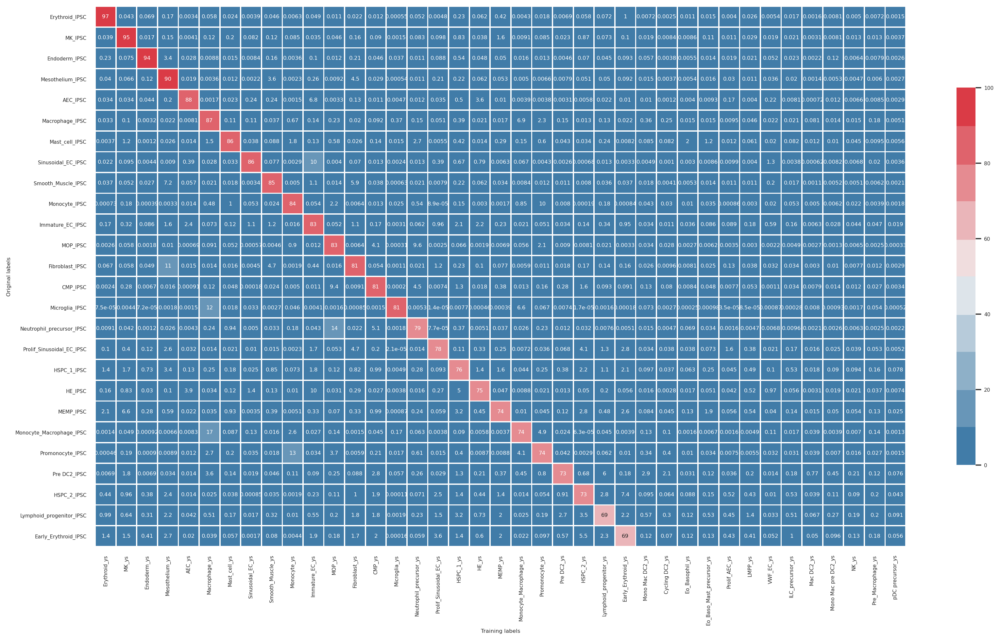

In [263]:
model_mean_probs = pred_out.loc[:, pred_out.columns != 'predicted'].groupby('LR_assignment').mean()
model_mean_probs = model_mean_probs*100
model_mean_probs = model_mean_probs.dropna(axis=0, how='any', thresh=None, subset=None, inplace=False)
crs_tbl = model_mean_probs.copy()

# New sorting method
index_order = list(crs_tbl.max(axis=1).sort_values(ascending=False).index)
col_order = list(crs_tbl.max(axis=0).sort_values(ascending=False).index)
crs_tbl = crs_tbl.loc[index_order]
crs_tbl = crs_tbl[col_order]

# Plot_df_heatmap(crs_tbl, cmap='coolwarm', rotation=90, vmin=20, vmax=70)
pal = sns.diverging_palette(240, 10, n=10)
plt.figure(figsize=(20,15))
sns.set(font_scale=0.5)
g = sns.heatmap(crs_tbl, cmap=pal,  annot=True,vmin=0, vmax=100, linewidths=1, center=50, square=True, cbar_kws={"shrink": 0.5})

plt.ylabel("Original labels")
plt.xlabel("Training labels")
plt.savefig('./v2_qc_mac_lin_only_lr_model_means_subclusters.pdf',dpi=300)

In [264]:
adata = adata[adata.obs['tissue'].isin(['IPSC'])]

In [266]:
# adata.write('./IPSC_dc_lin.h5ad')
adata = adata[adata.obs.index.isin(pred_out.index)]
adata.obs['LR_assignment'] = pred_out['LR_assignment']
adata.write('./IPSC_QC_dc_lin.h5ad')

Trying to set attribute `.obs` of view, copying.
/home/jovyan/my-conda-envs/workhorse/lib/python3.8/site-packages/anndata/_core/views.py:31: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead.  To get a de-fragmented frame, use `newframe = frame.copy()`
  container[idx] = value
/home/jovyan/my-conda-envs/workhorse/lib/python3.8/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'LR_assignment' as categorical


In [282]:
pred_out

,predicted,orig_labels,AEC_ys,CMP_ys,Cycling DC2_ys,Early_Erythroid_ys,Endoderm_ys,Eo_Baso_Mast_precursor_ys,Eo_Basophil_ys,Erythroid_ys,...,Pre DC2_ys,Pre_Macrophage_ys,Prolif_AEC_ys,Prolif_Sinusoidal_EC_ys,Promonocyte_ys,Sinusoidal_EC_ys,Smooth_Muscle_ys,VWF_EC_ys,pDC precursor_ys,LR_assignment
AAACCTGAGGTGCACA-1,HSPC_2_ys,iPSCs_IPSC,8.511372e-05,0.016047,0.000461,0.058214,4.622670e-03,0.000508,8.333013e-04,1.988256e-03,...,0.008985,0.001650,0.005402,8.840416e-03,0.000284,7.096234e-07,3.924896e-04,6.204155e-05,1.719799e-04,HSPC_2_IPSC
AAACCTGCAAAGGAAG-1,HSPC_2_ys,PrimitiveStreak_IPSC,1.181075e-05,0.003768,0.000065,0.003027,4.229175e-04,0.000152,9.090603e-05,6.183007e-04,...,0.000557,0.000465,0.000279,8.821913e-04,0.000251,5.523553e-06,1.757128e-05,8.981735e-06,1.848998e-04,HSPC_2_IPSC
AAACGGGAGTGTACTC-1,HSPC_2_ys,iPSCs_IPSC,1.111897e-04,0.015811,0.000220,0.056986,3.413528e-03,0.000934,6.180940e-04,7.216999e-04,...,0.004026,0.001153,0.001405,2.064295e-03,0.000377,4.790278e-07,1.446777e-04,4.853461e-05,3.271809e-04,HSPC_2_IPSC
AAAGATGTCAATACCG-1,HSPC_2_ys,PrimitiveStreak_IPSC,4.745850e-05,0.031731,0.000707,0.101022,2.464391e-03,0.001084,5.218210e-04,1.495032e-03,...,0.008278,0.001914,0.011486,2.476145e-02,0.000710,3.201654e-06,6.921693e-05,7.213005e-05,2.710680e-04,HSPC_2_IPSC
AAAGATGTCGTCACGG-1,HSPC_2_ys,PrimitiveStreak_IPSC,5.536107e-06,0.005946,0.000443,0.018515,1.487814e-03,0.000347,5.937860e-04,9.822711e-03,...,0.006922,0.000705,0.002450,2.018341e-02,0.000187,8.593407e-08,6.925362e-06,1.059878e-05,7.775919e-05,HSPC_2_IPSC
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTACTGGTTATGCGT-19,Macrophage_ys,Macrophages_IPSC,2.209961e-05,0.000555,0.014584,0.000061,2.460308e-06,0.000193,8.421679e-05,1.263119e-06,...,0.000093,0.003478,0.000540,4.708061e-04,0.087041,1.609375e-04,4.800910e-06,3.771886e-05,1.264833e-05,cDC2_IPSC
TTTGGTTAGATCCGAG-19,MOP_ys,Granulocytes_IPSC,9.806038e-08,0.008258,0.000010,0.000002,1.397440e-07,0.000003,8.002948e-07,7.861175e-09,...,0.000009,0.000003,0.000007,4.575755e-07,0.000435,4.508960e-08,3.099013e-08,1.537903e-07,1.012114e-07,MOP_IPSC
TTTGGTTCAGACAAAT-19,Mast_cell_ys,MastCells_IPSC,6.605019e-04,0.000474,0.001227,0.000065,5.878355e-06,0.012434,6.646262e-03,1.516601e-07,...,0.001014,0.000140,0.000031,3.602564e-07,0.017110,6.506682e-04,1.542157e-03,1.277295e-03,1.691214e-04,Mast_cell_IPSC
TTTGTCACAGATCCAT-19,Mast_cell_ys,MastCells_IPSC,4.014985e-05,0.000075,0.000097,0.000003,1.704457e-06,0.001107,3.597244e-03,1.273434e-07,...,0.000032,0.000011,0.000004,1.425310e-08,0.001960,1.584597e-03,2.786641e-06,1.276619e-05,1.433290e-05,Mast_cell_IPSC


In [284]:
adata.write('./IPSC_QC_dc_lin.h5ad')
pred_out.to_csv('./V4_pred_out_QC.csv')

/home/jovyan/my-conda-envs/workhorse/lib/python3.8/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'LR_assignment' as categorical


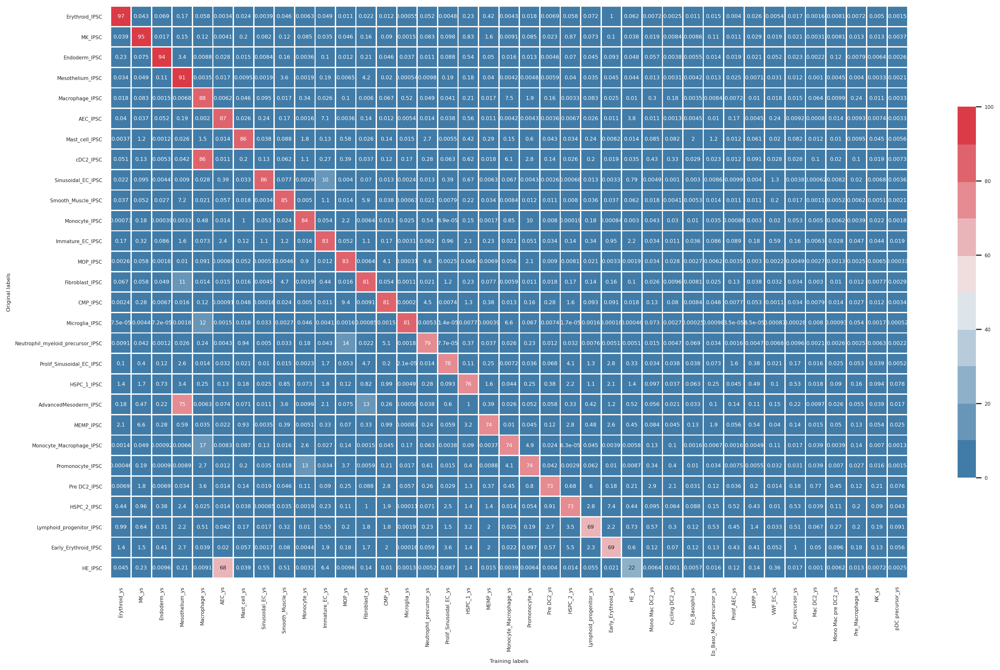

In [285]:
model_mean_probs = pred_out.loc[:, pred_out.columns != 'predicted'].groupby('LR_assignment').mean()
model_mean_probs = model_mean_probs*100
model_mean_probs = model_mean_probs.dropna(axis=0, how='any', thresh=None, subset=None, inplace=False)
crs_tbl = model_mean_probs.copy()

# New sorting method
index_order = list(crs_tbl.max(axis=1).sort_values(ascending=False).index)
col_order = list(crs_tbl.max(axis=0).sort_values(ascending=False).index)
crs_tbl = crs_tbl.loc[index_order]
crs_tbl = crs_tbl[col_order]

# Plot_df_heatmap(crs_tbl, cmap='coolwarm', rotation=90, vmin=20, vmax=70)
pal = sns.diverging_palette(240, 10, n=10)
plt.figure(figsize=(20,15))
sns.set(font_scale=0.5)
g = sns.heatmap(crs_tbl, cmap=pal,  annot=True,vmin=0, vmax=100, linewidths=1, center=50, square=True, cbar_kws={"shrink": 0.5})

plt.ylabel("Original labels")
plt.xlabel("Training labels")
plt.savefig('./v3_qc_DC_dat_lr_model_means.pdf',dpi=300)

In [12]:
pred_out = pd.read_csv('/nfs/team205/ig7/work_backups/backup_210306/projects/YS/YS_310122_notebooks/fig3_Macrophages/Process_IPSC_mac_data/IPSC_DC_lin_use_this/v4_pred_out.csv',index_col=0)

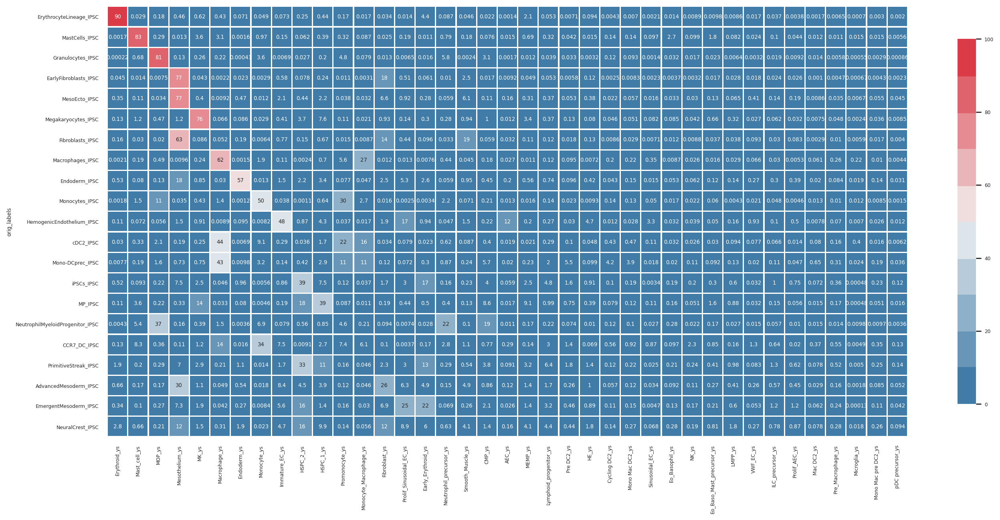

In [13]:
model_mean_probs = pred_out.loc[:, pred_out.columns != 'predicted'].groupby('orig_labels').mean()
model_mean_probs = model_mean_probs*100
model_mean_probs = model_mean_probs.dropna(axis=0, how='any', thresh=None, subset=None, inplace=False)
crs_tbl = model_mean_probs.copy()

# New sorting method
index_order = list(crs_tbl.max(axis=1).sort_values(ascending=False).index)
col_order = list(crs_tbl.max(axis=0).sort_values(ascending=False).index)
crs_tbl = crs_tbl.loc[index_order]
crs_tbl = crs_tbl[col_order]

# Plot_df_heatmap(crs_tbl, cmap='coolwarm', rotation=90, vmin=20, vmax=70)
pal = sns.diverging_palette(240, 10, n=10)
plt.figure(figsize=(20,15))
sns.set(font_scale=0.5)
g = sns.heatmap(crs_tbl, cmap=pal,  annot=True,vmin=0, vmax=100, linewidths=1, center=50, square=True, cbar_kws={"shrink": 0.5})

- move all primitive streak, IPSC, Early fibro and 

In [286]:
#adata = adata_orig[:]

In [19]:
adata_full  = sc.read('/nfs/team205/ig7/work_backups/backup_210306/projects/YS/YS_310122_notebooks/fig3_Macrophages/Process_IPSC_mac_data/IPSC_DC_lin_use_this/IPSC_dc_lin.h5ad')
pred_out_full = pd.read_csv('/nfs/team205/ig7/work_backups/backup_210306/projects/YS/YS_310122_notebooks/fig3_Macrophages/Process_IPSC_mac_data/IPSC_DC_lin_use_this/v4_pred_out.csv',index_col=0)

In [35]:
#upate pred_out
pred_out = pd.read_csv('/nfs/team205/ig7/work_backups/backup_210306/projects/YS/YS_310122_notebooks/fig3_Macrophages/Process_IPSC_mac_data/IPSC_DC_lin_use_this/IPSC_mac_lin_QC_pred_out.csv',index_col=0)
pred_out_full.loc[pred_out_full.index.isin(pred_out.index),'LR_assignment'] = pred_out['LR_assignment']

computing score 'key_score'


Trying to set attribute `.obs` of view, copying.


    finished: added
    'key_score', score of gene set (adata.obs).
    50 total control genes are used. (0:00:00)


/home/jovyan/my-conda-envs/workhorse/lib/python3.8/site-packages/anndata/_core/views.py:31: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead.  To get a de-fragmented frame, use `newframe = frame.copy()`
  container[idx] = value
<ipython-input-193-efe5c1df6cbf>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead.  To get a de-fragmented frame, use `newframe = frame.copy()`
  adata_temp.obs['LR_assignment_HE'] =adata_temp.obs['CellTypeLR'].astype(str)
/home/jovyan/my-conda-envs/workhorse/lib/python3.8/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in

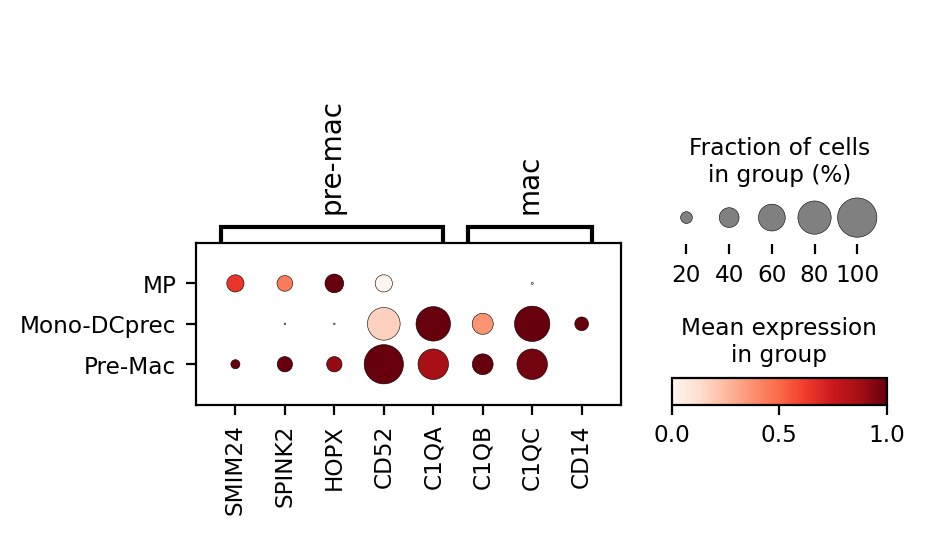

LR_assignment_HE
MP             51
Mono-DCprec    69
Pre-Mac         7
dtype: int64

In [193]:
adata_temp = adata_full[adata_full.obs['CellTypeLR'].isin(["Mono-DCprec","Macrophages","MP"])]#"PrimitiveStreak","cDC2"
adata_temp = adata_temp[adata_temp.obs["SampleName"].isin(['Day16DC','Day18DC','Day21DC'])]
sc.tl.score_genes(adata_temp, ['SMIM24','SPINK2','HOPX','CD52','CD34'] , ctrl_size=10, gene_pool=None, n_bins=25, score_name=('key' + '_score'), random_state=0, copy=False, use_raw=None)
pd.set_option('display.max_rows', 100)
keep = adata_temp.obs[adata_temp.obs['key_score']>1].index

adata_temp.obs['LR_assignment_HE'] =adata_temp.obs['CellTypeLR'].astype(str)
adata_temp.obs.loc[adata_temp.obs.index.isin(keep),'LR_assignment_HE'] = 'Pre-Mac'

markers = { 
'pre-mac':['SMIM24','SPINK2','HOPX','CD52','C1QA'],
'mac':['C1QB','C1QC','CD14'],
   }
plt.rcdefaults()
(sc.pl.dotplot(adata_temp, var_names = markers, groupby='LR_assignment_HE',dendrogram=False,standard_scale='var', color_map='Reds', show = True)) # title=i

adata_temp.obs.groupby('LR_assignment_HE').apply(len)

In [194]:
adata_temp.obs['LR_assignment_HE']

ACAGCTAGTACCGTTA-11             MP
CCTTTCTTCCTTGGTC-11    Mono-DCprec
GGTGTTATCGAGAGCA-11    Mono-DCprec
TCATTTGGTTTAGCTG-11    Mono-DCprec
TGTCCCACATGGAATA-11    Mono-DCprec
                          ...     
TGCCCTACATTCACTT-12             MP
TGTTCCGCAACGATGG-12    Mono-DCprec
TTCGAAGAGGCAATTA-12    Mono-DCprec
TTCGGTCAGGTGCAAC-12    Mono-DCprec
TTTGGTTAGTCCATAC-12    Mono-DCprec
Name: LR_assignment_HE, Length: 127, dtype: category
Categories (3, object): ['MP', 'Mono-DCprec', 'Pre-Mac']

In [195]:
pred_out_full

,predicted,orig_labels,AEC_ys,CMP_ys,Cycling DC2_ys,Early_Erythroid_ys,Endoderm_ys,Eo_Baso_Mast_precursor_ys,Eo_Basophil_ys,Erythroid_ys,...,Pre_Macrophage_ys,Prolif_AEC_ys,Prolif_Sinusoidal_EC_ys,Promonocyte_ys,Sinusoidal_EC_ys,Smooth_Muscle_ys,VWF_EC_ys,pDC precursor_ys,LR_assignment,LR_assignment_v2
AAACCTGAGAGTCGGT-1,HSPC_2_ys,iPSCs_IPSC,2.982346e-04,0.038416,0.001719,0.122383,6.427473e-03,0.002328,1.891673e-03,8.906226e-03,...,0.004749,0.006376,1.433485e-02,0.000335,2.281776e-05,3.908606e-03,5.741113e-05,8.281305e-04,HSPC_2_IPSC,iPSCs
AAACCTGAGGTGCACA-1,HSPC_2_ys,iPSCs_IPSC,8.511372e-05,0.016047,0.000461,0.058214,4.622670e-03,0.000508,8.333013e-04,1.988256e-03,...,0.001650,0.005402,8.840416e-03,0.000284,7.096234e-07,3.924896e-04,6.204155e-05,1.719799e-04,HSPC_2_IPSC,iPSCs
AAACCTGCAAAGGAAG-1,HSPC_2_ys,PrimitiveStreak_IPSC,1.181075e-05,0.003768,0.000065,0.003027,4.229175e-04,0.000152,9.090603e-05,6.183008e-04,...,0.000465,0.000279,8.821913e-04,0.000251,5.523553e-06,1.757129e-05,8.981735e-06,1.848998e-04,HSPC_2_IPSC,PrimitiveStreak
AAACCTGGTGTTCGAT-1,HSPC_2_ys,iPSCs_IPSC,4.805948e-04,0.030366,0.001693,0.137253,1.066666e-02,0.007678,1.185627e-03,6.191855e-03,...,0.003989,0.005134,1.776756e-02,0.000871,8.743918e-06,9.907902e-04,2.061752e-04,1.595827e-03,HSPC_2_IPSC,iPSCs
AAACGGGAGTGTACTC-1,HSPC_2_ys,iPSCs_IPSC,1.111897e-04,0.015811,0.000220,0.056986,3.413528e-03,0.000934,6.180940e-04,7.216999e-04,...,0.001153,0.001405,2.064295e-03,0.000377,4.790278e-07,1.446777e-04,4.853461e-05,3.271809e-04,HSPC_2_IPSC,iPSCs
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGGTTAGATCCGAG-19,MOP_ys,Granulocytes_IPSC,9.806038e-08,0.008258,0.000010,0.000002,1.397440e-07,0.000003,8.002948e-07,7.861175e-09,...,0.000003,0.000007,4.575755e-07,0.000435,4.508960e-08,3.099013e-08,1.537903e-07,1.012114e-07,MOP_IPSC,MOP_IPSC
TTTGGTTCAGACAAAT-19,Mast_cell_ys,MastCells_IPSC,6.605019e-04,0.000474,0.001227,0.000065,5.878355e-06,0.012434,6.646262e-03,1.516601e-07,...,0.000140,0.000031,3.602564e-07,0.017110,6.506682e-04,1.542157e-03,1.277295e-03,1.691214e-04,Mast_cell_IPSC,Mast_cell_IPSC
TTTGGTTTCAGAGACG-19,Macrophage_ys,cDC2_IPSC,3.185203e-04,0.009088,0.000508,0.000332,1.529716e-04,0.000785,2.927236e-04,4.194214e-05,...,0.011124,0.000057,1.243516e-05,0.282309,4.509062e-02,4.714126e-04,1.753600e-03,4.411389e-04,Macrophage_IPSC,Macrophage_IPSC
TTTGTCACAGATCCAT-19,Mast_cell_ys,MastCells_IPSC,4.014985e-05,0.000075,0.000097,0.000003,1.704456e-06,0.001107,3.597244e-03,1.273434e-07,...,0.000011,0.000004,1.425310e-08,0.001960,1.584597e-03,2.786641e-06,1.276619e-05,1.433290e-05,Mast_cell_IPSC,Mast_cell_IPSC


In [197]:
# assign pre-MAc
# adata.obs['LR_assignment'] = adata.obs['LR_assignment_v2'].astype(str)
# adata.obs.loc[adata.obs.index.isin(keep),'LR_assignment_v2'] = 'Pre_Macrophage_IPSC'
pred_out_full.loc[pred_out_full.index.isin(keep),'LR_assignment_v2'] = 'Pre_Macrophage_IPSC'

In [198]:
pred_out_full.to_csv('./V6_Full_pred_outs_IPSC_data_050422.csv')

/home/jovyan/my-conda-envs/workhorse/lib/python3.8/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'LR_assignment' as categorical


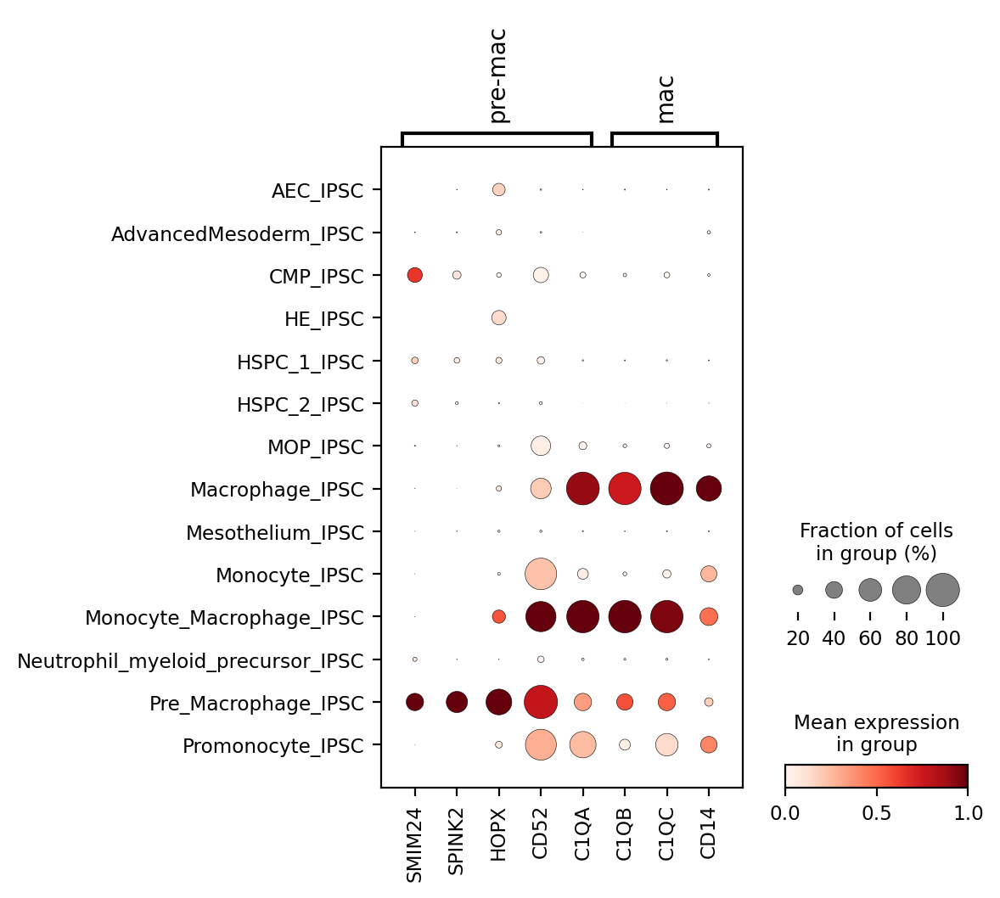

In [60]:
sc.pl.dotplot(adata,var_names =markers ,groupby='LR_assignment',standard_scale = 'var')

# Add all pre-macs back into adata mac lin


In [61]:
adata_full.obs['LR_assignment'] = pred_out_full['LR_assignment']
adata_full.obs['LR_assignment'].unique()

array(['HSPC_2_IPSC', 'Early_Erythroid_IPSC', 'HSPC_1_IPSC',
       'Erythroid_IPSC', 'Lymphoid_progenitor_IPSC', 'MK_IPSC',
       'Mesothelium_IPSC', 'MEMP_IPSC', 'Macrophage_IPSC',
       'Immature_EC_IPSC', 'LMPP_IPSC', 'Prolif_Sinusoidal_EC_IPSC',
       'Fibroblast_IPSC', 'CMP_IPSC', 'Pre DC2_IPSC',
       'Eo_Baso_Mast_precursor_IPSC', 'HE_IPSC', 'Smooth_Muscle_IPSC',
       'Neutrophil_precursor_IPSC', 'Endoderm_IPSC',
       'AdvancedMesoderm_IPSC', 'AEC_IPSC', 'Prolif_AEC_IPSC', 'MOP_IPSC',
       'Monocyte_Macrophage_IPSC', 'Microglia_IPSC', 'VWF_EC_IPSC',
       'Neutrophil_myeloid_precursor_IPSC', 'Promonocyte_IPSC',
       'Monocyte_IPSC', 'Mast_cell_IPSC', 'Cycling DC2_IPSC',
       'ILC_precursor_IPSC', 'pDC precursor_IPSC',
       'Mono Mac pre DC2_IPSC', 'Sinusoidal_EC_IPSC', 'Mono Mac DC2_IPSC',
       'Pre_Macrophage_IPSC', 'Eo_Basophil_IPSC'], dtype=object)

# Assign all EB cells back to CellType LR

In [ ]:
'iPSCs','PrimitiveStreak','NeuralCrest','EmergentMesoderm'

In [94]:
adata_full.obs.loc[adata_full.obs['CellTypeLR'].isin(['iPSCs','PrimitiveStreak','NeuralCrest','EmergentMesoderm']),'LR_assignment'] = adata_full.obs.loc[adata_full.obs['CellTypeLR'].isin(['iPSCs','PrimitiveStreak','NeuralCrest','EmergentMesoderm']),'CellTypeLR']

In [99]:
pred_out_full['LR_assignment_v2'] = adata_full.obs['LR_assignment']

In [100]:
pred_out_full.to_csv('./V5_pred_out.csv')

In [101]:
pred_out = pred_out_full[:]
pred_out =  pred_out[pred_out.index.isin(list(pred_out[pred_out.max(axis=1)>0.6].index) + list(pred_out[pred_out['orig_labels'].str.contains('Advanced')].index) + list(pred_out[pred_out['LR_assignment'].str.contains('Pre_Macrophage_IPSC')].index))]
# Remove all predictions under 5 counts
pred_out = pred_out[pred_out['LR_assignment'].isin((pred_out.groupby(['LR_assignment']).size()[~(pred_out.groupby(['LR_assignment']).size() < 5)]).index)]

<ipython-input-101-cc8ab41cff07>:2: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  pred_out =  pred_out[pred_out.index.isin(list(pred_out[pred_out.max(axis=1)>0.6].index) + list(pred_out[pred_out['orig_labels'].str.contains('Advanced')].index) + list(pred_out[pred_out['LR_assignment'].str.contains('Pre_Macrophage_IPSC')].index))]


In [103]:
pred_out.to_csv('./V5_pred_out_QC.csv')

In [ ]:
pd.set_option('display.max_rows', 533)
adata_full.obs.groupby(['SampleName','LR_assignment']).apply(len)

In [106]:
adata_full.write('IPSC_V5_pred_out.h5ad')

/home/jovyan/my-conda-envs/workhorse/lib/python3.8/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'LR_assignment' as categorical


# Slice to Mac lineage

In [108]:
list(adata_full.obs['LR_assignment'].unique())

['iPSCs',
 'PrimitiveStreak',
 'NeuralCrest',
 'Early_Erythroid_IPSC',
 'Macrophage_IPSC',
 'HSPC_2_IPSC',
 'EmergentMesoderm',
 'Lymphoid_progenitor_IPSC',
 'Immature_EC_IPSC',
 'Mesothelium_IPSC',
 'MEMP_IPSC',
 'MK_IPSC',
 'Fibroblast_IPSC',
 'HSPC_1_IPSC',
 'Endoderm_IPSC',
 'AdvancedMesoderm_IPSC',
 'Smooth_Muscle_IPSC',
 'Prolif_Sinusoidal_EC_IPSC',
 'HE_IPSC',
 'Erythroid_IPSC',
 'AEC_IPSC',
 'Prolif_AEC_IPSC',
 'LMPP_IPSC',
 'MOP_IPSC',
 'Monocyte_Macrophage_IPSC',
 'Microglia_IPSC',
 'VWF_EC_IPSC',
 'Neutrophil_myeloid_precursor_IPSC',
 'Promonocyte_IPSC',
 'Monocyte_IPSC',
 'Neutrophil_precursor_IPSC',
 'Mast_cell_IPSC',
 'CMP_IPSC',
 'Eo_Baso_Mast_precursor_IPSC',
 'Cycling DC2_IPSC',
 'Pre DC2_IPSC',
 'Mono Mac pre DC2_IPSC',
 'Sinusoidal_EC_IPSC',
 'Mono Mac DC2_IPSC',
 'Pre_Macrophage_IPSC',
 'Eo_Basophil_IPSC']

In [134]:
keep =  [
'iPSCs',
 'PrimitiveStreak',
 'NeuralCrest',
 'Macrophage_IPSC',
 'HSPC_2_IPSC',
 'EmergentMesoderm',
 'Fibroblast_IPSC',
 'HSPC_1_IPSC',
 'AdvancedMesoderm_IPSC',
 'HE_IPSC',
 'AEC_IPSC',
 'MOP_IPSC',
 'Monocyte_Macrophage_IPSC',
 'Neutrophil_myeloid_precursor_IPSC',
 'Promonocyte_IPSC',
 'Monocyte_IPSC',
 'CMP_IPSC',
 'Pre_Macrophage_IPSC',]
pred_out_filtered = pred_out[pred_out['LR_assignment_v2'].isin(keep)]

In [135]:
pred_out_filtered['LR_assignment_v2'].unique()

array(['iPSCs', 'PrimitiveStreak', 'Macrophage_IPSC', 'NeuralCrest',
       'HSPC_2_IPSC', 'EmergentMesoderm', 'Fibroblast_IPSC',
       'HSPC_1_IPSC', 'AdvancedMesoderm_IPSC', 'HE_IPSC', 'AEC_IPSC',
       'Monocyte_Macrophage_IPSC', 'Neutrophil_myeloid_precursor_IPSC',
       'Monocyte_IPSC', 'Promonocyte_IPSC', 'MOP_IPSC', 'CMP_IPSC',
       'Pre_Macrophage_IPSC'], dtype=object)

In [136]:
# adata_mac_lin = adata_full[adata_full.obs['LR_assignment'].isin(keep)]

In [137]:
pred_out_filtered.to_csv('V5_mac_lin_pred_out_QC.csv')

In [147]:
pred_out_filtered = pd.read_csv('V5_mac_lin_pred_out_QC.csv',index_col=0)

In [138]:
adata_mac_lin = adata_full[adata_full.obs.index.isin(pred_out_filtered.index)]

In [139]:
adata_mac_lin.write('./V5_IPSC_mac_lin_QC.h5ad')
pred_out_filtered.to_csv('V5_mac_lin_pred_out_QC.csv')

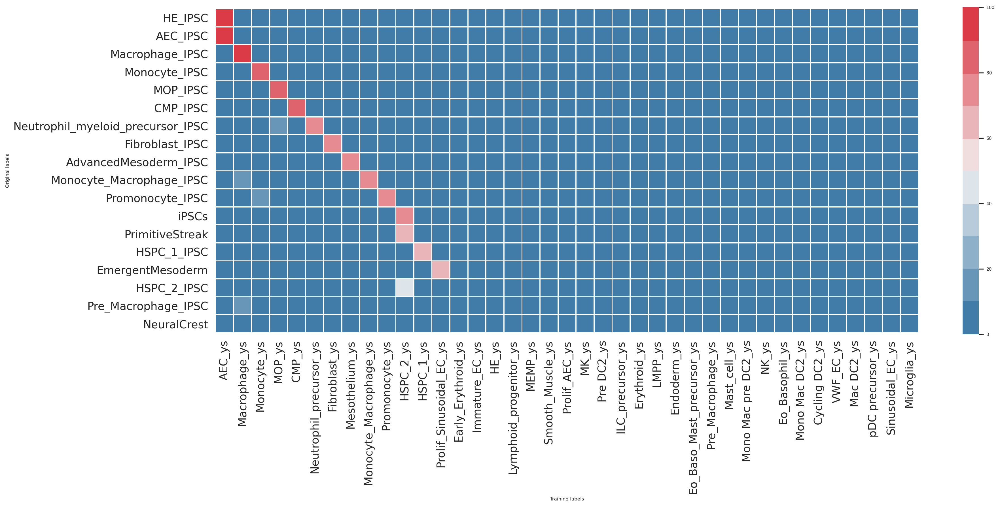

In [140]:
model_mean_probs = pred_out_filtered.loc[:, pred_out_filtered.columns != 'predicted'].groupby('LR_assignment_v2').median()
model_mean_probs = model_mean_probs*100
model_mean_probs = model_mean_probs.dropna(axis=0, how='any', thresh=None, subset=None, inplace=False)
crs_tbl = model_mean_probs.copy()


# New sorting method
index_order = list(crs_tbl.max(axis=1).sort_values(ascending=False).index)
col_order = list(crs_tbl.max(axis=0).sort_values(ascending=False).index)
crs_tbl = crs_tbl.loc[index_order]
crs_tbl = crs_tbl[col_order]


crs_tbl = crs_tbl.loc[index_order]
crs_tbl = crs_tbl[col_order]


# Plot_df_heatmap(crs_tbl, cmap='coolwarm', rotation=90, vmin=20, vmax=70)
pal = sns.diverging_palette(240, 10, n=10)
plt.figure(figsize=(20,15))
sns.set(font_scale=0.5)
g = sns.heatmap(crs_tbl, cmap=pal,  annot=False,vmin=0, vmax=100, linewidths=1, center=50, square=True, cbar_kws={"shrink": 0.5})
plt.xticks(rotation=90,fontsize=14) 
plt.yticks(rotation=0,fontsize=14)
plt.ylabel("Original labels")
plt.xlabel("Training labels")
plt.savefig('./v5_1_mac_lin_DC_dat_QC_only_lr_model_median.pdf',dpi=300)

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:03:15)


/home/jovyan/my-conda-envs/workhorse/lib/python3.8/site-packages/scanpy/tools/_rank_genes_groups.py:417: RuntimeWarning: overflow encountered in expm1
  foldchanges = (self.expm1_func(mean_group) + 1e-9) / (
/home/jovyan/my-conda-envs/workhorse/lib/python3.8/site-packages/scanpy/tools/_rank_genes_groups.py:394: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead.  To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'names'] = self.var_names[global_indices]
/home/jovyan/my-conda-envs/workhorse/lib/python3.8/site-packages/scanpy/tools/_rank_genes_groups.py:396: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead.  To get a de-fragmen

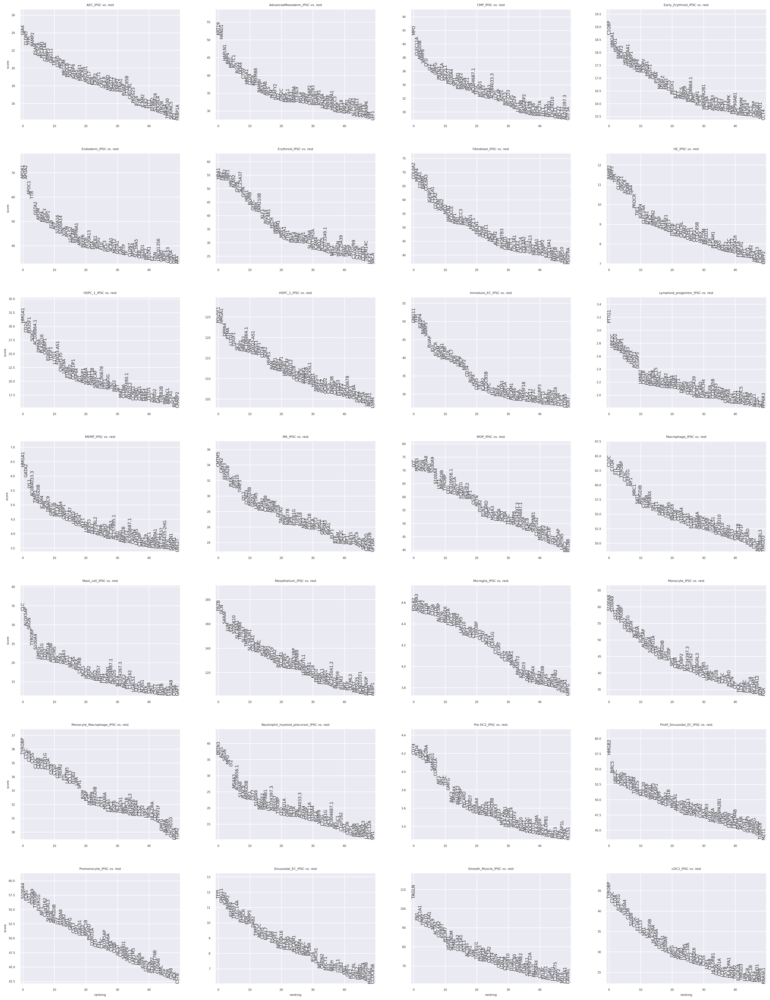

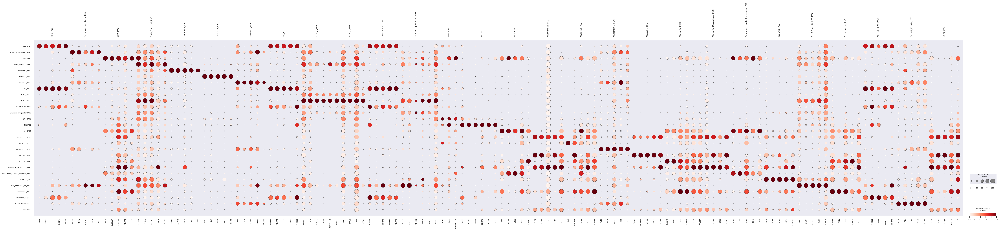

In [296]:
spot_var = 'LR_assignment'
sc.tl.rank_genes_groups(adata, spot_var, method='wilcoxon',n_genes=500)
sc.pl.rank_genes_groups(adata, n_genes=50, sharey=False)
result = adata.uns['rank_genes_groups']
groups = result['names'].dtype.names
    
DE = pd.DataFrame(
    {group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names', 'pvals','logfoldchanges']}).head(500)
DE_name ="./DEGS_DC_data_all_labels_QC.csv"
DE.to_csv(DE_name)
degs = DE[:]
if 'concat' in locals() or 'concat' in globals():
    del(concat)
n = degs.loc[:, degs.columns.str.endswith("_n")]
n = pd.melt(n)
p = degs.loc[:, degs.columns.str.endswith("_p")]
p = pd.melt(p)
l = degs.loc[:, degs.columns.str.endswith("_l")]
l = pd.melt(l)
n = n.replace(regex=r'_n', value='')
n = n.rename(columns={"variable": "cluster", "value": "gene"})
p = (p.drop(["variable"],axis = 1)).rename(columns={ "value": "p_val"})
l = (l.drop(["variable"],axis = 1)).rename(columns={ "value": "logfc"})
concat = pd.concat([n,p,l],axis=1)
#remove mito genes from data
concat = concat[~concat["gene"].str.startswith("MT-")]
concat = concat[~concat["gene"].str.startswith("RP11-")]
concat["cluster"] = concat["cluster"].astype(str)
marker_df = concat.groupby('cluster').apply(lambda grp: grp.nsmallest(5, 'p_val')).reset_index(drop=True)
markers = marker_df.groupby('cluster')['gene'].apply(list).to_dict()
markers = dict(sorted(markers.items()))
markers = {str(k):v for k,v in markers.items()}
data_temp = adata
markers = markers
(sc.pl.dotplot(data_temp, var_names = markers, groupby=spot_var,dendrogram=False,standard_scale='var', color_map='Reds', show = True, save = 'diff_expression_gastrula.pdf')) # title=i

In [145]:
adata

AnnData object with n_obs × n_vars = 50512 × 33538
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'DEMline', 'DBL_final', 'RAWdf', 'SampleName', 'CellTypeP', 'SOClineRAW', 'SOCline', 'DBLdetect', 'DBLscrub', 'DBLdemux', 'DBLsoc', 'DBL_nFINAL', 'percent.mt', 'S.Score', 'G2M.Score', 'Phase', 'CC.Difference', 'nCount_SCT', 'nFeature_SCT', 'integrated_snn_res.0.5', 'integrated_snn_res.0.8', 'integrated_snn_res.1', 'integrated_snn_res.3', 'integrated_snn_res.6', 'integrated_snn_res.10', 'seurat_clusters', 'GAS_LRda1All_AUCauc09977len18forAGGd', 'GAS_LRda2All_AUCauc1len9forAGGd', 'GAS_LRda3All_AUCauc1len5forAGGd', 'GAS_LRda4All_AUCauc09967len30forAGGd', 'GAS_LRda5All_AUCauc1len15forAGGd', 'GAS_LRda6All_AUCauc09869len31forAGGd', 'GAS_LRda7All_AUCauc1len11forAGGd', 'GAS_LRda8All_AUCauc09989len102forAGGd', 'GAS_LRda9All_AUCauc09944len18forAGGd', 'GAS_LRda10All_AUCauc09602len12forAGGd', 'GAS_LRda11All_AUCauc09971len59forAGGd', 'FLIni_LRsctda107sub_AUCauclen88forAGGd', 'FLIni_LRsctda207sub_

In [297]:
adata_orig = adata[:]
adata = adata_mac_lin[:]

ranking genes


Trying to set attribute `.uns` of view, copying.


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:01:45)


/home/jovyan/my-conda-envs/workhorse/lib/python3.8/site-packages/scanpy/tools/_rank_genes_groups.py:417: RuntimeWarning: overflow encountered in expm1
  foldchanges = (self.expm1_func(mean_group) + 1e-9) / (


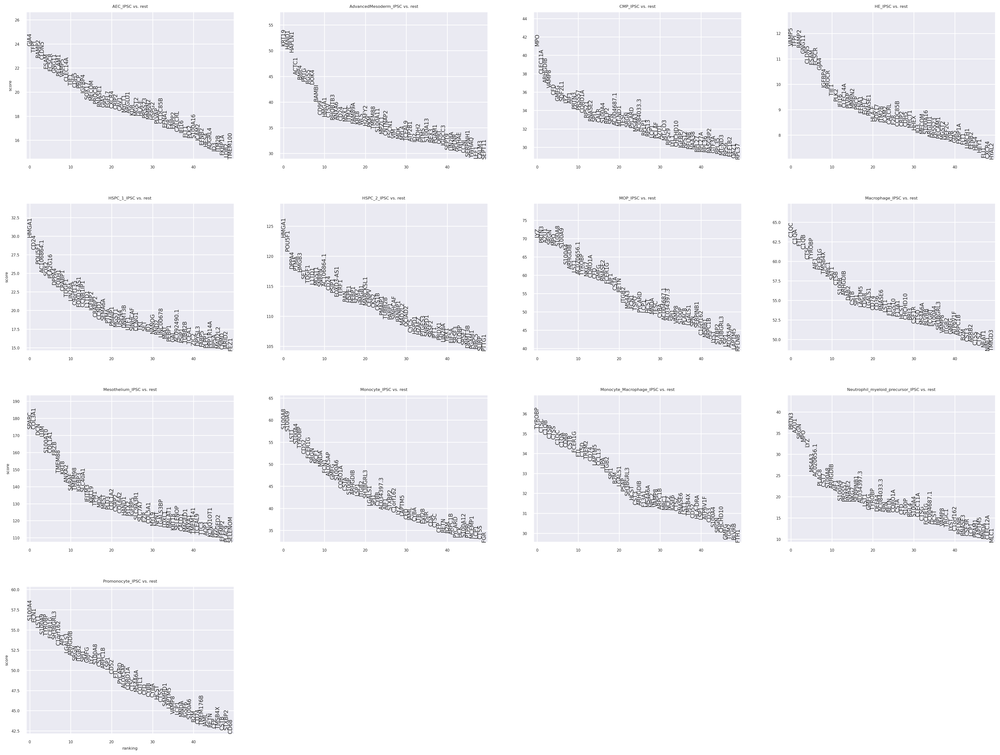

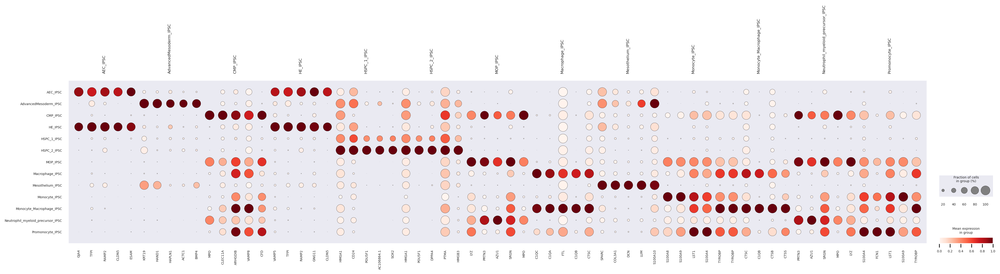

In [298]:
spot_var = 'LR_assignment'
sc.tl.rank_genes_groups(adata, spot_var, method='wilcoxon',n_genes=500)
sc.pl.rank_genes_groups(adata, n_genes=50, sharey=False)
result = adata.uns['rank_genes_groups']
groups = result['names'].dtype.names
    
DE = pd.DataFrame(
    {group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names', 'pvals','logfoldchanges']}).head(500)
DE_name ="./DEGS_DC_data_Mac_lin_labels_QC.csv"
DE.to_csv(DE_name)
degs = DE[:]
if 'concat' in locals() or 'concat' in globals():
    del(concat)
n = degs.loc[:, degs.columns.str.endswith("_n")]
n = pd.melt(n)
p = degs.loc[:, degs.columns.str.endswith("_p")]
p = pd.melt(p)
l = degs.loc[:, degs.columns.str.endswith("_l")]
l = pd.melt(l)
n = n.replace(regex=r'_n', value='')
n = n.rename(columns={"variable": "cluster", "value": "gene"})
p = (p.drop(["variable"],axis = 1)).rename(columns={ "value": "p_val"})
l = (l.drop(["variable"],axis = 1)).rename(columns={ "value": "logfc"})
concat = pd.concat([n,p,l],axis=1)
#remove mito genes from data
concat = concat[~concat["gene"].str.startswith("MT-")]
concat = concat[~concat["gene"].str.startswith("RP11-")]
concat["cluster"] = concat["cluster"].astype(str)
marker_df = concat.groupby('cluster').apply(lambda grp: grp.nsmallest(5, 'p_val')).reset_index(drop=True)
markers = marker_df.groupby('cluster')['gene'].apply(list).to_dict()
markers = dict(sorted(markers.items()))
markers = {str(k):v for k,v in markers.items()}
data_temp = adata
markers = markers
(sc.pl.dotplot(data_temp, var_names = markers, groupby=spot_var,dendrogram=False,standard_scale='var', color_map='Reds', show = True, save = 'diff_expression_Mac_lin_only_dc_dat.pdf')) # title=i

In [141]:
markers = {'AEC_IPSC': ['GJA4', 'TFPI', 'RAMP2', 'CLDN5', 'ESAM'],
 'AdvancedMesoderm_IPSC': ['KRT19', 'HAND1', 'HAPLN1', 'ACTC1', 'BMP4'],
 'CMP_IPSC': ['MPO', 'CLEC11A', 'ARHGDIB', 'VAMP8', 'CFD'],
 'HE_IPSC': ['VAMP5', 'TFPI', 'RAMP2', 'GNG11', 'CLDN5'],
 'HSPC_1_IPSC': ['CD34','SPINK2','HOPX', 'CD24','AC106864.1', 'SOX2'],
 'HSPC_2_IPSC': ['HMGA1', 'POU5F1', 'DPPA4', 'PTMA', 'HMGB3'],
 'MOP_IPSC': ['LYZ', 'AZU1', 'PRTN3', 'SRGN', 'MPO'],
 'Macrophage_IPSC': ['C1QC', 'C1QA', 'FTL', 'C1QB', 'TYROBP'],
 'Mesothelium_IPSC': ['SPARC', 'COL3A1', 'DCN', 'LUM', 'COL1A1'],
 'Monocyte_IPSC': ['S100A8', 'S100A9', 'CD14','LST1', 'S100A4', 'TYROBP'],
 'Promonocyte_IPSC': ['S100A4', 'FCN1', 'LST1', 'TYROBP', 'FCER1G']} 

In [143]:
(sc.pl.dotplot(adata, var_names = markers, groupby=spot_var,dendrogram=False,standard_scale='var', color_map='Reds', show = True, save = 'diff_expression_Mac_lin_only_dc_dat.pdf')) # title=i

NameError: name 'spot_var' is not defined

In [175]:
adata.obs[]

,orig.ident,nCount_RNA,nFeature_RNA,DEMline,DBL_final,RAWdf,SampleName,CellTypeP,SOClineRAW,SOCline,...,component,broad_cell.labels,sequencing.type,orig.dataset,broad_cell_labels_organ,V6_old_indexes,tissue_fetal_id,batch,predicted,LR_assignment
AAACCTGAGGTGCACA-1,AGGd,13255,3474,SNG-vass_1,SNG,OLD,Day00iPSC,iPSCs,1,SNG-vass_1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,HSPC_2_ys,HSPC_2_IPSC
AAACCTGCAAAGGAAG-1,AGGd,5920,2201,SNG-vass_1,SNG,OLD,Day00iPSC,PrimitiveStreak,1,SNG-vass_1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,HSPC_2_ys,HSPC_2_IPSC
AAACGGGAGTGTACTC-1,AGGd,14357,3562,SNG-vass_1,SNG,OLD,Day00iPSC,iPSCs,1,SNG-vass_1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,HSPC_2_ys,HSPC_2_IPSC
AAAGATGTCAATACCG-1,AGGd,13349,3449,SNG-vass_1,SNG,OLD,Day00iPSC,PrimitiveStreak,1,SNG-vass_1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,HSPC_2_ys,HSPC_2_IPSC
AAAGATGTCGTCACGG-1,AGGd,7691,2185,SNG-vass_1,SNG,OLD,Day00iPSC,unresponsive,1,SNG-vass_1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,HSPC_2_ys,HSPC_2_IPSC
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTCTCCTTCAACGCTA-19,AGGd,1692,923,NaN,NaN,NEW,Day31plus7DCpre,NaN,0,SNG-kolf_2,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,Monocyte_ys,Monocyte_IPSC
TTCTCCTTCCAAGTAC-19,AGGd,6097,2095,SNG-kolf_2,SNG,OLD,Day31plus7DCpre,Macrophages,0,SNG-kolf_2,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,Macrophage_ys,Macrophage_IPSC
TTGCGTCAGCTGCCCA-19,AGGd,12382,3074,SNG-kolf_2,SNG,OLD,Day31plus7DCpre,cDC2,0,SNG-kolf_2,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,Monocyte_Macrophage_ys,Monocyte_Macrophage_IPSC
TTGTAGGCATGCTGGC-19,AGGd,2348,1153,NaN,NaN,NEW,Day31plus7DCpre,NaN,0,SNG-kolf_2,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,Monocyte_Macrophage_ys,Monocyte_Macrophage_IPSC


In [182]:
mac_lin_adata = sc.read('/nfs/team205/ig7/work_backups/backup_210306/projects/YS/YS_310122_notebooks/fig3_Macrophages/Process_IPSC_mac_data/IPSC_DC_lin_use_this/v6_IPSC_mac_lin.h5ad')

In [185]:
pred = pd.read_csv('/nfs/team205/ig7/work_backups/backup_210306/projects/YS/YS_310122_notebooks/fig3_Macrophages/Process_IPSC_mac_data/IPSC_DC_lin_use_this/V5_mac_lin_pred_out_QC.csv')

In [186]:
pred

,Unnamed: 0,predicted,orig_labels,AEC_ys,CMP_ys,Cycling DC2_ys,Early_Erythroid_ys,Endoderm_ys,Eo_Baso_Mast_precursor_ys,Eo_Basophil_ys,...,Pre_Macrophage_ys,Prolif_AEC_ys,Prolif_Sinusoidal_EC_ys,Promonocyte_ys,Sinusoidal_EC_ys,Smooth_Muscle_ys,VWF_EC_ys,pDC precursor_ys,LR_assignment,LR_assignment_v2
0,AAACCTGAGGTGCACA-1,HSPC_2_ys,iPSCs_IPSC,8.511372e-05,0.016047,0.000461,5.821438e-02,4.622670e-03,0.000508,8.333013e-04,...,0.001650,0.005402,8.840416e-03,0.000284,7.096234e-07,3.924896e-04,6.204155e-05,1.719799e-04,HSPC_2_IPSC,iPSCs
1,AAACCTGCAAAGGAAG-1,HSPC_2_ys,PrimitiveStreak_IPSC,1.181075e-05,0.003768,0.000065,3.026520e-03,4.229175e-04,0.000152,9.090603e-05,...,0.000465,0.000279,8.821913e-04,0.000251,5.523553e-06,1.757129e-05,8.981735e-06,1.848998e-04,HSPC_2_IPSC,PrimitiveStreak
2,AAACGGGAGTGTACTC-1,HSPC_2_ys,iPSCs_IPSC,1.111897e-04,0.015811,0.000220,5.698572e-02,3.413528e-03,0.000934,6.180940e-04,...,0.001153,0.001405,2.064295e-03,0.000377,4.790278e-07,1.446777e-04,4.853461e-05,3.271809e-04,HSPC_2_IPSC,iPSCs
3,AAAGATGTCAATACCG-1,HSPC_2_ys,PrimitiveStreak_IPSC,4.745850e-05,0.031731,0.000707,1.010216e-01,2.464391e-03,0.001084,5.218210e-04,...,0.001914,0.011486,2.476145e-02,0.000710,3.201654e-06,6.921693e-05,7.213005e-05,2.710679e-04,HSPC_2_IPSC,PrimitiveStreak
4,AAAGATGTCGTCACGG-1,HSPC_2_ys,PrimitiveStreak_IPSC,5.536106e-06,0.005946,0.000443,1.851539e-02,1.487814e-03,0.000347,5.937860e-04,...,0.000705,0.002450,2.018341e-02,0.000187,8.593407e-08,6.925362e-06,1.059878e-05,7.775919e-05,HSPC_2_IPSC,PrimitiveStreak
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
27552,TTGGAACCACCGGAAA-19,Macrophage_ys,cDC2_IPSC,5.365873e-06,0.023041,0.000038,3.141646e-05,1.799046e-05,0.000008,1.120021e-04,...,0.000330,0.000040,6.412776e-06,0.004588,9.120608e-06,5.833519e-07,1.079194e-05,5.619132e-05,Macrophage_IPSC,Macrophage_IPSC
27553,TTGTAGGCATGCTGGC-19,Monocyte_Macrophage_ys,cDC2_IPSC,7.167863e-06,0.000089,0.000957,3.820059e-07,4.481782e-07,0.000049,1.314624e-05,...,0.000217,0.000035,9.298196e-06,0.011799,4.395910e-05,3.320602e-07,3.908092e-05,4.811651e-06,Monocyte_Macrophage_IPSC,Monocyte_Macrophage_IPSC
27554,TTTACTGGTTATGCGT-19,Macrophage_ys,Macrophages_IPSC,2.209961e-05,0.000555,0.014584,6.103492e-05,2.460308e-06,0.000193,8.421679e-05,...,0.003478,0.000540,4.708061e-04,0.087041,1.609375e-04,4.800910e-06,3.771885e-05,1.264833e-05,Macrophage_IPSC,Macrophage_IPSC
27555,TTTGGTTAGATCCGAG-19,MOP_ys,Granulocytes_IPSC,9.806038e-08,0.008258,0.000010,2.129687e-06,1.397440e-07,0.000003,8.002948e-07,...,0.000003,0.000007,4.575755e-07,0.000435,4.508960e-08,3.099013e-08,1.537903e-07,1.012114e-07,MOP_IPSC,MOP_IPSC


In [209]:
v5_pred_out = pd.read_csv('/nfs/team205/ig7/work_backups/backup_210306/projects/YS/YS_310122_notebooks/fig3_Macrophages/Process_IPSC_mac_data/IPSC_DC_lin_use_this/V5_mac_lin_pred_out_QC.csv',index_col= 0)
v5_pred_out

,predicted,orig_labels,AEC_ys,CMP_ys,Cycling DC2_ys,Early_Erythroid_ys,Endoderm_ys,Eo_Baso_Mast_precursor_ys,Eo_Basophil_ys,Erythroid_ys,...,Pre_Macrophage_ys,Prolif_AEC_ys,Prolif_Sinusoidal_EC_ys,Promonocyte_ys,Sinusoidal_EC_ys,Smooth_Muscle_ys,VWF_EC_ys,pDC precursor_ys,LR_assignment,LR_assignment_v2
AAACCTGAGGTGCACA-1,HSPC_2_ys,iPSCs_IPSC,8.511372e-05,0.016047,0.000461,5.821438e-02,4.622670e-03,0.000508,8.333013e-04,1.988256e-03,...,0.001650,0.005402,8.840416e-03,0.000284,7.096234e-07,3.924896e-04,6.204155e-05,1.719799e-04,HSPC_2_IPSC,iPSCs
AAACCTGCAAAGGAAG-1,HSPC_2_ys,PrimitiveStreak_IPSC,1.181075e-05,0.003768,0.000065,3.026520e-03,4.229175e-04,0.000152,9.090603e-05,6.183008e-04,...,0.000465,0.000279,8.821913e-04,0.000251,5.523553e-06,1.757129e-05,8.981735e-06,1.848998e-04,HSPC_2_IPSC,PrimitiveStreak
AAACGGGAGTGTACTC-1,HSPC_2_ys,iPSCs_IPSC,1.111897e-04,0.015811,0.000220,5.698572e-02,3.413528e-03,0.000934,6.180940e-04,7.216999e-04,...,0.001153,0.001405,2.064295e-03,0.000377,4.790278e-07,1.446777e-04,4.853461e-05,3.271809e-04,HSPC_2_IPSC,iPSCs
AAAGATGTCAATACCG-1,HSPC_2_ys,PrimitiveStreak_IPSC,4.745850e-05,0.031731,0.000707,1.010216e-01,2.464391e-03,0.001084,5.218210e-04,1.495032e-03,...,0.001914,0.011486,2.476145e-02,0.000710,3.201654e-06,6.921693e-05,7.213005e-05,2.710679e-04,HSPC_2_IPSC,PrimitiveStreak
AAAGATGTCGTCACGG-1,HSPC_2_ys,PrimitiveStreak_IPSC,5.536106e-06,0.005946,0.000443,1.851539e-02,1.487814e-03,0.000347,5.937860e-04,9.822711e-03,...,0.000705,0.002450,2.018341e-02,0.000187,8.593407e-08,6.925362e-06,1.059878e-05,7.775919e-05,HSPC_2_IPSC,PrimitiveStreak
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTGGAACCACCGGAAA-19,Macrophage_ys,cDC2_IPSC,5.365873e-06,0.023041,0.000038,3.141646e-05,1.799046e-05,0.000008,1.120021e-04,2.727118e-04,...,0.000330,0.000040,6.412776e-06,0.004588,9.120608e-06,5.833519e-07,1.079194e-05,5.619132e-05,Macrophage_IPSC,Macrophage_IPSC
TTGTAGGCATGCTGGC-19,Monocyte_Macrophage_ys,cDC2_IPSC,7.167863e-06,0.000089,0.000957,3.820059e-07,4.481782e-07,0.000049,1.314624e-05,3.033837e-06,...,0.000217,0.000035,9.298196e-06,0.011799,4.395910e-05,3.320602e-07,3.908092e-05,4.811651e-06,Monocyte_Macrophage_IPSC,Monocyte_Macrophage_IPSC
TTTACTGGTTATGCGT-19,Macrophage_ys,Macrophages_IPSC,2.209961e-05,0.000555,0.014584,6.103492e-05,2.460308e-06,0.000193,8.421679e-05,1.263119e-06,...,0.003478,0.000540,4.708061e-04,0.087041,1.609375e-04,4.800910e-06,3.771885e-05,1.264833e-05,Macrophage_IPSC,Macrophage_IPSC
TTTGGTTAGATCCGAG-19,MOP_ys,Granulocytes_IPSC,9.806038e-08,0.008258,0.000010,2.129687e-06,1.397440e-07,0.000003,8.002948e-07,7.861175e-09,...,0.000003,0.000007,4.575755e-07,0.000435,4.508960e-08,3.099013e-08,1.537903e-07,1.012114e-07,MOP_IPSC,MOP_IPSC


In [215]:
v5_pred_out.loc[v5_pred_out.index.isin(pred_out_full[pred_out_full['LR_assignment_v2'].isin(['Pre_Macrophage_IPSC'])].index),'LR_assignment_v2'] = 'Pre_Macrophage_IPSC'

In [ ]:
v5_pred_out.to_csv('/nfs/team205/ig7/work_backups/backup_210306/projects/YS/YS_310122_notebooks/fig3_Macrophages/Process_IPSC_mac_data/IPSC_DC_lin_use_this/V6_mac_lin_pred_out_QC.csv')

In [214]:
pred_out_full[pred_out_full['LR_assignment_v2'].isin(['Pre_Macrophage_IPSC'])].index

Index(['TTTGCGCAGTATCGAA-12', 'AGAGCGACACTATCTT-14', 'CTTAACTTCGAGAGCA-14',
       'ACAGCCGAGGCAATTA-18', 'GACTACATCCGTAGTA-18', 'CAACCAAGTGAGGCTA-19',
       'CACATTTGTTGTTTGG-19', 'CGGAGTCTCTAACTGG-19', 'CGGCTAGCAGCATACT-19',
       'CTACGTCTCAGGTAAA-19', 'CTCTAATTCTTGTCAT-19', 'GTACTCCGTAATAGCA-19',
       'GTCACGGAGTGTCCCG-19', 'TATCAGGCACATGACT-19', 'TGCTACCCAAGGTTCT-19',
       'TTAACTCTCTAGAGTC-19', 'CATGGCGAGGCCCTTG-10', 'AGTCTTTCAATGTAAG-11',
       'CCAATCCCATTCTTAC-11', 'CTCGTACCATACAGCT-11', 'GTATTCTGTTGTTTGG-11',
       'TTAGGCATCAACGGCC-11', 'ATCTGCCAGATATGCA-13', 'ATCATCTAGGTAGCCA-15',
       'CACATAGCATGGTTGT-15', 'CCTTACGAGTGCAAGC-15', 'CGTCCATCACAAGTAA-15',
       'GGCTCGATCACAACGT-15', 'TTTGTCAGTAGCCTCG-15', 'AACTCCCGTCGCGAAA-16',
       'ACGCAGCAGGCTAGAC-16', 'CAGCAGCCAAACTGTC-16', 'CCCATACGTTTGGGCC-16',
       'CCGGGATTCCAAGTAC-16', 'CCGTTCATCCCACTTG-16', 'CCTCTGATCGACAGCC-16',
       'CGCTTCAGTCTGATTG-16', 'CGGACTGAGCCGCCTA-16', 'GACAGAGCAACACGCC-16',
       'GGGT

In [206]:
mac_lin_adata

AnnData object with n_obs × n_vars = 9332 × 22435
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'DEMline', 'DBL_final', 'RAWdf', 'SampleName', 'CellTypeP', 'SOClineRAW', 'SOCline', 'DBLdetect', 'DBLscrub', 'DBLdemux', 'DBLsoc', 'DBL_nFINAL', 'percent.mt', 'S.Score', 'G2M.Score', 'Phase', 'CC.Difference', 'nCount_SCT', 'nFeature_SCT', 'integrated_snn_res.0.5', 'integrated_snn_res.0.8', 'integrated_snn_res.1', 'integrated_snn_res.3', 'integrated_snn_res.6', 'integrated_snn_res.10', 'seurat_clusters', 'GAS_LRda1All_AUCauc09977len18forAGGd', 'GAS_LRda2All_AUCauc1len9forAGGd', 'GAS_LRda3All_AUCauc1len5forAGGd', 'GAS_LRda4All_AUCauc09967len30forAGGd', 'GAS_LRda5All_AUCauc1len15forAGGd', 'GAS_LRda6All_AUCauc09869len31forAGGd', 'GAS_LRda7All_AUCauc1len11forAGGd', 'GAS_LRda8All_AUCauc09989len102forAGGd', 'GAS_LRda9All_AUCauc09944len18forAGGd', 'GAS_LRda10All_AUCauc09602len12forAGGd', 'GAS_LRda11All_AUCauc09971len59forAGGd', 'FLIni_LRsctda107sub_AUCauclen88forAGGd', 'FLIni_LRsctda207sub_A

In [187]:
pd.set_option('display.max_rows',220)
mac_lin_adata.obs.groupby(['SampleName','LR_assignment_v2',]).apply(len)

SampleName       LR_assignment_v2                 
Day11DC          AdvancedMesoderm_IPSC                 92
                 AEC_IPSC                              35
                 HE_IPSC                                7
                 HSPC_1_IPSC                           14
                 HSPC_2_IPSC                           10
Day14DC          AdvancedMesoderm_IPSC                 89
                 AEC_IPSC                               7
                 HE_IPSC                                7
                 HSPC_1_IPSC                           33
                 HSPC_2_IPSC                           14
Day16DC          AdvancedMesoderm_IPSC                 20
                 AEC_IPSC                              11
                 HE_IPSC                                3
                 HSPC_1_IPSC                           17
                 HSPC_2_IPSC                            6
                 CMP_IPSC                               3
Day18DC          Adva

# Output counts data for Rachel

In [144]:
adata 

AnnData object with n_obs × n_vars = 50512 × 33538
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'DEMline', 'DBL_final', 'RAWdf', 'SampleName', 'CellTypeP', 'SOClineRAW', 'SOCline', 'DBLdetect', 'DBLscrub', 'DBLdemux', 'DBLsoc', 'DBL_nFINAL', 'percent.mt', 'S.Score', 'G2M.Score', 'Phase', 'CC.Difference', 'nCount_SCT', 'nFeature_SCT', 'integrated_snn_res.0.5', 'integrated_snn_res.0.8', 'integrated_snn_res.1', 'integrated_snn_res.3', 'integrated_snn_res.6', 'integrated_snn_res.10', 'seurat_clusters', 'GAS_LRda1All_AUCauc09977len18forAGGd', 'GAS_LRda2All_AUCauc1len9forAGGd', 'GAS_LRda3All_AUCauc1len5forAGGd', 'GAS_LRda4All_AUCauc09967len30forAGGd', 'GAS_LRda5All_AUCauc1len15forAGGd', 'GAS_LRda6All_AUCauc09869len31forAGGd', 'GAS_LRda7All_AUCauc1len11forAGGd', 'GAS_LRda8All_AUCauc09989len102forAGGd', 'GAS_LRda9All_AUCauc09944len18forAGGd', 'GAS_LRda10All_AUCauc09602len12forAGGd', 'GAS_LRda11All_AUCauc09971len59forAGGd', 'FLIni_LRsctda107sub_AUCauclen88forAGGd', 'FLIni_LRsctda207sub_

In [ ]:
col_order = ['HE_ys','HSPC_1_ys','HSPC_2_ys','CMP_ys', 'MOP_ys', 'Promonocyte_ys','Monocyte_ys',
                  'Monocyte_Macrophage_ys',
                  'Pre_Macrophage_ys', 'Macrophage_ys', 'Microglia_ys']
index_order = ['HemogenicEndothelium_IPSC','MP_IPSC','NeutrophilMyeloidProgenitor_IPSC','Mono-DCprec_IPSC',
       'Monocytes_IPSC', 'Macrophages_IPSC']

crs_tbl = crs_tbl.loc[index_order]
crs_tbl = crs_tbl[col_order]

# Plot_df_heatmap(crs_tbl, cmap='coolwarm', rotation=90, vmin=20, vmax=70)
pal = sns.diverging_palette(240, 10, n=10)
plt.figure(figsize=(20,15))
sns.set(font_scale=0.5)
g = sns.heatmap(crs_tbl, cmap=pal,  annot=True,vmin=0, vmax=100, linewidths=1, center=50, square=True, cbar_kws={"shrink": 0.5})

# Relabel IPSC data

In [5]:
pred_out = pd.read_csv('/nfs/team205/ig7/work_backups/backup_210306/projects/YS/YS_310122_notebooks/fig3_Macrophages/Process_IPSC_mac_data/IPSC_pred_out_lr.csv',index_col=0)

In [6]:
model_mean_probs = pred_out.loc[:, pred_out.columns != 'predicted'].groupby('orig_labels').mean()
model_mean_probs = model_mean_probs*100
model_mean_probs = model_mean_probs.dropna(axis=0, how='any', thresh=None, subset=None, inplace=False)
crs_tbl = model_mean_probs.copy()


In [7]:
# predicted names
predicted = [
'HE_ys',
 'HSPC_1_ys',
 'HSPC_2_ys',
 'CMP_ys',
 'MOP_ys',
 'Promonocyte_ys',
 'Monocyte_ys',
 'Monocyte_Macrophage_ys',
 'Pre_Macrophage_ys',
 'Macrophage_ys',
 'Microglia_ys']

reassign = [
'HemogenicEndothelium_IPSC',
'HSPC_1_MP_IPSC',
'HSPC_2_MP_IPSC',   
'MOP_IPSC',
'MOP_IPSC',
'Promonocyte_IPSC',
'Monocyte_IPSC',
'Monocyte_Macrophage_IPSC',
'Pre_Macrophage_IPSC',
'Macrophage_IPSC',
]

dic = dict(zip((predicted),(reassign)))


In [8]:
dic

{'HE_ys': 'HemogenicEndothelium_IPSC',
 'HSPC_1_ys': 'HSPC_1_MP_IPSC',
 'HSPC_2_ys': 'HSPC_2_MP_IPSC',
 'CMP_ys': 'MOP_IPSC',
 'MOP_ys': 'MOP_IPSC',
 'Promonocyte_ys': 'Promonocyte_IPSC',
 'Monocyte_ys': 'Monocyte_IPSC',
 'Monocyte_Macrophage_ys': 'Monocyte_Macrophage_IPSC',
 'Pre_Macrophage_ys': 'Pre_Macrophage_IPSC',
 'Macrophage_ys': 'Macrophage_IPSC'}

In [9]:
pred_out['LR_assignment'] = pred_out['predicted'].map(dic)

In [10]:
model_mean_probs = pred_out.loc[:, pred_out.columns != 'predicted'].groupby('LR_assignment').median()
model_mean_probs = model_mean_probs*100
model_mean_probs = model_mean_probs.dropna(axis=0, how='any', thresh=None, subset=None, inplace=False)
crs_tbl = model_mean_probs.copy()

In [11]:
crs_tbl

,CMP_ys,HE_ys,HSPC_1_ys,HSPC_2_ys,MOP_ys,Macrophage_ys,Microglia_ys,Monocyte_Macrophage_ys,Monocyte_ys,Pre_Macrophage_ys,Promonocyte_ys
LR_assignment,,,,,,,,,,,
HSPC_1_MP_IPSC,0.704260,1.599252,75.527893,0.699607,0.072505,0.027571,0.000678,0.015210,0.006271,0.114047,0.079644
HSPC_2_MP_IPSC,1.570844,8.902387,1.064877,73.181440,0.125044,0.113612,0.000013,0.012898,0.003162,0.319673,0.163461
HemogenicEndothelium_IPSC,0.052386,92.724040,3.664999,0.032086,0.009723,0.002825,0.000440,0.004872,0.001433,0.027826,0.010592
MOP_IPSC,4.670078,0.006655,0.015234,0.011855,81.666869,0.020869,0.000017,0.006648,0.007365,0.006653,0.045109
Macrophage_IPSC,0.078489,0.024142,0.047865,0.000879,0.144079,88.521990,0.000206,1.262210,0.174657,0.063020,1.237459
Monocyte_IPSC,0.011395,0.021961,0.045029,0.000185,3.811341,0.074956,0.000199,0.349973,80.000308,0.004929,8.371789
Monocyte_Macrophage_IPSC,0.057784,0.027306,0.021249,0.000059,0.395892,18.154320,0.000949,55.231650,2.746323,0.106241,3.612589
Promonocyte_IPSC,0.162509,0.061039,0.225910,0.001627,12.029882,0.612973,0.000124,1.899405,16.274945,0.032499,53.617290


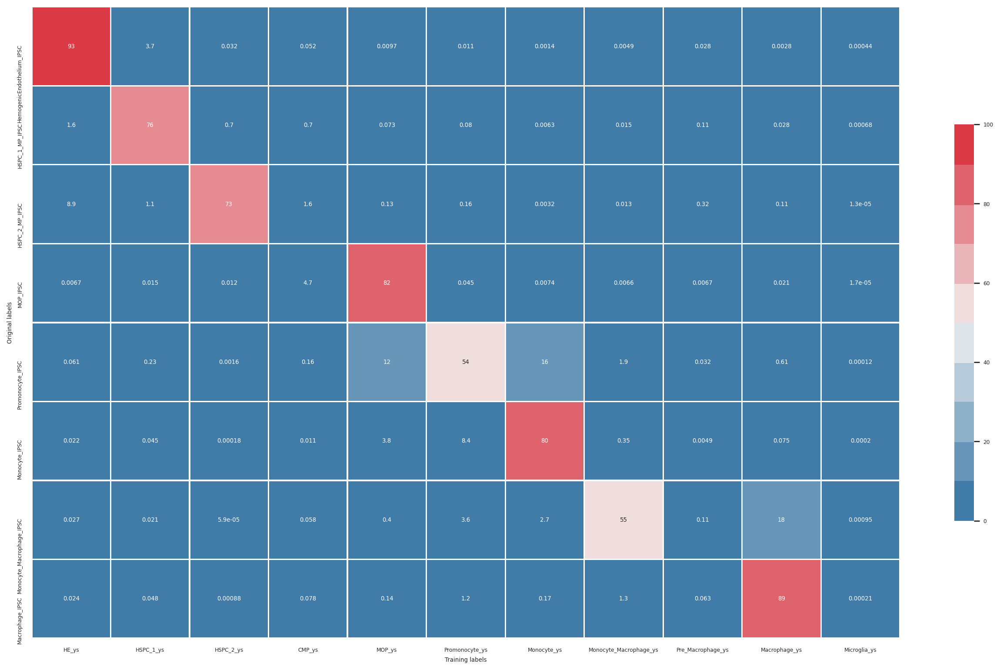

In [12]:
model_mean_probs = pred_out.loc[:, pred_out.columns != 'predicted'].groupby('LR_assignment').median()
model_mean_probs = model_mean_probs*100
model_mean_probs = model_mean_probs.dropna(axis=0, how='any', thresh=None, subset=None, inplace=False)
crs_tbl = model_mean_probs.copy()


# New sorting method
index_order = list(crs_tbl.max(axis=1).sort_values(ascending=False).index)
col_order = list(crs_tbl.max(axis=0).sort_values(ascending=False).index)
crs_tbl = crs_tbl.loc[index_order]
crs_tbl = crs_tbl[col_order]

col_order = ['HE_ys','HSPC_1_ys','HSPC_2_ys','CMP_ys', 'MOP_ys', 'Promonocyte_ys','Monocyte_ys',
                  'Monocyte_Macrophage_ys',
                  'Pre_Macrophage_ys', 'Macrophage_ys', 'Microglia_ys']

index_order = ['HemogenicEndothelium_IPSC',
'HSPC_1_MP_IPSC',
'HSPC_2_MP_IPSC',   
'MOP_IPSC',
'Promonocyte_IPSC',
'Monocyte_IPSC',
'Monocyte_Macrophage_IPSC',
'Macrophage_IPSC',]

crs_tbl = crs_tbl.loc[index_order]
crs_tbl = crs_tbl[col_order]


# Plot_df_heatmap(crs_tbl, cmap='coolwarm', rotation=90, vmin=20, vmax=70)
pal = sns.diverging_palette(240, 10, n=10)
plt.figure(figsize=(20,15))
sns.set(font_scale=0.5)
g = sns.heatmap(crs_tbl, cmap=pal,  annot=True,vmin=0, vmax=100, linewidths=1, center=50, square=True, cbar_kws={"shrink": 0.5})

plt.ylabel("Original labels")
plt.xlabel("Training labels")
plt.savefig('./v2_2_mac_lin_only_lr_model_median_subclusters.pdf',dpi=300)

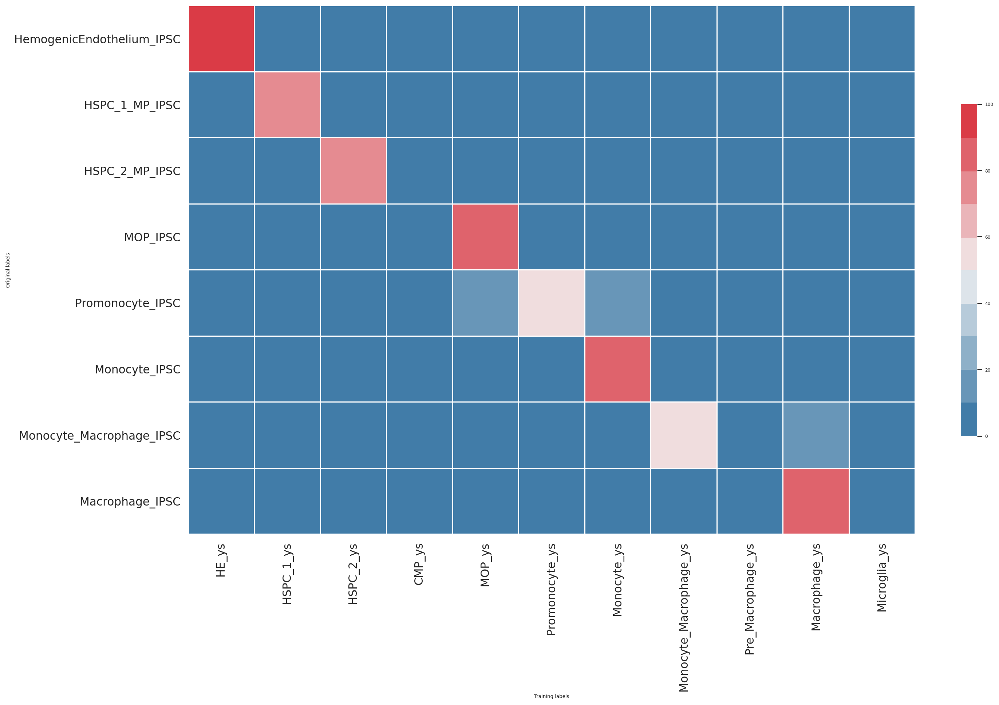

In [15]:
model_mean_probs = pred_out.loc[:, pred_out.columns != 'predicted'].groupby('LR_assignment').median()
model_mean_probs = model_mean_probs*100
model_mean_probs = model_mean_probs.dropna(axis=0, how='any', thresh=None, subset=None, inplace=False)
crs_tbl = model_mean_probs.copy()


# New sorting method
index_order = list(crs_tbl.max(axis=1).sort_values(ascending=False).index)
col_order = list(crs_tbl.max(axis=0).sort_values(ascending=False).index)
crs_tbl = crs_tbl.loc[index_order]
crs_tbl = crs_tbl[col_order]

col_order = ['HE_ys','HSPC_1_ys','HSPC_2_ys','CMP_ys', 'MOP_ys', 'Promonocyte_ys','Monocyte_ys',
                  'Monocyte_Macrophage_ys',
                  'Pre_Macrophage_ys', 'Macrophage_ys', 'Microglia_ys']

index_order = ['HemogenicEndothelium_IPSC',
'HSPC_1_MP_IPSC',
'HSPC_2_MP_IPSC',   
'MOP_IPSC',
'Promonocyte_IPSC',
'Monocyte_IPSC',
'Monocyte_Macrophage_IPSC',
'Macrophage_IPSC',]

crs_tbl = crs_tbl.loc[index_order]
crs_tbl = crs_tbl[col_order]


# Plot_df_heatmap(crs_tbl, cmap='coolwarm', rotation=90, vmin=20, vmax=70)
pal = sns.diverging_palette(240, 10, n=10)
plt.figure(figsize=(20,15))
sns.set(font_scale=0.5)
g = sns.heatmap(crs_tbl, cmap=pal,  annot=False,vmin=0, vmax=100, linewidths=1, center=50, square=True, cbar_kws={"shrink": 0.5})
plt.xticks(rotation=90,fontsize=14) 
plt.yticks(rotation=0,fontsize=14)
plt.ylabel("Original labels")
plt.xlabel("Training labels")
plt.savefig('./figures/v2_2_mac_lin_only_lr_model_median_subclusters.pdf',dpi=300)

In [ ]:
pred_out_filtered.groupby([''])

In [149]:
pred_out_filtered

,predicted,orig_labels,AEC_ys,CMP_ys,Cycling DC2_ys,Early_Erythroid_ys,Endoderm_ys,Eo_Baso_Mast_precursor_ys,Eo_Basophil_ys,Erythroid_ys,...,Pre_Macrophage_ys,Prolif_AEC_ys,Prolif_Sinusoidal_EC_ys,Promonocyte_ys,Sinusoidal_EC_ys,Smooth_Muscle_ys,VWF_EC_ys,pDC precursor_ys,LR_assignment,LR_assignment_v2
AAACCTGAGGTGCACA-1,HSPC_2_ys,iPSCs_IPSC,8.511372e-05,0.016047,0.000461,5.821438e-02,4.622670e-03,0.000508,8.333013e-04,1.988256e-03,...,0.001650,0.005402,8.840416e-03,0.000284,7.096234e-07,3.924896e-04,6.204155e-05,1.719799e-04,HSPC_2_IPSC,iPSCs
AAACCTGCAAAGGAAG-1,HSPC_2_ys,PrimitiveStreak_IPSC,1.181075e-05,0.003768,0.000065,3.026520e-03,4.229175e-04,0.000152,9.090603e-05,6.183008e-04,...,0.000465,0.000279,8.821913e-04,0.000251,5.523553e-06,1.757129e-05,8.981735e-06,1.848998e-04,HSPC_2_IPSC,PrimitiveStreak
AAACGGGAGTGTACTC-1,HSPC_2_ys,iPSCs_IPSC,1.111897e-04,0.015811,0.000220,5.698572e-02,3.413528e-03,0.000934,6.180940e-04,7.216999e-04,...,0.001153,0.001405,2.064295e-03,0.000377,4.790278e-07,1.446777e-04,4.853461e-05,3.271809e-04,HSPC_2_IPSC,iPSCs
AAAGATGTCAATACCG-1,HSPC_2_ys,PrimitiveStreak_IPSC,4.745850e-05,0.031731,0.000707,1.010216e-01,2.464391e-03,0.001084,5.218210e-04,1.495032e-03,...,0.001914,0.011486,2.476145e-02,0.000710,3.201654e-06,6.921693e-05,7.213005e-05,2.710679e-04,HSPC_2_IPSC,PrimitiveStreak
AAAGATGTCGTCACGG-1,HSPC_2_ys,PrimitiveStreak_IPSC,5.536106e-06,0.005946,0.000443,1.851539e-02,1.487814e-03,0.000347,5.937860e-04,9.822711e-03,...,0.000705,0.002450,2.018341e-02,0.000187,8.593407e-08,6.925362e-06,1.059878e-05,7.775919e-05,HSPC_2_IPSC,PrimitiveStreak
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTGGAACCACCGGAAA-19,Macrophage_ys,cDC2_IPSC,5.365873e-06,0.023041,0.000038,3.141646e-05,1.799046e-05,0.000008,1.120021e-04,2.727118e-04,...,0.000330,0.000040,6.412776e-06,0.004588,9.120608e-06,5.833519e-07,1.079194e-05,5.619132e-05,Macrophage_IPSC,Macrophage_IPSC
TTGTAGGCATGCTGGC-19,Monocyte_Macrophage_ys,cDC2_IPSC,7.167863e-06,0.000089,0.000957,3.820059e-07,4.481782e-07,0.000049,1.314624e-05,3.033837e-06,...,0.000217,0.000035,9.298196e-06,0.011799,4.395910e-05,3.320602e-07,3.908092e-05,4.811651e-06,Monocyte_Macrophage_IPSC,Monocyte_Macrophage_IPSC
TTTACTGGTTATGCGT-19,Macrophage_ys,Macrophages_IPSC,2.209961e-05,0.000555,0.014584,6.103492e-05,2.460308e-06,0.000193,8.421679e-05,1.263119e-06,...,0.003478,0.000540,4.708061e-04,0.087041,1.609375e-04,4.800910e-06,3.771885e-05,1.264833e-05,Macrophage_IPSC,Macrophage_IPSC
TTTGGTTAGATCCGAG-19,MOP_ys,Granulocytes_IPSC,9.806038e-08,0.008258,0.000010,2.129687e-06,1.397440e-07,0.000003,8.002948e-07,7.861175e-09,...,0.000003,0.000007,4.575755e-07,0.000435,4.508960e-08,3.099013e-08,1.537903e-07,1.012114e-07,MOP_IPSC,MOP_IPSC


# Make a stacked barplot overtime for IPSC

In [156]:
adata = concat[concat.obs.index.isin(pred_out.index)]

In [157]:
adata.obs['LR_assignment'] = pred_out['LR_assignment'].astype(str)

Trying to set attribute `.obs` of view, copying.
/home/jovyan/my-conda-envs/workhorse/lib/python3.8/site-packages/anndata/_core/views.py:31: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead.  To get a de-fragmented frame, use `newframe = frame.copy()`
  container[idx] = value


In [158]:
adata.obs.to_csv('./IPSC_Mac_lin_obs.csv')

In [159]:
adata = adata[~adata.obs['SampleName'].isin(['Day01EB'])]

adata.obs.loc[adata.obs['SampleName'].isin(['Day01EB','Day02EB','Day04EB']),'LR_assignment'] = 'HemogenicEndothelium_IPSC'

In [160]:
adata.obs['SampleName'].cat.categories

Index(['Day02EB', 'Day04EB', 'Day05DC', 'Day07DC', 'Day09DC', 'Day11DC',
       'Day14DC', 'Day16DC', 'Day18DC', 'Day21DC', 'Day23DC', 'Day25DC',
       'Day28DC', 'Day31DC', 'Day31plus1DCpre', 'Day31plus4DCpre',
       'Day31plus7DCpre'],
      dtype='object')

In [161]:
adata.obs['LR_assignment'] = adata.obs['LR_assignment'].astype('category')
adata.obs['LR_assignment'] = adata.obs['LR_assignment'].cat.reorder_categories(['HemogenicEndothelium_IPSC',
'HSPC_1_MP_IPSC',
'HSPC_2_MP_IPSC',   
'MOP_IPSC',
'Promonocyte_IPSC',
'Monocyte_IPSC',
'Monocyte_Macrophage_IPSC',
'Macrophage_IPSC',])

Trying to set attribute `.obs` of view, copying.


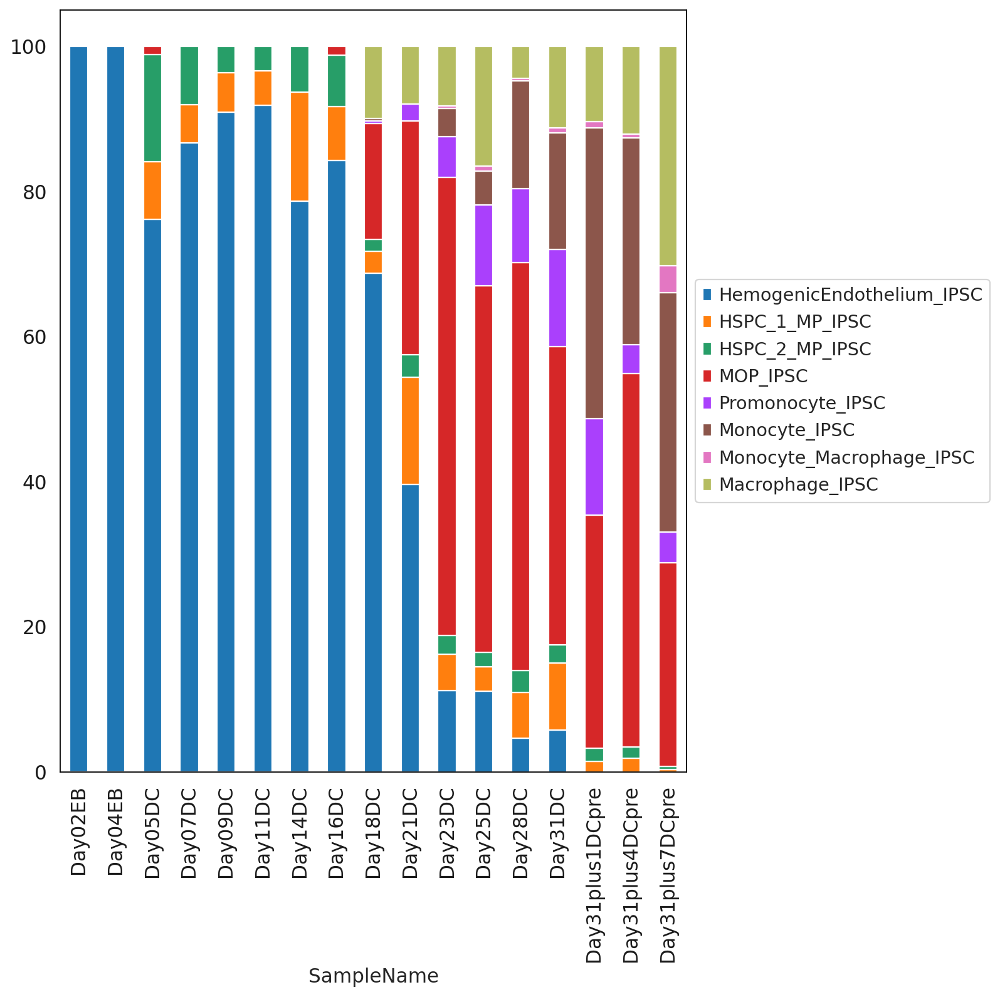

In [167]:
counts = adata.obs.groupby(['LR_assignment','SampleName']).apply(len)
counts = counts.unstack(level=1)
counts = counts.fillna(0)
counts = counts.apply(lambda x: x/x.sum(), axis=0)*100
#counts.columns = counts.columns.droplevel(level=0)
counts = counts.unstack(level=1)



ax = counts.unstack().plot(kind='bar', stacked=True)
# Shrink current axis by 20%
box = ax.get_position()
ax.set_position([box.x0, box.y0, box.width * 0.8, box.height])
ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))
ax.grid(False)
fig = ax.get_figure()
fig.savefig("./figures/IPSC_mac_lin_proportion_barplot.pdf", 
               bbox_inches='tight', 
               transparent=True,
               pad_inches=0, dpi=300)

In [ ]:
adata

<Figure size 800x800 with 0 Axes>

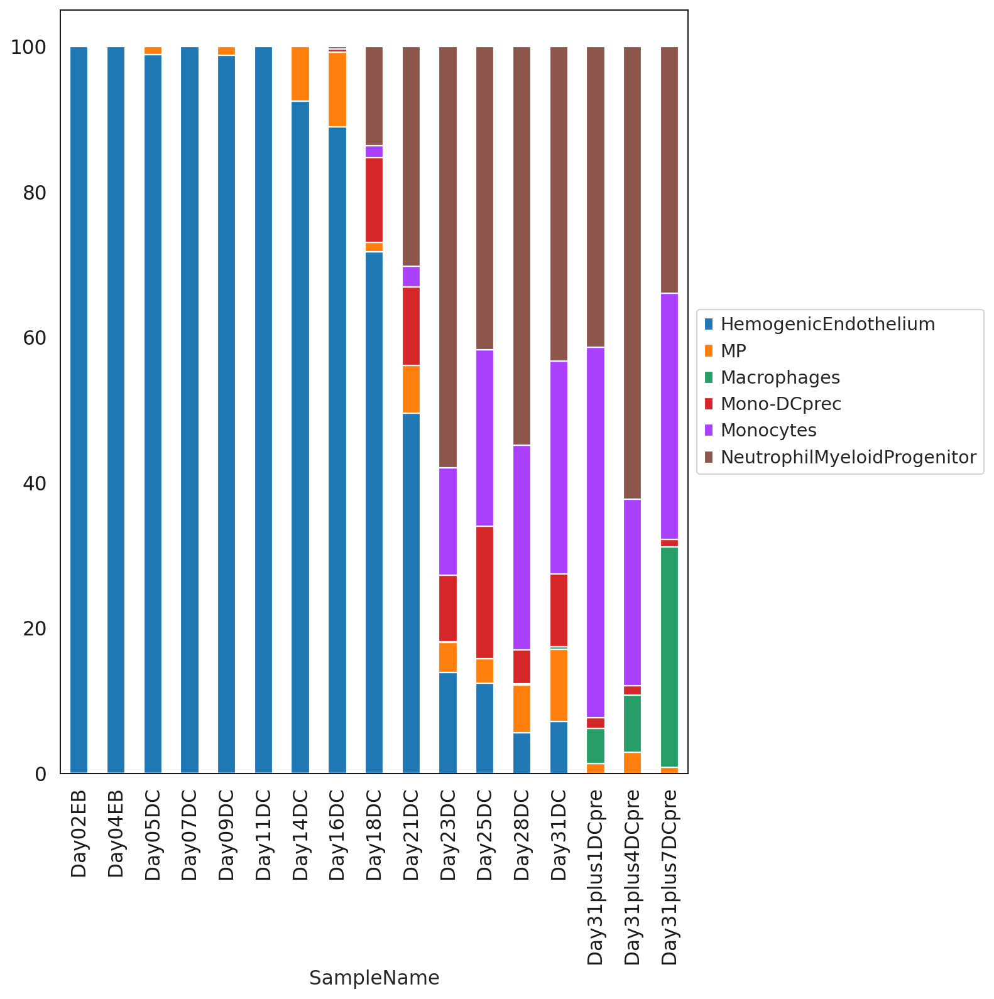

In [168]:
counts = adata.obs.groupby(['CellTypeLR','SampleName']).apply(len)
counts = counts.unstack(level=1)
counts = counts.fillna(0)
counts = counts.apply(lambda x: x/x.sum(), axis=0)*100
#counts.columns = counts.columns.droplevel(level=0)
counts = counts.unstack(level=1)


fig = plt.figure()

ax = counts.unstack().plot(kind='bar', stacked=True)
# Shrink current axis by 20%
box = ax.get_position()
ax.set_position([box.x0, box.y0, box.width * 0.8, box.height])
ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))
ax.grid(False)

fig = ax.get_figure()
fig.savefig("./figures/IPSC_mac_lin_orig_labels_proportion_barplot.pdf", 
               bbox_inches='tight', 
               transparent=True,
               pad_inches=0, dpi=300)

# creat a spotplot for monocyte and mac markers from original clusters and labels

In [181]:
adata.obs['orig_labels_samplename'] = adata.obs['SampleName'].astype(str) + '_' +adata.obs['CellTypeLR'].astype(str)

In [182]:
markers = { 'Monocyte_IPSC': ['CD14','S100A8', 'S100A9', 'CD52'],
 'Macrophage_IPSC': ['C1QC', 'C1QA', 'MRC1', 'C1QB', 'S100B'],}

In [187]:
(adata.obs['SampleName'].unique())

17

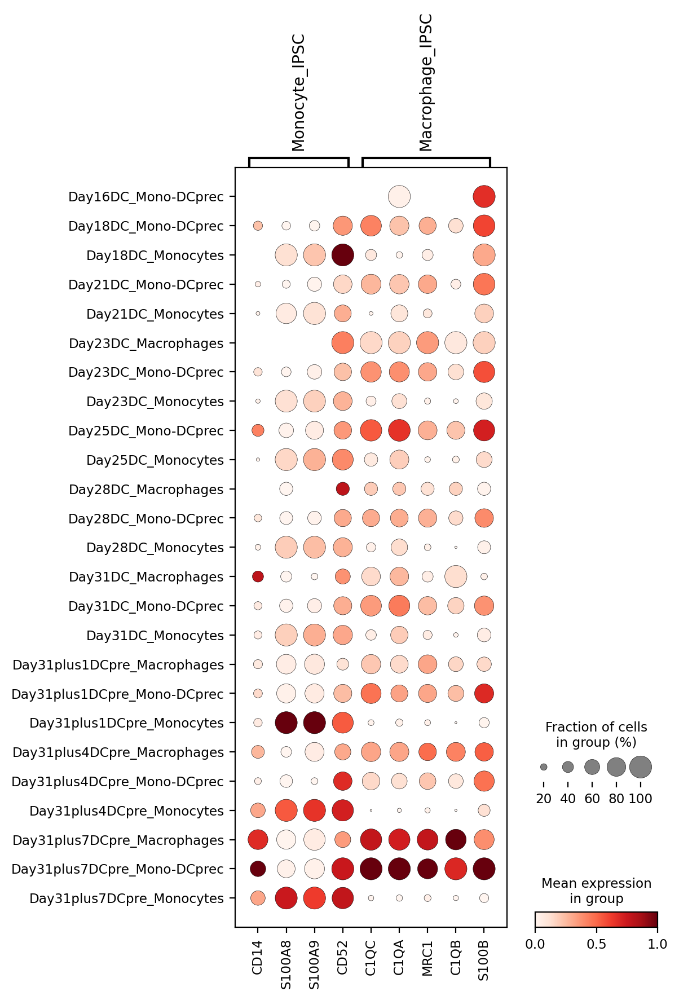

In [184]:
plt.rcdefaults()
adata_temp = adata[adata.obs['CellTypeLR'].isin(["Monocytes","Macrophages","Mono-DCprec"])]
(sc.pl.dotplot(adata_temp, var_names = markers, groupby='orig_labels_samplename',dendrogram=False,standard_scale='var', color_map='Reds', show = True, save = 'orig_labels_time_mono_hetero.pdf')) # title=i

In [232]:
# save the model to disk
import pickle
filename = './v2_2_ys_projected_IPSC_X.sav'
# pickle.dump(model, open(filename, 'wb'))
 
# some time later...
 
# load the model from disk
model = pickle.load(open(filename, 'rb'))
# print(result)

In [233]:
model_back = model

In [234]:
adata_ipsc = adata[adata.obs['tissue'].isin(['IPSC'])]

In [235]:
mac_lin_markers = {'Monocyte_lineage':["CD52",	"S100A8",	"MS4A6A",	"CD14",	"CXCR4",	"CCR2",	"IL1B",	"CD300E",],
'MAC_general':['C1QA','C1QB','TREM2'],
'MAC_I':["F13A1",	"LYVE1",	"SPP1",],
'MAC_II':["CD5L",	"APOE",	"VCAM1",],
'MAC_III':["TOP2A",	"MKI67",],
'MAC_IV':["HLA-DRA",	"HLA-DPA1",	"CLEC7A",],
'MAC_V':["ENG",	"KDR",	"CAV1",],
'MAC_VI':["SPP1","OLFML3","CCL3"],
'MAC_VII':['HBA1','HBA2','HBG2'],
'MAC_VIII':["TREM2",	"P2RY12",],}

In [236]:
adata_ipsc.obs['predicted']

CCTCTGAAGTGTACTC-4          HSPC_2_ys
CTGTTTAGTCCAACTA-4          HSPC_2_ys
GGAATAACAGACAAGC-4          HSPC_1_ys
ATCATCTCACCAACCG-6              HE_ys
GATCGTACAACAACCT-6          HSPC_2_ys
                            ...      
TTCTCCTTCAACGGGA-19    Promonocyte_ys
TTCTCCTTCCAAGTAC-19     Macrophage_ys
TTGAACGAGCCAACAG-19            MOP_ys
TTGAACGTCACTTACT-19     Macrophage_ys
TTTACTGGTTATGCGT-19     Macrophage_ys
Name: predicted, Length: 10016, dtype: category
Categories (9, object): ['CMP_ys', 'HE_ys', 'HSPC_1_ys', 'HSPC_2_ys', ..., 'Macrophage_ys', 'Monocyte_Macrophage_ys', 'Monocyte_ys', 'Promonocyte_ys']

In [237]:
adata_ipsc.obs['corr_concat'] = adata_ipsc.obs['corr_concat'].astype(str)
adata_ipsc.obs.loc[adata_ipsc.obs['tissue'].isin(['IPSC']),'corr_concat'] = adata_ipsc.obs.loc[adata_ipsc.obs['tissue'].isin(['IPSC']),'corr_concat'].astype(str) +  adata_ipsc.obs.loc[adata_ipsc.obs['tissue'].isin(['IPSC']),'SampleName'].astype(str)

Trying to set attribute `.obs` of view, copying.


In [238]:
# If we rename predicted
adata_ipsc.obs['predicted'] = adata_ipsc.obs['predicted'].map(dic)
adata_ipsc.obs['corr_concat'] = adata_ipsc.obs['predicted'].astype(str)
adata_ipsc.obs.loc[adata_ipsc.obs['tissue'].isin(['IPSC']),'corr_concat'] = adata_ipsc.obs.loc[adata_ipsc.obs['tissue'].isin(['IPSC']),'corr_concat'].astype(str) +  adata_ipsc.obs.loc[adata_ipsc.obs['tissue'].isin(['IPSC']),'SampleName'].astype(str)

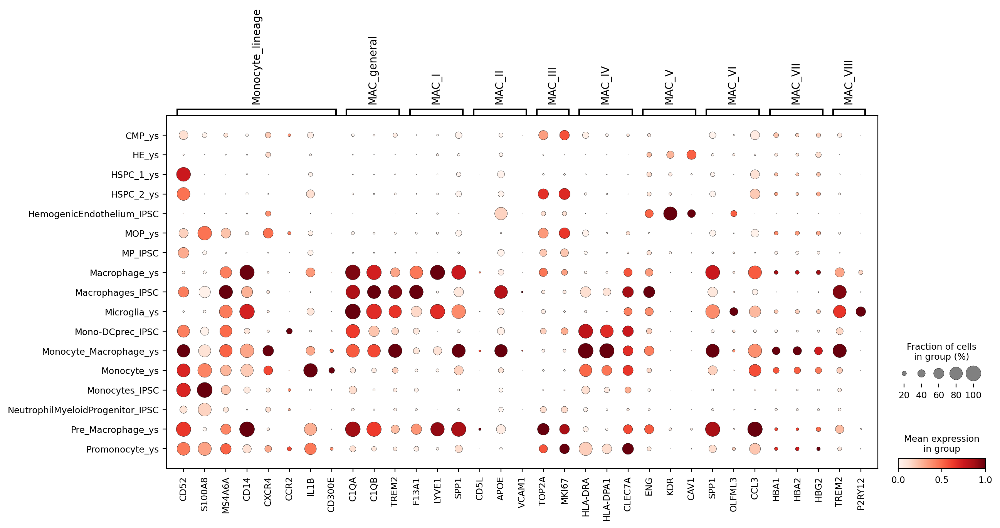

In [239]:
plt.rcdefaults()
sc.pl.dotplot(adata,groupby='corr_concat',var_names=mac_lin_markers ,standard_scale='var')

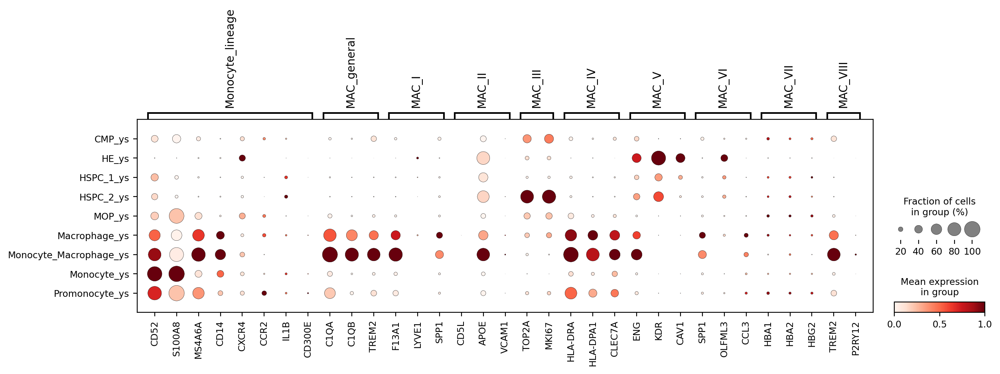

In [240]:
sc.pl.dotplot(adata,groupby='predicted',var_names=mac_lin_markers ,standard_scale='var')

In [241]:
pd.set_option('display.max_rows', 100)
adata_ipsc.obs.groupby('corr_concat').count()

,orig.ident,nCount_RNA,nFeature_RNA,DEMline,DBL_final,RAWdf,SampleName,CellTypeP,SOClineRAW,SOCline,...,fetal.ids,component,broad_cell.labels,sequencing.type,orig.dataset,broad_cell_labels_organ,V6_old_indexes,tissue_fetal_id,batch,predicted
corr_concat,,,,,,,,,,,,,,,,,,,,,
HSPC_1_MP_IPSCDay02EB,19,19,19,18,18,19,19,18,19,19,...,0,0,0,0,0,0,0,19,19,19
HSPC_1_MP_IPSCDay04EB,83,83,83,71,71,83,83,70,83,83,...,0,0,0,0,0,0,0,83,83,83
HSPC_1_MP_IPSCDay05DC,7,7,7,4,4,7,7,4,7,7,...,0,0,0,0,0,0,0,7,7,7
HSPC_1_MP_IPSCDay07DC,4,4,4,3,3,4,4,3,4,4,...,0,0,0,0,0,0,0,4,4,4
HSPC_1_MP_IPSCDay09DC,9,9,9,5,5,9,9,5,9,9,...,0,0,0,0,0,0,0,9,9,9
HSPC_1_MP_IPSCDay11DC,10,10,10,6,6,10,10,6,10,10,...,0,0,0,0,0,0,0,10,10,10
HSPC_1_MP_IPSCDay14DC,36,36,36,25,25,36,36,25,36,36,...,0,0,0,0,0,0,0,36,36,36
HSPC_1_MP_IPSCDay16DC,19,19,19,12,12,19,19,12,19,19,...,0,0,0,0,0,0,0,19,19,19
HSPC_1_MP_IPSCDay18DC,9,9,9,4,4,9,9,4,9,9,...,0,0,0,0,0,0,0,9,9,9


In [242]:
# Remove timepoint values where prediction < 1
adata_ipsc.obs['corr_concat'] = adata_ipsc.obs['corr_concat'].astype(str)
df = adata_ipsc.obs.groupby('corr_concat').apply(len)
adata_ipsc = adata_ipsc[adata_ipsc.obs['corr_concat'].isin(list(df.index[df>1]))]

/home/jovyan/my-conda-envs/workhorse/lib/python3.8/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
/home/jovyan/my-conda-envs/workhorse/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: ImplicitModificationWarning: Initializing view as actual.
  warnings.warn(
Trying to set attribute `.obs` of view, copying.
... storing 'corr_concat' as categorical
/home/jovyan/my-conda-envs/workhorse/lib/python3.8/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
Trying to

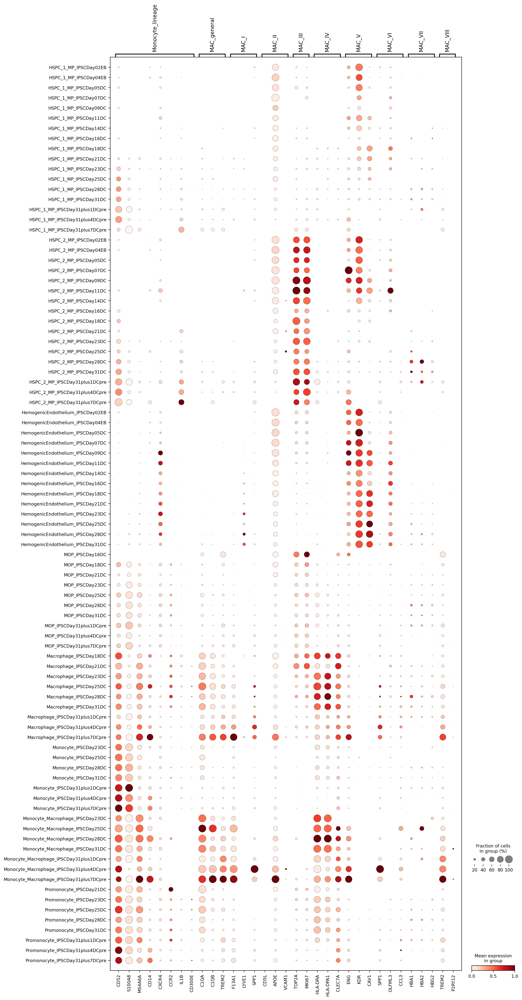

In [243]:
plt.rcdefaults()
sc.pl.dotplot(adata_ipsc,groupby='corr_concat',var_names=mac_lin_markers ,standard_scale='var',save = 'mono_exp_by_time')

In [244]:
adata_ipsc.write('./IPSC_lr_predicted_macrophages.h5ad')

In [245]:
pd.set_option('display.max_rows', 100)
adata_ipsc.obs.groupby('corr_concat').count().iloc[:,0].to_csv('./figures/mono_lin_counts_ipsc_data.csv')

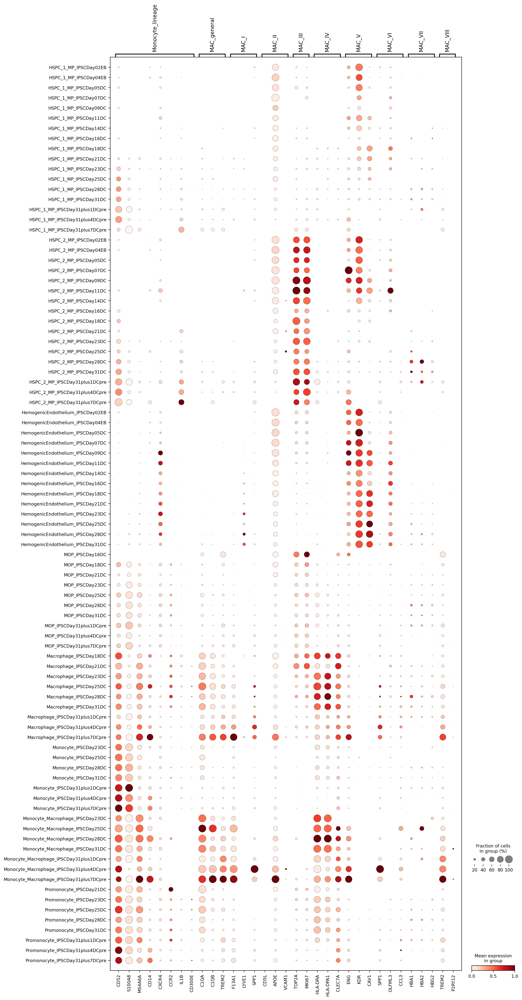

In [246]:
plt.rcdefaults()
sc.pl.dotplot(adata_ipsc,groupby='corr_concat',var_names=mac_lin_markers ,standard_scale='var',save = 'mono_exp_by_time')

In [248]:
# Save pred_out
pred_out.to_csv('./IPSC_pred_out_lr.csv')
# save the obs predictions
adata_ipsc.obs.to_csv('./IPSC_predicted_labels_lr.csv')

# Try clustering

computing PCA
    with n_comps=100
    finished (0:01:51)
Commencing harmony


2022-03-11 15:34:02,025 - harmonypy - INFO - Iteration 1 of 10
2022-03-11 15:34:10,198 - harmonypy - INFO - Iteration 2 of 10
2022-03-11 15:34:20,126 - harmonypy - INFO - Iteration 3 of 10
2022-03-11 15:34:28,017 - harmonypy - INFO - Iteration 4 of 10
2022-03-11 15:34:38,119 - harmonypy - INFO - Iteration 5 of 10
2022-03-11 15:34:43,815 - harmonypy - INFO - Converged after 5 iterations


computing neighbors
    using 'X_pca' with n_pcs = 75
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:02)
computing UMAP


Trying to set attribute `.uns` of view, copying.


    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:05)


/home/jovyan/my-conda-envs/workhorse/lib/python3.8/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'leiden' as categorical


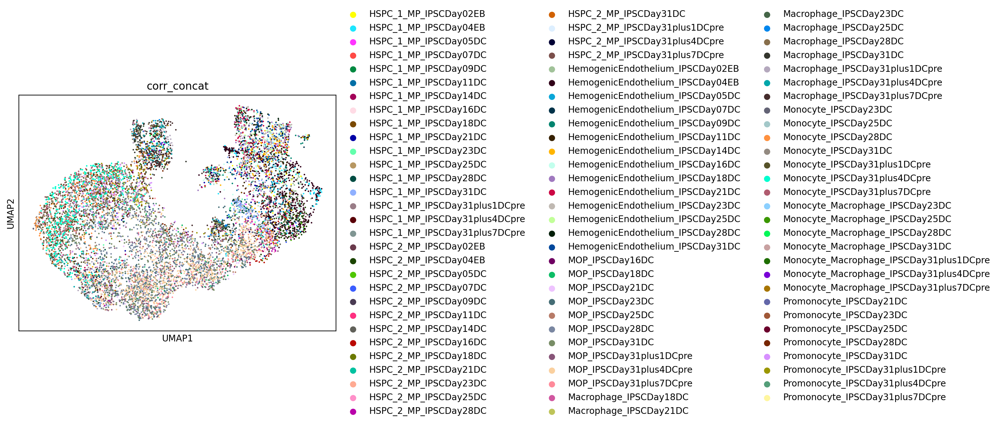

In [250]:
adata_ipsc.obs["lr_batch"] = adata_ipsc.obs['SampleName'][:]


# Now compute PCA
sc.pp.pca(adata_ipsc, n_comps=100, use_highly_variable=False, svd_solver='arpack')
 
if(batch_correction == "Harmony"):
    print("Commencing harmony")
    batch_var = "lr_batch"
    # Create hm subset
    adata_hm = adata_ipsc[:]
    # Set harmony variables
    data_mat = np.array(adata_hm.obsm["X_pca"])
    meta_data = adata_hm.obs
    vars_use = [batch_var]
    # Run Harmony
    ho = hm.run_harmony(data_mat, meta_data, vars_use,theta=theta)
    res = (pd.DataFrame(ho.Z_corr)).T
    res.columns = ['X{}'.format(i + 1) for i in range(res.shape[1])]
    # Insert coordinates back into object
    adata_hm.obsm["X_pca_back"]= adata_hm.obsm["X_pca"][:]
    adata_hm.obsm["X_pca"] = np.array(res)
    # Run neighbours
    sc.pp.neighbors(adata_hm, n_neighbors=30, n_pcs=75)
    adata_ipsc = adata_hm[:]
    del adata_hm
sc.tl.umap(adata_ipsc)
sc.pl.umap(adata_ipsc,color='corr_concat')

In [251]:
# Optional clustering 
res = 5
key_add = 'leiden'
adata_ipsc.obs[key_add] = "nan"
sc.tl.leiden(adata_ipsc, resolution= res, key_added= key_add, random_state=26, n_iterations=-1)

running Leiden clustering
    finished: found 51 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:01)


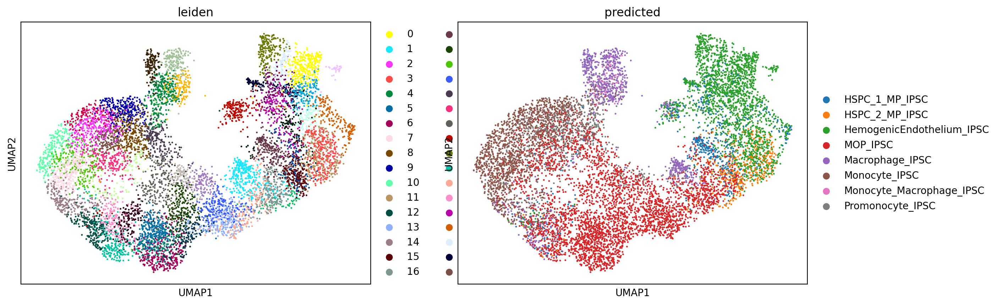

In [252]:
sc.pl.umap(adata_ipsc,color=['leiden','predicted'])

In [253]:
pred_out

,predicted,orig_labels,CMP_ys,HE_ys,HSPC_1_ys,HSPC_2_ys,MOP_ys,Macrophage_ys,Microglia_ys,Monocyte_Macrophage_ys,Monocyte_ys,Pre_Macrophage_ys,Promonocyte_ys,LR_assignment
CCTCTGAAGTGTACTC-4,HSPC_2_ys,HemogenicEndothelium_IPSC,0.024266,0.087202,0.037661,8.388888e-01,0.001291,0.001533,4.338438e-07,0.000161,0.000025,0.007106,0.001867,HSPC_2_MP_IPSC
CTGTTTAGTCCAACTA-4,HSPC_2_ys,HemogenicEndothelium_IPSC,0.143932,0.091850,0.314763,3.659172e-01,0.009154,0.036103,6.761042e-04,0.004952,0.000418,0.015104,0.017130,HSPC_2_MP_IPSC
GGAATAACAGACAAGC-4,HSPC_1_ys,HemogenicEndothelium_IPSC,0.002868,0.040314,0.938387,8.214713e-03,0.000242,0.004812,1.819551e-06,0.000361,0.000178,0.001923,0.002699,HSPC_1_MP_IPSC
ATCATCTCACCAACCG-6,HE_ys,HemogenicEndothelium_IPSC,0.000204,0.969060,0.030420,2.991909e-06,0.000013,0.000014,7.992566e-06,0.000017,0.000003,0.000185,0.000073,HemogenicEndothelium_IPSC
GATCGTACAACAACCT-6,HSPC_2_ys,HemogenicEndothelium_IPSC,0.005831,0.162285,0.077768,7.494025e-01,0.000508,0.000169,4.862063e-07,0.000077,0.000014,0.002944,0.001002,HSPC_2_MP_IPSC
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTCTCCTTCAACGGGA-19,Promonocyte_ys,Monocytes_IPSC,0.000369,0.001386,0.001297,1.757900e-05,0.102756,0.003843,1.110594e-05,0.063146,0.304878,0.000676,0.521622,Promonocyte_IPSC
TTCTCCTTCCAAGTAC-19,Macrophage_ys,Macrophages_IPSC,0.000063,0.000040,0.000003,7.752528e-09,0.000360,0.852297,4.416321e-06,0.145778,0.000714,0.000223,0.000517,Macrophage_IPSC
TTGAACGAGCCAACAG-19,MOP_ys,NeutrophilMyeloidProgenitor_IPSC,0.018053,0.001207,0.000031,1.194516e-01,0.255590,0.246867,2.319817e-06,0.006914,0.100166,0.000626,0.251092,MOP_IPSC
TTGAACGTCACTTACT-19,Macrophage_ys,Macrophages_IPSC,0.000089,0.000040,0.000062,1.431389e-09,0.001929,0.990941,3.995337e-07,0.003616,0.000814,0.000056,0.002452,Macrophage_IPSC


In [266]:
cluster_prediction = "clus_prediction"
clusters_reassign = "leiden"
lr_predicted_col = 'predicted'

In [267]:
adata_ipsc.obs[cluster_prediction] = adata_ipsc.obs.index
for z in adata_ipsc.obs[clusters_reassign].unique():
    df = adata_ipsc.obs
    df = df[(df[clusters_reassign].isin([z]))]
    df_count = pd.DataFrame(df[lr_predicted_col].value_counts())
    freq_arranged = df_count.index
    cat = freq_arranged[0]
    df.loc[:,cluster_prediction] = cat
    adata_ipsc.obs.loc[adata_ipsc.obs[clusters_reassign] == z, [cluster_prediction]] = cat

/home/jovyan/my-conda-envs/workhorse/lib/python3.8/site-packages/pandas/core/indexing.py:1817: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_column(loc, value, pi)


/home/jovyan/my-conda-envs/workhorse/lib/python3.8/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'clus_prediction' as categorical


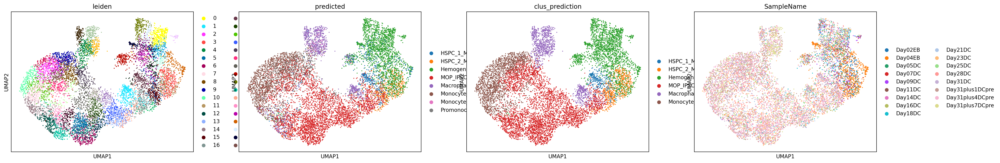

In [256]:
sc.pl.umap(adata_ipsc,color=['leiden','predicted','clus_prediction','SampleName'])

In [269]:
# If we rename predicted
adata_ipsc.obs['corr_concat'] = adata_ipsc.obs['clus_prediction'].astype(str)
adata_ipsc.obs.loc[adata_ipsc.obs['tissue'].isin(['IPSC']),'corr_concat'] = adata_ipsc.obs.loc[adata_ipsc.obs['tissue'].isin(['IPSC']),'corr_concat'].astype(str) +  adata_ipsc.obs.loc[adata_ipsc.obs['tissue'].isin(['IPSC']),'SampleName'].astype(str)

In [270]:
# Remove timepoint values where prediction < 1
adata_ipsc.obs['corr_concat'] = adata_ipsc.obs['corr_concat'].astype(str)
df = adata_ipsc.obs.groupby('corr_concat').apply(len)
adata_ipsc = adata_ipsc[adata_ipsc.obs['corr_concat'].isin(list(df.index[df>1]))]

In [271]:
pd.set_option('display.max_rows', 100)
adata_ipsc.obs.groupby('corr_concat').count()

,orig.ident,nCount_RNA,nFeature_RNA,DEMline,DBL_final,RAWdf,SampleName,CellTypeP,SOClineRAW,SOCline,...,broad_cell.labels,sequencing.type,orig.dataset,broad_cell_labels_organ,V6_old_indexes,tissue_fetal_id,batch,predicted,leiden,clus_prediction
corr_concat,,,,,,,,,,,,,,,,,,,,,
HSPC_1_MP_IPSCDay04EB,20,20,20,20,20,20,20,20,20,20,...,0,0,0,0,0,20,20,20,20,20
HSPC_1_MP_IPSCDay05DC,7,7,7,6,6,7,7,6,7,7,...,0,0,0,0,0,7,7,7,7,7
HSPC_1_MP_IPSCDay07DC,4,4,4,4,4,4,4,4,4,4,...,0,0,0,0,0,4,4,4,4,4
HSPC_1_MP_IPSCDay09DC,4,4,4,3,3,4,4,3,4,4,...,0,0,0,0,0,4,4,4,4,4
HSPC_1_MP_IPSCDay11DC,2,2,2,2,2,2,2,2,2,2,...,0,0,0,0,0,2,2,2,2,2
HSPC_1_MP_IPSCDay14DC,12,12,12,12,12,12,12,12,12,12,...,0,0,0,0,0,12,12,12,12,12
HSPC_1_MP_IPSCDay16DC,7,7,7,6,6,7,7,6,7,7,...,0,0,0,0,0,7,7,7,7,7
HSPC_1_MP_IPSCDay18DC,5,5,5,3,3,5,5,3,5,5,...,0,0,0,0,0,5,5,5,5,5
HSPC_1_MP_IPSCDay21DC,7,7,7,7,7,7,7,7,7,7,...,0,0,0,0,0,7,7,7,7,7


In [171]:
adata_ipsc.obs

,orig.ident,nCount_RNA,nFeature_RNA,DEMline,DBL_final,RAWdf,SampleName,CellTypeP,SOClineRAW,SOCline,...,broad_cell.labels,sequencing.type,orig.dataset,broad_cell_labels_organ,V6_old_indexes,tissue_fetal_id,batch,predicted,leiden,clus_prediction
CCTCTGAAGTGTACTC-4,AGGd,24066,4831,DBL-kolf_2-vass_1,DBL,FILT,Day04EB,NaN,1,SNG-vass_1,...,NaN,NaN,NaN,NaN,NaN,IPSC,0,HSPC_2_MP_IPSC,20,MOP_IPSC
CTGTTTAGTCCAACTA-4,AGGd,978,621,NaN,NaN,NEW,Day04EB,NaN,1,SNG-vass_1,...,NaN,NaN,NaN,NaN,NaN,IPSC,0,HSPC_2_MP_IPSC,12,MOP_IPSC
GGAATAACAGACAAGC-4,AGGd,890,599,NaN,NaN,NEW,Day04EB,NaN,1,SNG-vass_1,...,NaN,NaN,NaN,NaN,NaN,IPSC,0,HSPC_1_MP_IPSC,12,MOP_IPSC
ATCATCTCACCAACCG-6,AGGd,2068,1240,NaN,NaN,NEW,Day07DC,NaN,1,SNG-vass_1,...,NaN,NaN,NaN,NaN,NaN,IPSC,0,HemogenicEndothelium_IPSC,24,HemogenicEndothelium_IPSC
GATCGTACAACAACCT-6,AGGd,34372,6013,DBL-kolf_2-vass_1,DBL,FILT,Day07DC,NaN,1,SNG-vass_1,...,NaN,NaN,NaN,NaN,NaN,IPSC,0,HSPC_2_MP_IPSC,15,HSPC_2_MP_IPSC
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTCTCCTTCAACGGGA-19,AGGd,5034,1936,SNG-kolf_2,SNG,OLD,Day31plus7DCpre,cDC2,0,SNG-kolf_2,...,NaN,NaN,NaN,NaN,NaN,IPSC,0,Promonocyte_IPSC,8,MOP_IPSC
TTCTCCTTCCAAGTAC-19,AGGd,6097,2095,SNG-kolf_2,SNG,OLD,Day31plus7DCpre,Macrophages,0,SNG-kolf_2,...,NaN,NaN,NaN,NaN,NaN,IPSC,0,Macrophage_IPSC,40,Macrophage_IPSC
TTGAACGAGCCAACAG-19,AGGd,2468,1330,NaN,NaN,NEW,Day31plus7DCpre,NaN,0,SNG-kolf_2,...,NaN,NaN,NaN,NaN,NaN,IPSC,0,MOP_IPSC,44,MOP_IPSC
TTGAACGTCACTTACT-19,AGGd,4496,1732,SNG-kolf_2,SNG,OLD,Day31plus7DCpre,cDC2,0,SNG-kolf_2,...,NaN,NaN,NaN,NaN,NaN,IPSC,0,Macrophage_IPSC,4,Macrophage_IPSC


In [ ]:
model.predict(predict_x)

In [28]:
 # Get aggreagted
key_add = 'orig_labels'
pred_out[key_add] = pred_out[key_add].astype(str)
pred_out[key_add]  = pred_out[key_add].str.replace('_\d+_','_').astype(str)

<ipython-input-28-b8341e8fb115>:4: FutureWarning: The default value of regex will change from True to False in a future version.
  pred_out[key_add]  = pred_out[key_add].str.replace('_\d+_','_').astype(str)


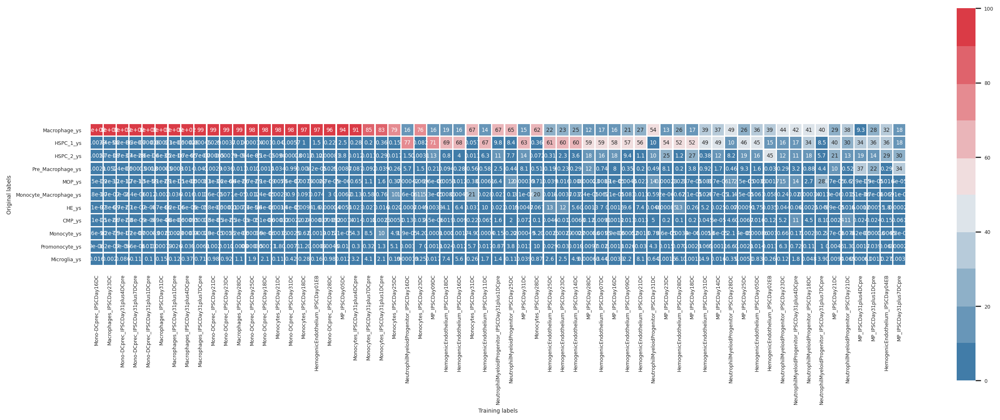

In [29]:
model_mean_probs = pred_out.loc[:, pred_out.columns != 'predicted'].groupby('orig_labels').mean()
model_mean_probs = model_mean_probs*100
model_mean_probs = model_mean_probs.dropna(axis=0, how='any', thresh=None, subset=None, inplace=False)
crs_tbl = model_mean_probs.copy()
# New sorting method
index_order = list(crs_tbl.max(axis=1).sort_values(ascending=False).index)
col_order = list(crs_tbl.max(axis=0).sort_values(ascending=False).index)
crs_tbl = crs_tbl.loc[index_order]
crs_tbl = crs_tbl[col_order]
# Plot_df_heatmap(crs_tbl, cmap='coolwarm', rotation=90, vmin=20, vmax=70)
pal = sns.diverging_palette(240, 10, n=10)
plt.figure(figsize=(20,15))
sns.set(font_scale=0.5)
crs_tbl = crs_tbl.T
g = sns.heatmap(crs_tbl, cmap=pal,  annot=True,vmin=0, vmax=100, linewidths=1, center=50, square=True, cbar_kws={"shrink": 0.5})
plt.ylabel("Original labels")
plt.xlabel("Training labels")
plt.savefig('./ver5_lr_model_means_clusters.pdf',dpi=300)

In [ ]:
inverse = pred_out.loc[:, pred_out.columns != 'predicted'].T

In [ ]:
inverse.loc[inverse.index != 'orig_labels',: ]

In [ ]:
model_mean_probs = pred_out.loc[:, pred_out.columns != 'predicted'].groupby('orig_labels').median()

In [ ]:
model_mean_probs = pred_out.loc[:, pred_out.columns != 'predicted'].groupby('orig_labels').median()

In [ ]:
model_mean_probs*100

# Export data from here and perform harmony optimisation prior to continuation
-- sil score high between samples and low kbet rejection rate = optimal

In [219]:
model = LogisticRegression(penalty = penalty, max_iter =  max_iter, dual=False,solver = 'saga', multi_class = 'multinomial',l1_ratio=1)
model.fit(X,y)

/home/jovyan/my-conda-envs/workhorse/lib/python3.8/site-packages/sklearn/utils/validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)
/home/jovyan/my-conda-envs/workhorse/lib/python3.8/site-packages/sklearn/linear_model/_sag.py:328: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn("The max_iter was reached which means "


LogisticRegression(l1_ratio=1, max_iter=200, multi_class='multinomial',
                   penalty='elasticnet', solver='saga')

In [ ]:
## tune regularization for multinomial logistic regression
X = tune_train_x
y = tune_train_label

# define model
cv = RepeatedKFold(n_splits=10, n_repeats=3, random_state=1)
model = LogisticRegression(penalty = penalty, max_iter =  max_iter, dual=False,solver = 'saga', multi_class = 'multinomial')

# define grid
grid = dict()
grid['C'] = [0.0, 1.0]
grid['l1_ratio'] = arange(0, 1, 0.1)
# define search
search = GridSearchCV(model, grid, scoring='neg_mean_absolute_error', cv=cv, n_jobs=-1)
# perform the search
results = search.fit(X, y)
# summarize
print('MAE: %.3f' % results.best_score_)
print('Config: %s' % results.best_params_)

In [ ]:
import pandas as pd

results_df = pd.DataFrame(search.cv_results_)
results_df = results_df.sort_values(by=['rank_test_score'])
results_df = (
    results_df
    .set_index(results_df["params"].apply(
        lambda x: "_".join(str(val) for val in x.values()))
    )
    .rename_axis('kernel')
)
results_df[
    ['params', 'rank_test_score', 'mean_test_score', 'std_test_score']
]


In [ ]:
# create df of model scores ordered by performance
model_scores = results_df.filter(regex=r'split\d*_test_score')

# plot 30 examples of dependency between cv fold and AUC scores
fig, ax = plt.subplots()
sns.lineplot(
    data=model_scores.transpose().iloc[:30],
    dashes=False, palette='Set1', marker='o', alpha=.5, ax=ax
)
ax.set_xlabel("CV test fold", size=12, labelpad=10)
ax.set_ylabel("Model AUC", size=12)
ax.tick_params(bottom=True, labelbottom=False)
plt.show()

# print correlation of AUC scores across folds
print(f"Correlation of models:\n {model_scores.transpose().corr()}")

/home/jovyan/my-conda-envs/workhorse/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


Text(0.5, 291.10937500000006, 'Training labels')

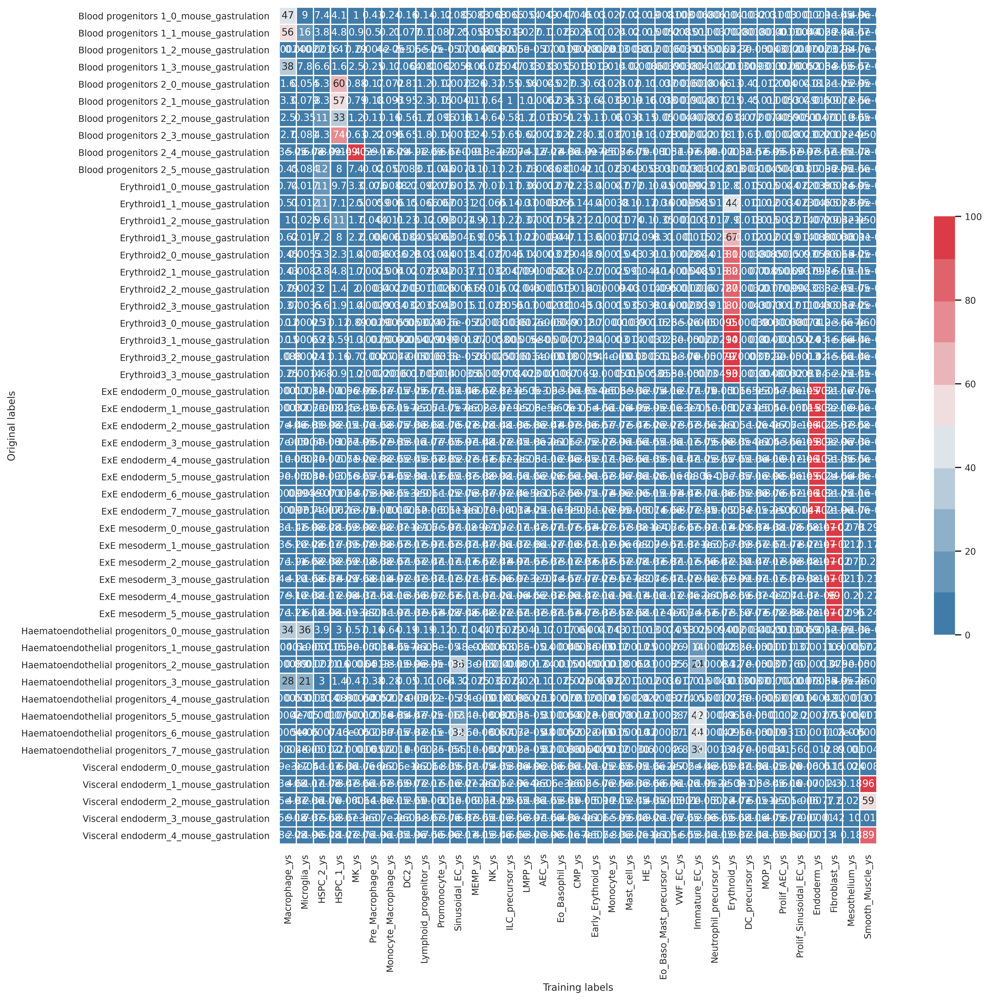

In [63]:


train_label = adata.obs[common_cat].values
predict_label = train_label[subset_predict]

X, y = load_iris(return_X_y=True)
clf = LogisticRegression(random_state=0).fit(X, y)
clf.predict(X[:2, :])
clf.score(X, y)

pred_out = pd.DataFrame(model.predict(predict_x),columns = ['predicted'],index = adata.obs.index[adata.obs[common_cat].isin(group2)])
pred_out['orig_labels'] = predict_label
proba = pd.DataFrame(model.predict_proba(predict_x),columns = lr.classes_,index = adata.obs.index[adata.obs[common_cat].isin(group2)])
pred_out = pred_out.join(proba)
pred_out

model_mean_probs = pred_out.loc[:, pred_out.columns != 'predicted'].groupby('orig_labels').mean()
model_mean_probs = pred_out.loc[:, pred_out.columns != 'predicted'].groupby('orig_labels').median()
model_mean_probs = model_mean_probs*100
model_mean_probs = model_mean_probs.dropna(axis=0, how='any', thresh=None, subset=None, inplace=False)
crs_tbl = model_mean_probs.copy()
# Sort df columns by rows
crs_tbl = crs_tbl.sort_values(by =list(crs_tbl.index), axis=1,ascending=False)
# Plot_df_heatmap(crs_tbl, cmap='coolwarm', rotation=90, vmin=20, vmax=70)
pal = sns.diverging_palette(240, 10, n=10)
plt.figure(figsize=(20,15))
sns.set(font_scale=0.8)
g = sns.heatmap(crs_tbl, cmap=pal,  annot=True,vmin=0, vmax=100, linewidths=1, center=50, square=True, cbar_kws={"shrink": 0.5})
plt.ylabel("Original labels")
plt.xlabel("Training labels")

In [64]:
crs_tbl = pd.read_csv('/nfs/team205/ig7/work_backups/backup_210306/projects/YS/YS_090321_notebooks/YS_Reprocess_250721_updates/mouse_gastrulation_human_YS_combination/med_lr_probs.csv',index_col=0)

Text(0.5, 635.5639204545454, 'Training labels')

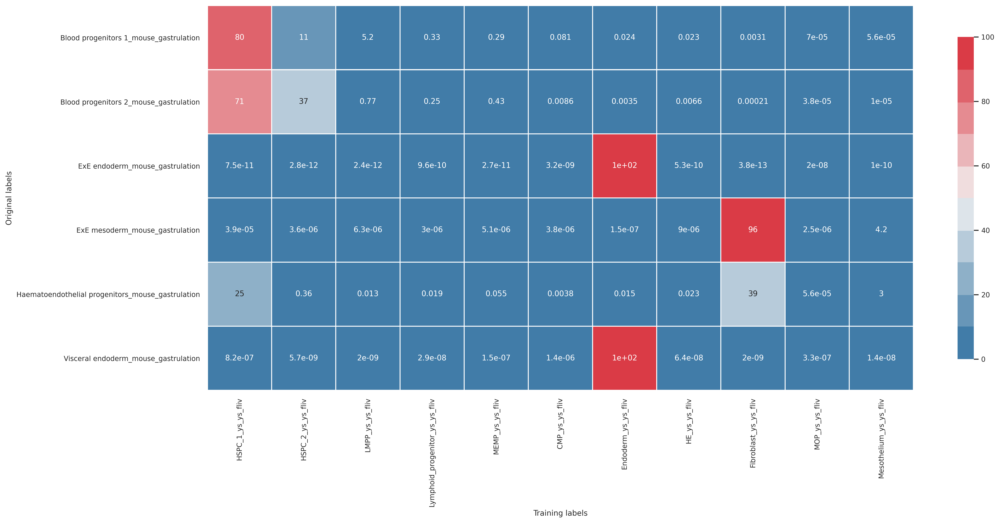

In [65]:
crs_tbl = crs_tbl.sort_values(by =list(crs_tbl.index), axis=1,ascending=False)
# Plot_df_heatmap(crs_tbl, cmap='coolwarm', rotation=90, vmin=20, vmax=70)
pal = sns.diverging_palette(240, 10, n=10)
plt.figure(figsize=(20,15))
sns.set(font_scale=0.8)
g = sns.heatmap(crs_tbl, cmap=pal,  annot=True,vmin=0, vmax=100, linewidths=1, center=50, square=True, cbar_kws={"shrink": 0.5})
plt.ylabel("Original labels")
plt.xlabel("Training labels")

In [66]:
pred_out.loc[:, pred_out.columns != 'predicted'].groupby('orig_labels')

In [67]:
crs_tbl.to_csv('./med_lr_probs.csv')

# Model Coefficients
- https://www.datasklr.com/logistic-regression/multinomial-logistic-regression
-The interpretation of the exponentiated coefficients is for a single unit change in the predictor variable, the odds will be multiplied by a factor indicated by the exponent of the beta coefficient, given that all other variables are held constant.  For example, the first variable is LENGTH with a value of 0.038.  This means  that if length increases by one unit the odds of being female is 3.8% compared to the status when length did not increase by one unit. A generic output looks looks something like this (the below is based on infants!)

# Get Model prediction output ranked genes
# Add PC coeff as well
-Standardized coefficients represent the mean change in the response given a one standard deviation change in the predictor.

- plotting multinomial lr https://scikit-learn.org/dev/auto_examples/linear_model/plot_logistic_multinomial.html

In [68]:
# Export top genes for each PC loading
coeff = pd.DataFrame(model.coef_,index = lr.classes_)
df_loadings = pd.DataFrame(adata.varm['PCs'], index=adata.var_names)
df_rankings = pd.DataFrame((-1 * df_loadings.values).argsort(0).argsort(0), index=df_loadings.index, columns=df_loadings.columns)
coeff_rankings = (pd.DataFrame((-1 * coeff.T.values).argsort(0).argsort(0), index=coeff.T.index, columns=coeff.T.columns)).T

# get top loadings for each classification
# Use Cumulative distribution to determine feature importance
ranking_genes = pd.DataFrame(columns = ['class','x_pc','top_loadings','loading_val'])
for classes in coeff_rankings.index:
    print(classes)
    class_ranking = pd.DataFrame(coeff_rankings.T.loc[: , classes])
    class_ranking = class_ranking.iloc[:,0].sort_values().head(3)
    for comps in class_ranking.index:
        print(comps)
        genes = list(df_rankings[comps].sort_values().head(15).index)
        compile_classes = pd.DataFrame(columns = ranking_genes.columns)
        compile_classes.top_loadings = genes
        compile_classes.x_pc = comps
        compile_classes['class'] = classes
        compile_classes['loading_val'] = df_loadings.loc[df_loadings.index.isin(genes),comps].sort_values(ascending=False).values
        ranking_genes = pd.concat([ranking_genes,compile_classes])
        U = np.mean(df_loadings[comps])
        std = np.std(df_loadings[comps])
        med =  np.median(df_loadings[comps])
        mad = np.median(np.absolute(df_loadings[comps] - np.median(df_loadings[comps])))
        pvals = scipy.stats.norm.sf(df_loadings[comps], loc=U, scale=1*std)
        pvals = scipy.stats.norm.sf(df_loadings[comps], loc=med, scale=2*mad)
        df_loadings[str(comps) +'_pval'] = pvals

ranking_genes.to_csv('lr_features_sig.csv')
#plt.plot(coeff.iloc[0,:], coeff.iloc[0,:] + 0, '-g')
#plt.axvline(x=-0.36914894,color='blue')
#plt.axvline(x=-0.36914894,color='blue')

AEC_ys
13
1
2
CMP_ys
32
30
27
DC2_ys
41
4
10
DC_precursor_ys
11
22
21
Early_Erythroid_ys
52
79
42
Endoderm_ys
3
28
43
Eo_Baso_Mast_precursor_ys
25
19
6
Eo_Basophil_ys
25
26
19
Erythroid_ys
6
2
14
Fibroblast_ys
0
5
14
HE_ys
2
13
97
HSPC_1_ys
11
1
20
HSPC_2_ys
10
20
31
ILC_precursor_ys
23
10
11
Immature_EC_ys
2
16
24
LMPP_ys
10
36
29
Lymphoid_progenitor_ys
23
22
10
MEMP_ys
60
6
12
MK_ys
7
62
5
MOP_ys
32
6
27
Macrophage_ys
1
6
22
Mast_cell_ys
25
6
51
Mesothelium_ys
9
0
17
Microglia_ys
1
3
21
Monocyte_Macrophage_ys
16
3
33
Monocyte_ys
24
16
18
NK_ys
38
90
22
Neutrophil_precursor_ys
36
25
32
Pre_Macrophage_ys
15
23
1
Prolif_AEC_ys
13
10
7
Prolif_Sinusoidal_EC_ys
2
10
40
Promonocyte_ys
15
14
54
Sinusoidal_EC_ys
2
16
1
Smooth_Muscle_ys
0
5
14
VWF_EC_ys
20
16
2


In [69]:
ranking_genes

,class,x_pc,top_loadings,loading_val
0,AEC_ys,13,GJA5,0.254285
1,AEC_ys,13,IL33,0.232750
2,AEC_ys,13,TMEM100,0.204895
3,AEC_ys,13,GJA4,0.153486
4,AEC_ys,13,CLEC14A,0.136381
...,...,...,...,...
10,VWF_EC_ys,2,PECAM1,0.097085
11,VWF_EC_ys,2,APLNR,0.096024
12,VWF_EC_ys,2,CD93,0.094238
13,VWF_EC_ys,2,ADGRL4,0.092574


# Plot these genes

In [70]:
pd.concat([ranking_genes.groupby(['class','x_pc']).head(3),ranking_genes.groupby(['class','x_pc']).tail(3)])

,class,x_pc,top_loadings,loading_val
0,AEC_ys,13,GJA5,0.254285
1,AEC_ys,13,IL33,0.232750
2,AEC_ys,13,TMEM100,0.204895
0,AEC_ys,1,AIF1,0.078790
1,AEC_ys,1,LAPTM5,0.078590
...,...,...,...,...
13,VWF_EC_ys,16,AREG,0.070373
14,VWF_EC_ys,16,UPP1,0.069793
12,VWF_EC_ys,2,CD93,0.094238
13,VWF_EC_ys,2,ADGRL4,0.092574


In [71]:
ranking_genes.groupby(['class','x_pc']).head(5)
ranking_genes.groupby(['class','x_pc']).tail(5)

,class,x_pc,top_loadings,loading_val
10,AEC_ys,13,LTBP4,0.106285
11,AEC_ys,13,EMP1,0.094575
12,AEC_ys,13,EFNB2,0.092828
13,AEC_ys,13,SLC1A4,0.091128
14,AEC_ys,13,AQP1,0.087766
...,...,...,...,...
10,VWF_EC_ys,2,PECAM1,0.097085
11,VWF_EC_ys,2,APLNR,0.096024
12,VWF_EC_ys,2,CD93,0.094238
13,VWF_EC_ys,2,ADGRL4,0.092574


In [72]:
rank = pd.concat([ranking_genes.groupby(['class','x_pc']).head(3),ranking_genes.groupby(['class','x_pc']).tail(3)])
plot_genes =  rank.groupby(['class'])['top_loadings'].agg(lambda grp: list(grp)).to_dict()

In [73]:
rank = pd.concat([ranking_genes.groupby(['class','x_pc']).head(3),ranking_genes.groupby(['class','x_pc']).tail(3)])
plot_genes =  rank.groupby(['class'])['top_loadings'].agg(lambda grp: list(grp)).to_dict()
predict_grp = adata[adata.obs[common_cat].isin(group1)]
counts = (pd.DataFrame(predict_grp.obs['corr_concat'].value_counts()))
#predict_grp = predict_grp[predict_grp.obs.index.isin(predict_grp.obs.groupby('predicted').head(100).index)]
sc.pl.tracksplot(predict_grp, plot_genes, groupby='corr_concat', dendrogram=True,save = 'trackspot')

    using 'X_pca' with n_pcs = 100
Storing dendrogram info using `.uns['dendrogram_corr_concat']`


Trying to set attribute `.uns` of view, copying.


KeyboardInterrupt: 

Error in callback <function flush_figures at 0x7f45104d6ca0> (for post_execute):


KeyboardInterrupt: 

In [ ]:
rank = pd.concat([ranking_genes.groupby(['class','x_pc']).head(3),ranking_genes.groupby(['class','x_pc']).tail(3)])
plot_genes =  rank.groupby(['class'])['top_loadings'].agg(lambda grp: list(grp)).to_dict()

In [ ]:
predict_grp = adata[adata.obs[common_cat].isin(group2)]
counts = (pd.DataFrame(predict_grp.obs['predicted'].value_counts()))
#predict_grp = predict_grp[predict_grp.obs.index.isin(predict_grp.obs.groupby('predicted').head(100).index)]
sc.pl.tracksplot(predict_grp, plot_genes, groupby='corr_concat', dendrogram=True,save = 'trackspot')

In [ ]:
ranking_genes.to_csv('/nfs/team205/ig7/work_backups/backup_210306/projects/YS/YS_090321_notebooks/YS_Reprocess_250721_updates/mouse_gastrulation_human_YS_combination/lr_sig_feature_usage.csv')

# Get genes conserved between species and differential expression within combined embedding for single classes of cells

In [ ]:
# Get conserved expression
save = 'endoderm_mouse_human_conserved.csv'
celltypes = ['ExE endoderm_4_mouse_gastrulation','Endoderm_ys']
celltype_rank = ranking_genes[ranking_genes['class'].isin(celltypes)]
celltype_rank.columns = ['cluster','xpca','gene','logfc']
celltype_rank.to_csv(save)

In [ ]:
celltype_rank

In [ ]:
adata.obs['species']

In [ ]:
# Get differential
key_add = 'de_unclust'
adata.obs[key_add] = adata.obs['corr_concat'].astype(str)
adata.obs.loc[adata.obs['species'].isin(['Mouse']),key_add]  = adata.obs.loc[adata.obs['species'].isin(['Mouse']),key_add].str.replace('_\d+_','_').astype(str)
list(adata.obs.loc[adata.obs['species'].isin(['Mouse']),key_add].unique())

In [ ]:
keep_classes = ['ExE endoderm_mouse_gastrulation','Endoderm_ys']
adata_deg = adata[adata.obs[key_add].isin(keep_classes)]

sc.tl.rank_genes_groups(adata_deg, key_add, method='wilcoxon',groups=keep_classes,n_genes=500)
sc.pl.rank_genes_groups(adata_deg, n_genes=50, sharey=False)

result = adata_deg.uns['rank_genes_groups']
groups = result['names'].dtype.names
    
DE = pd.DataFrame(
    {group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names', 'pvals','logfoldchanges']}).head(500)

DE_name ="./mouse_human_endoderm"
DE.to_csv(DE_name)

103


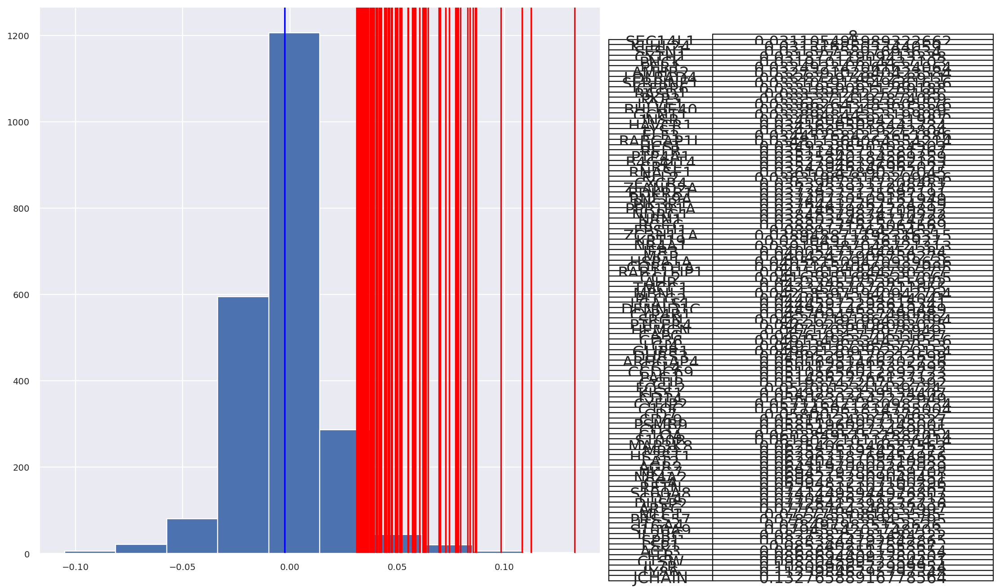

In [40]:
U = np.mean(df_loadings[comps])
std = np.std(df_loadings[comps])
med =  np.median(df_loadings[comps])
mad = np.median(np.absolute(df_loadings[comps] - np.median(df_loadings[comps])))
pvals = scipy.stats.norm.sf(df_loadings[comps], loc=med, scale=2*mad)
#pvals = scipy.stats.norm.sf(df_loadings[comps], loc=U, scale=1*std)
df_loadings[str(comps) +'_pval'] = pvals
plt.hist(df_loadings[comps])
for i in ((df_loadings[comps][df_loadings[str(comps) +'_pval']<0.05]).unique()):
    plt.axvline(x=i,color='red')
plt.axvline(x=med,color='blue')
#plt.axvline(x=med,color='pink')
df_loadings[comps][df_loadings[str(comps) +'_pval']<0.05]
print(len(df_loadings[comps][df_loadings[str(comps) +'_pval']<0.05]))
#Plot precision recall and recall
plot_loading = pd.DataFrame(pd.DataFrame(df_loadings[comps][df_loadings[str(comps) +'_pval']<0.05]).iloc[:,0].sort_values())
table = plt.table(cellText=plot_loading.values,colWidths = [1]*len(plot_loading.columns),
rowLabels=plot_loading.index,
colLabels=plot_loading.columns,
cellLoc = 'center', rowLoc = 'center',
loc='right', bbox=[1.2, -0.05, 0.5,1])
table.scale(1, 2)
table.set_fontsize(16)

In [41]:
# make 3-class dataset for classification
centers = [[-5, 0], [0, 1.5], [5, -1]]
X, y = make_blobs(n_samples=1000, centers=centers, random_state=40)
transformation = [[0.4, 0.2], [-0.4, 1.2]]
X = np.dot(X, transformation)

NameError: name 'make_blobs' is not defined

# Marker gene overlap to rank conserved genes

### Calculate an overlap score between data-deriven marker genes and provided markers 
### Marker gene overlap scores can be quoted as overlap counts, overlap coefficients, or jaccard indices. The method returns a pandas dataframe which can be used to annotate clusters based on marker gene overlaps.

In [ ]:
# Grab marker genes that overlap between top gene loadings in each PCA used for predictions

In [ ]:
scanpy.tl.marker_gene_overlap(adata, reference_markers, *, key='rank_genes_groups', method='overlap_count', normalize=None, top_n_markers=None, adj_pval_threshold=None, key_added='marker_gene_overlap', inplace=False)

# Regress out effect of gene predictions dervied from PCA

In [ ]:
dc_class = ranking_genes[ranking_genes['class'].isin(['DC_YS_main_training'])]

pca = pd.DataFrame(adata.obsm['X_pca'])
regress_ind = list(dc_class['x_pc'].unique())
regress_ind_obs = pca[regress_ind]
regress_ind = ['regress-pc_' + str(s) for s in regress_ind]
regress_ind_obs.columns = regress_ind
adata.obs[regress_ind] = regress_ind_obs.values
adata.obs[regress_ind]
sc.pp.regress_out(adata,keys = regress_ind)

# Below modules will be tuned into functions in package

## Combining data and Preprocess

In [ ]:
%%time
# Check if filepaths are good
if not os.path.exists(save_path):
    os.makedirs(save_path)
    
if (Path(Object1).is_file() & Path(Object2).is_file()):
    print("adata file paths detetcted, proceeding to load")
    adata = sc.read(Object1)
    adata2 =  sc.read(Object2)
    del adata.uns
    del adata2.uns
else: 
    raise TypeError("one or more .h5ad paths cannot be accessed")

# altering scanpy setting so that we can save it to our defined directory
sc._settings.ScanpyConfig(figdir=save_path)

# Combine and pre-process data to match correlations across PCA

# Module to detect shape mismatch and alternatively rebuild adata
if(use_raw==True):
    print('option detected to use raw data, proceeding to check if raw exists and if it matches data.X')
    if (hasattr(adata.raw, "X")):
        try: adata.X =  adata.raw.X  ; print('no mismatch in shape for adata detected')
        except: print("adata.X shape mismatched with adata.raw.X, proceeding to re-build data") ; adata = adata.raw.to_adata()
    else:
        print("no raw data detected in adata! proceeding to create raw partition from adata.X")
        adata.raw = adata
        
    if (hasattr(adata2.raw, "X")):
        try: adata2.X = adata2.raw.X ; print('no mismatch in shape for adata2 detected')
        except: print("adata2.X shape mismatched with adata.raw.X, proceeding to re-build data") ; adata2 = adata2.raw.to_adata()
    else:
        print("no raw data detected in adata! proceeding to create raw partition from adata.X")
        adata2.raw = adata2
            
# Define intersecting genes between datasets
adata_genes = list(adata.var.index)
adata2_genes = list(adata2.var.index)
keep_SC_genes = list(set(adata_genes) & set(adata2_genes))
print("keep gene list = " , len(keep_SC_genes), "adata1 gene length = ", len(adata_genes) , "adata2 gene length = ", len(adata2_genes) )

# Remove non-intersecting genes (this step will remove cite-seq data if training data is pure RNA seq)
adata_intersect1 = adata[:, keep_SC_genes]
adata = adata_intersect1
adata_intersect2 = adata2[:, keep_SC_genes]
adata2 = adata_intersect2

# Optional subsampling of training data to 
if(subsample_train == True):
    
    if not(subsample_prop=="NA"):
        print("option to subsample by proportion chosen")
        prop = subsample_prop
        data = adata.obs[:]
        grouped = data.groupby(cat1)
        df = grouped.apply(lambda x: x.sample(frac=prop))
        df = df.droplevel(cat1)
        keep = df.index
        adata = adata[adata.obs.index.isin(keep)]
    else:
        print("subsample by smallest population")
        data = adata.obs
        data = data.sample(frac=1).groupby(cat1).head(min(adata.obs.groupby(cat1).size()))
        keep = data.index
        adata = adata[adata.obs.index.isin(keep)]
        
# Optional subsampling of training data to 
if(subsample_predict == True):
    if not(subsample_prop_predict=="NA"):
        print("option to subsample by proportion chosen")
        prop = subsample_prop_predict
        data = adata2.obs[:]
        grouped = data.groupby(cat2)
        df = grouped.apply(lambda x: x.sample(frac=prop))
        df = df.droplevel(cat2)
        keep = df.index
        adata2 = adata2[adata2.obs.index.isin(keep)]
    else:
        print("subsample by smallest population")
        data = adata2.obs
        data = data.sample(frac=1).groupby(cat2).head(min(adata.obs.groupby(cat2).size()))
        keep = data.index
        adata2 = adata2[adata2.obs.index.isin(keep)]

# Create a common batch column and do simple sanity check for batch variables
if not((batch_correction == "False") and (len(batch)>1)):
    print("Batch correction option detected, proceeding to format batch variables")
    batch_var = "lr_batch"
    adata.obs["lr_batch"] = adata.obs[batch[0]]
    adata2.obs["lr_batch"] = adata2.obs[batch[1]]
else: raise TypeError("Batch correction option detected but requires at least one categorical for each dataset!")

# Create a common obs column in both datasets containing the data origin tag
common_cat = "corr_concat" 
adata.obs[common_cat] = adata.obs[cat1].astype(str) + data1
adata2.obs[common_cat] = adata2.obs[cat2].astype(str) + data2
adata.obs = adata.obs.astype('category')
adata2.obs = adata2.obs.astype('category')
concat = adata2.concatenate(adata, join='inner',index_unique=None, batch_categories=None)
adata = concat[:]
sc.pp.normalize_per_cell(adata, counts_per_cell_after=1e4)
sc.pp.log1p(adata)
sc.pp.highly_variable_genes(adata, min_mean=0.1, max_mean=4)
sc.pp.scale(adata, zero_center=False, max_value=None, copy=False) #zero_center=True (densifies output)

# Optionally remove genes of known confounding effect from variable list
if not (Path(remove_effect_of_custom_gene_list).is_file()):
    print("Custom gene list option is not selected or path is not readbale, proceeding with no variable removal")
else: 
    print("Custom gene removal list detected, proceeding to remove intersect from variable genes")
    regress_list = pd.read_csv(remove_effect_of_custom_gene_list)
    regress_list = regress_list.iloc[:, 0]
    adata.var["highly_variable"][adata.var.index.isin(regress_list)] = "False"

#Optionally remove genes that do not contribute to variance in combined data::Use only if training and predicting withsim reduced data    
if(remove_non_high_var==True):
    high_var = list(adata.var["highly_variable"][adata.var["highly_variable"]==True])
    adata = adata[:, adata.var["highly_variable"].isin(high_var)]   

# Now compute PCA
sc.pp.pca(adata, n_comps=50, use_highly_variable=True, svd_solver='arpack')

# Batch correction options
# The script will test later which Harmony values we should use
if not(batch_correction == "False"):
    sc.pp.neighbors(adata, n_neighbors=15, n_pcs=50)    
if(batch_correction == "Harmony"):
    print("Commencing harmony")
    # Create hm subset
    adata_hm = adata[:]
    # Set harmony variables
    data_mat = np.array(adata_hm.obsm["X_pca"])
    meta_data = adata_hm.obs
    vars_use = [batch_var]
    # Run Harmony
    ho = hm.run_harmony(data_mat, meta_data, vars_use)
    res = (pd.DataFrame(ho.Z_corr)).T
    res.columns = ['X{}'.format(i + 1) for i in range(res.shape[1])]
    # Insert coordinates back into object
    adata_hm.obsm["X_pca_back"]= adata_hm.obsm["X_pca"][:]
    adata_hm.obsm["X_pca"] = np.array(res)
    # Run neighbours
    sc.pp.neighbors(adata_hm, n_neighbors=15, n_pcs=50)
    adata = adata_hm[:]
    del adata_hm
elif(batch_correction == "BBKNN"):
    print("Commencing BBKNN")
    sc.external.pp.bbknn(adata, batch_key=batch_var, approx=True, metric='angular', copy=False, n_pcs=50, trim=None, n_trees=10, use_faiss=True, set_op_mix_ratio=1.0, local_connectivity=15) 
    
print("adata1 and adata2 are now combined and preprocessed in 'adata' obj - success!")

## Logistic regression function to train data set and transfer labels

/home/jovyan/my-conda-envs/workhorse/lib/python3.8/site-packages/sklearn/linear_model/_sag.py:328: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn("The max_iter was reached which means "
/home/jovyan/my-conda-envs/workhorse/lib/python3.8/site-packages/sklearn/linear_model/_sag.py:328: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn("The max_iter was reached which means "
<ipython-input-39-17e21ab73b23>:68: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead.  To get a de-fragmented frame, use `newframe = frame.copy()`
  adata.obs[col_name] = adata.obs.index


Text(763.0392045454546, 0.5, 'Predicted labels')

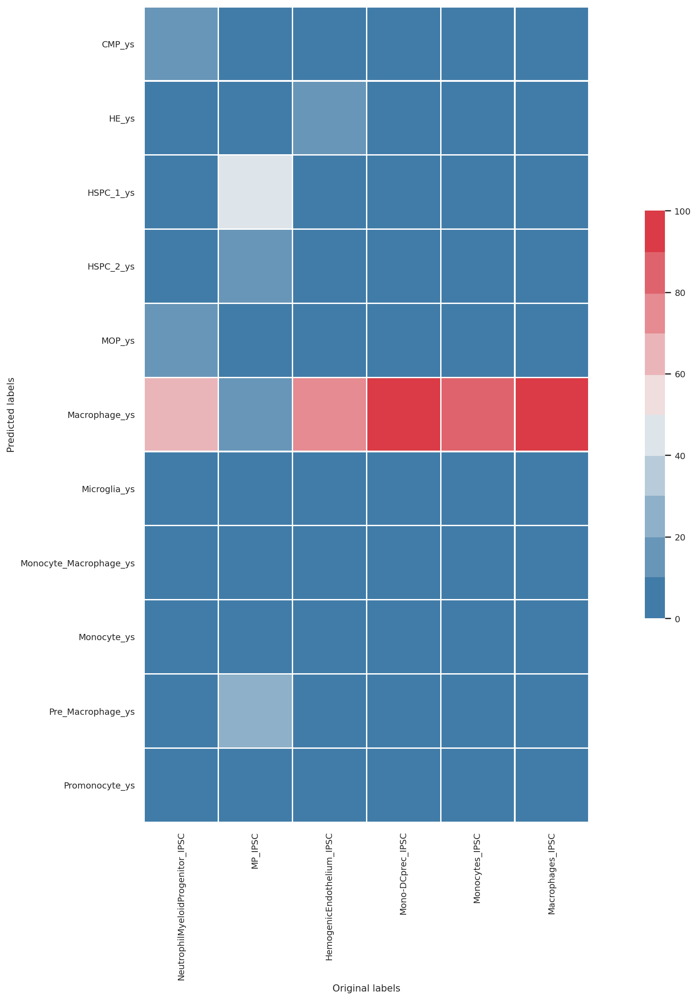

In [39]:
# This function require compute power, will take a while 

def LR_compare(adata, train_x, train_label, subset_predict, subset_train, penalty=penalty, sparcity=sparcity, 
               col_name='predicted'):

    # adata - training+prediction adata object (combined). Pre-processed already
    # sparsity - larger sparsity, more bins, more conservative predictions, less accurate. Low sparist for clean output
                # A value of 0.2 is reasonable for L2 ridge regression
    # penalty - acts as buffer for assigning bins too harshly
    # train_x - arg refers to where you would like to derive your training reference from, i.e., GEX (X) or/elif.
                # PCA/UMAP in obsm. The two 'if' statements below handle train_x differently based on this
                # Based on train_x, the loops below compute 'train_label' (cell type values in training/landscape data) 
                # and 'predict_x'(prediction data equivalent of train_x)
    # train_label - cell type values in training/landscape data
    # subset_predict - mandatory subset of predict_x which contains metadata for expression
    # subset_train - mandatory subset of train_x which contains metadata for expression
    
    # Redefine LR parameters 'penalty' and 'sparsity' if you would like to deviate from defaults set above
    
    # Assign 'lr' as sklearn logistic regression func, with penalty and sparsity defined above
    lr = LogisticRegression(penalty = penalty, C = sparcity, max_iter =  max_iter)
    
    if (penalty == "l1"):
        lr = LogisticRegression(penalty = penalty, C = sparcity, max_iter =  max_iter, dual = True, solver = 'liblinear')
    if (penalty == "elasticnet"):
        lr = LogisticRegression(penalty = penalty, C = sparcity, max_iter =  max_iter, dual=False,solver = 'saga',l1_ratio=l1_ratio)

    if train_x == 'X':
        # Define training parameters
        train_label = adata.obs[common_cat].values
        train_label = train_label[subset_train]
        #train_x = adata.X,
        # Define prediction parameters
        #predict_x = train_x
        #train_x = train_x[subset_train, :] # issue line! subset_train = np.array(adata.obs[common_cat].isin(group1))
                                           # group1 = (adata.obs[common_cat][adata.obs[common_cat].str.contains(Data1_group)]).unique()
                                           # Data1_group = data1 = healthy skin data , adata containing subsetting data to get metadata for expression prediction
                                           # adata.X = adata.X[np.array(adata.obs[common_cat].isin(group1)), :]
                                           # train_x = train_x[adata.obs[common_cat].isin(group1)]
                        
        #predict_x = train_x
        #predict_x = predict_x[subset_predict]
        train_x = adata.X[adata.obs.index.isin(list(adata.obs[subset_train].index))]
        predict_x = adata.X[adata.obs.index.isin(list(adata.obs[subset_predict].index))]

    elif train_x in adata.obsm.keys():
        # Define training parameters
        train_label = adata.obs[common_cat].values
        train_label = train_label[subset_train]
        train_x = adata.obsm[train_x]
        predict_x = train_x
        train_x = train_x[subset_train, :]
        # Define prediction parameters
        predict_x = predict_x[subset_predict]
        predict_x = pd.DataFrame(predict_x)
        predict_x.index = adata.obs[subset_predict].index

    # Train predictive model using user defined partition labels (train_x ,train_label, predict_x)
    model = lr.fit(train_x, train_label)
    lr.fit(train_x, train_label)
    predict = lr.predict_proba(predict_x)

    # Create prediction table and map to adata.obs (in adata.obs["predict"] in the combined object), for the cells that
    # are in predict dataset
    predict = lr.predict(predict_x)
    predict = pd.DataFrame(predict)
    predict.index = adata.obs[subset_predict].index
    adata.obs[col_name] = adata.obs.index
    adata.obs[col_name] = adata.obs[col_name].map(predict[0])

# Function to plot heatmap by percentage
def plot_df_heatmap(df, cmap='viridis', title=None, figsize=(7, 7), rotation=90, save=None, **kwargs):
    fig, ax = plt.subplots(figsize=figsize)
    im = ax.imshow(df, cmap=cmap, aspect='auto', **kwargs)
    if 0 < rotation < 90:
        horizontalalignment = 'right'
    else:
        horizontalalignment = 'center'
    plt.xticks(
        range(len(df.columns)),
        df.columns,
        rotation=rotation,
        horizontalalignment=horizontalalignment,
    )
    plt.yticks(range(len(df.index)), df.index)
    if title:
        fig.suptitle(title)
    #fig.colorbar(im)
    if save:
        plt.savefig(fname=save, bbox_inches='tight', pad_inches=0.1)

# Plot probability table by html
def cross_table(adata, x, y, normalise=None, highlight=False, subset=None):                                                                                                                                                                                              
    """Make a cross table comparing two categorical annotations
    """
    x_attr = adata.obs[x]
    y_attr = adata.obs[y]
    if subset is not None:
        x_attr = x_attr[subset]
        y_attr = y_attr[subset]
    crs_tbl = pd.crosstab(x_attr, y_attr)
    if normalise == 'x':
        x_sizes = x_attr.groupby(x_attr).size().values
        crs_tbl = (crs_tbl.T / x_sizes).round(2).T
    elif normalise == 'y':
        y_sizes = x_attr.groupby(y_attr).size().values
        crs_tbl = (crs_tbl / y_sizes).round(2)
    if highlight:
        return crs_tbl.style.background_gradient(cmap='viridis', axis=0)
    return crs_tbl

# Define the separator category in the column of interest, this works by partial matches and enables a-symmetric 
# comparisons
Data1_group = data1
Data2_group = data2
# Define the common .obs column between concatinated data
common_cat = "corr_concat"

# This block defines subset_predict and subset_train and also runs LR_compare function
group1 = (adata.obs[common_cat][adata.obs[common_cat].str.contains(Data1_group)]).unique()
group1 = list(group1)
group2 = (adata.obs[common_cat][adata.obs[common_cat].str.contains(Data2_group)]).unique()
group2 = list(group2)
subset_predict = np.array(adata.obs[common_cat].isin(group2))
subset_train = np.array(adata.obs[common_cat].isin(group1))
train_label = (adata.obs[common_cat][adata.obs[common_cat].isin(group1)]).values

LR_compare(adata, train_x, train_label, subset_predict, subset_train, sparcity=sparcity, col_name='predicted')

################################################################################################################################################################
#HTML cross-table construction

# Plotting purposes - Subset data to only contain prediction data with new predicted labelså
# Make adata the predicted data with projected annotations in adata.obs["predicted"]. "corr_concat" contains old 
# cell.labels and dataset name combined 
common_cat = "corr_concat"
adata_concat = adata[:]
adata = adata[adata.obs["predicted"].isin(group1)]
adata = adata[adata.obs["corr_concat"].isin(group2)]

# The results, are displayed in a python notebook or rendered as a html (just for quick visualisation, not saving)
# This table represents probability (binary cell type assignment) - numbers represent number of cells
# Columns contain number of original cells from adata2 that are now labelled using the training dataset, adata1
# (as shown on y axis)
crs_tbl = cross_table(adata, x = 'predicted', y = common_cat, highlight = True)
#crs_tbl

################################################################################################################################################################
# Heatmap function

x = 'predicted'
y = common_cat

y_attr = adata.obs[y]
x_attr = adata.obs[x]
crs = pd.crosstab(x_attr, y_attr)
crs_tbl = crs
for col in crs_tbl :
    crs_tbl[col] = crs_tbl[col].div(crs_tbl[col].sum(axis=0)).multiply(100).round(2)
# Sort df columns by rows
crs_tbl = crs_tbl.sort_values(by =list(crs_tbl.index), axis=1,ascending=False)
# Plot_df_heatmap(crs_tbl, cmap='coolwarm', rotation=90, vmin=20, vmax=70)
pal = sns.diverging_palette(240, 10, n=10)
plt.figure(figsize=(20,15))
sns.set(font_scale=0.8)
g = sns.heatmap(crs_tbl, cmap=pal, vmin=0, vmax=100, linewidths=1, center=50, square=True, cbar_kws={"shrink": 0.5})
plt.xlabel("Original labels")
plt.ylabel("Predicted labels")
#plt.savefig(save_path + "/LR_predictions.pdf")
#crs_tbl.to_csv(save_path + "/pre-freq_LR_predictions_supp_table.csv")



### Proportion of cells per group

In [ ]:
prop = adata.obs.groupby('predicted').count()
prop['percentage'] = (prop.iloc[:,6]/prop.iloc[:,6].sum())*100
prop = prop['percentage']
prop.to_csv(save_path + "/pre-freq_predicted_prop.csv")
prop

## Modules to compute Leiden-LR Consensus

## Clustering 

In [ ]:
# Optional clustering 
res = 5
key_add = 'leiden'
adata.obs[key_add] = "nan"
sc.tl.leiden(adata, resolution= res, key_added= key_add, random_state=26, n_iterations=-1)

In [ ]:
cluster_prediction = "clus_prediction"
clusters_reassign = "leiden"
lr_predicted_col = 'predicted'

In [ ]:
adata.obs[cluster_prediction] = adata.obs.index
for z in adata.obs[clusters_reassign].unique():
    df = adata.obs
    df = df[(df[clusters_reassign].isin([z]))]
    df_count = pd.DataFrame(df[lr_predicted_col].value_counts())
    freq_arranged = df_count.index
    cat = freq_arranged[0]
    df.loc[:,cluster_prediction] = cat
    adata.obs.loc[adata.obs[clusters_reassign] == z, [cluster_prediction]] = cat

### Heatmap showing cells in predicted clusters

In [ ]:
# Create a concat col for old + predicted annots
adata.obs['annot_clus_prediction_concat'] = adata.obs[cat1].astype(str) + "_" + adata.obs['clus_prediction'].astype(str)

x='clus_prediction'
y = common_cat

y_attr = adata.obs[y]
x_attr = adata.obs[x]
crs = pd.crosstab(x_attr, y_attr)
crs_tbl = crs
for col in crs_tbl :
    crs_tbl[col] = crs_tbl[col].div(crs_tbl[col].sum(axis=0)).multiply(100).round(2)

#plot_df_heatmap(crs_tbl, cmap='coolwarm', rotation=90, vmin=20, vmax=70)
pal = sns.diverging_palette(240, 10, n=10)
plt.figure(figsize=(20,10))
sns.set(font_scale=0.8)
g = sns.heatmap(crs_tbl, cmap=pal, vmin=0, vmax=100, linewidths=1, center=50, square=True, cbar_kws={"shrink": 0.3})
plt.xlabel("Original labels")
plt.ylabel("Predicted labels")
plt.savefig(save_path + "/LR_predictions_consensus.pdf")
crs_tbl.to_csv(save_path + "/post-freq_LR_predictions_consensus_supp_table.csv")

In [ ]:
prop = adata.obs.groupby('clus_prediction').count()
prop['percentage'] = prop.iloc[:,6]/prop.iloc[:,6].sum()
prop = prop['percentage']
prop.to_csv(save_path + "/post-freq_predicted_leiden_consensus_prop.csv")
prop

In [ ]:
# Generate a umap to view your current data
sc.tl.umap(adata)

def generate_colors(col_required):
    import random
    number_of_colors = col_required
    color = ["#"+''.join([random.choice('0123456789ABCDEF') for j in range(6)])
                 for i in range(number_of_colors)]
    return list(color)

col = generate_colors(len(adata.obs["predicted"].unique()))
sc.pl.umap(adata, color='predicted', palette = col, save = "prediction_umap.pdf")

col = generate_colors(len(adata.obs["clus_prediction"].unique()))
sc.pl.umap(adata, color='clus_prediction', palette = col, save = "clus_prediction_umap.pdf")

In [ ]:
# Are any celltypes removed between prediction and cluster consensus step?
prediction_set = list(adata.obs['predicted'].unique())
clust_prediction_set = list(adata.obs['clus_prediction'].unique())
non_intersect = set(prediction_set) ^ set(clust_prediction_set)
non_intersect = non_intersect.intersection(prediction_set)

if (len(non_intersect)>0):
    print(str(len(non_intersect)) + " labels were omitted during the consensus redistribution step! Please check if these labels are expected to be significantly available in the prediction dataset! Missin labels are::" )
    print("################################")
    print(non_intersect)
    
    # plot umap coloring only labels that were lost in consensus step
    sc.pl.umap(adata,color="predicted",groups=non_intersect, save = "freq_redistribution_omitted_labels_umap.pdf")
else: print("No labels were omitted!")

In [ ]:

# calculate Rand and MI
rand = sklearn.metrics.adjusted_rand_score(list(adata.obs['predicted']), list(adata.obs['clus_prediction']))
mi = sklearn.metrics.adjusted_mutual_info_score(list(adata.obs['predicted']), list(adata.obs['clus_prediction']), 
                                                average_method='arithmetic')

# test concordance between the predicted labels by cell and the consensus clusters
if ((rand<0.8) | (mi<0.8)):
    print("Your concordance between predicted and consensus leiden labels are weak, please attempt reclustering at higher resolution and running consensus again")
    print("Adj Rand extimate = " + str(rand) + "  " + "Mutual Information score=" + str(mi))
else: 
    print("success")
    print("You have achieved good consensus between predicted labels and consensus leiden labels")
    print("Adj Rand extimate = " + str(rand) + "  " + "Mutual Information score=" + str(mi))

In [ ]:
# Note: if low could be due to removed celltypes or may be expected if the cells are quite different such as from different organs, 
# plot cells to check groups and see if group together nicely or all over 

# Save dataframe with new labels 

In [ ]:
df = adata.obs[["predicted", "leiden", "clus_prediction"]]
df = df.rename(columns={"predicted": "pre_freq_clus_prediction", "clus_prediction": "post_freq_clus_prediction"})
df.to_csv(save_path + "/final_lr_metadata_for_adata2.csv")
df